# The Response of Sea Surface Temperature to Rain
Ongoing summary of research/analysis to serve as the skeleton for the eventual publication.



# Body of Analysis

In [1]:
%load_ext autoreload
%autoreload

import numpy as np
import pandas as pd
import xarray as xr
import numpy as np
import datetime as datetime
import glob
import scipy
import tqdm
from matplotlib import pyplot as plt
import matplotlib.dates as mdates
#%matplotlib inline

import matlab.engine

#from scipy.signal import find_peaks
from scipy.io import loadmat

## Section 1: Dynamo

### Import SST_rain and Sensible Heat Flux with Rain from modified COARE run 

In [2]:
#import file as a dictionary of numpy arrays using the scipy loadmat function
SSTr_Leg1 = loadmat('../Data/Level_1/Dynamo/Revelle_FluxData/SST_rainAdjusted_Leg1_r4.mat')
SSTr_Leg2 = loadmat('../Data/Level_1/Dynamo/Revelle_FluxData/SST_rainAdjusted_Leg2_r4.mat')
SSTr_Leg3 = loadmat('../Data/Level_1/Dynamo/Revelle_FluxData/SST_rainAdjusted_Leg3_r4.mat')
SSTr_Leg4 = loadmat('../Data/Level_1/Dynamo/Revelle_FluxData/SST_rainAdjusted_Leg4_r4.mat')

SSTr = np.concatenate((SSTr_Leg1['SSTB'][0,:],
                    SSTr_Leg2['SSTB'][0,:],
                    SSTr_Leg3['SSTB'][0,:],
                    SSTr_Leg4['SSTB'][0,:]))
len(SSTr)

134644

In [3]:
#---------TRYING OUT CORRECTING SKIN TEMP USING BULK TSG MEASUREMENT AS THE STARTING POINT----
#import file as a dictionary of numpy arrays using the scipy loadmat function
#SSTr_Leg1 = loadmat('../Data/Level_1/Dynamo/Revelle_FluxData/SST_rainAdjustedFROMBULK_Leg1_r4.mat')
#SSTr_Leg2 = loadmat('../Data/Level_1/Dynamo/Revelle_FluxData/SST_rainAdjustedFROMBULK_Leg2_r4.mat')
#SSTr_Leg3 = loadmat('../Data/Level_1/Dynamo/Revelle_FluxData/SST_rainAdjustedFROMBULK_Leg3_r4.mat')
#SSTr_Leg4 = loadmat('../Data/Level_1/Dynamo/Revelle_FluxData/SST_rainAdjustedFROMBULK_Leg4_r4.mat')#

#SSTr = np.concatenate((SSTr_Leg1['SSTB2'][0,:],
#                    SSTr_Leg2['SSTB2'][0,:],
#                    SSTr_Leg3['SSTB2'][0,:],
#                    SSTr_Leg4['SSTB2'][0,:]))
#len(SSTr)

In [4]:
#import file as a dictionary of numpy arrays using the scipy loadmat function
SHFr_Leg1 = loadmat('../Data/Level_1/Dynamo/Revelle_FluxData/SHF_rainAdjusted_Leg1_r4.mat')
SHFr_Leg2 = loadmat('../Data/Level_1/Dynamo/Revelle_FluxData/SHF_rainAdjusted_Leg2_r4.mat')
SHFr_Leg3 = loadmat('../Data/Level_1/Dynamo/Revelle_FluxData/SHF_rainAdjusted_Leg3_r4.mat')
SHFr_Leg4 = loadmat('../Data/Level_1/Dynamo/Revelle_FluxData/SHF_rainAdjusted_Leg4_r4.mat')

SHFr = np.concatenate((SHFr_Leg1['SHF_rain'][0,:],
                       SHFr_Leg2['SHF_rain'][0,:],
                       SHFr_Leg3['SHF_rain'][0,:],
                       SHFr_Leg4['SHF_rain'][0,:]))
len(SHFr)

134644

### Rain Detection

Import data from R/V Revelle meteorological sensors, including precipitation:

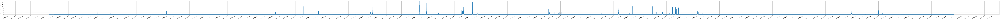

In [5]:
#import rain data
revelle_datapath = '../Data/Level_3/Dynamo/Revelle_FluxData/Revelle_All_Legs_r4.cdf'
rv = xr.open_dataset(revelle_datapath)
rv = rv.assign({'SSTrain': xr.DataArray(SSTr,dims='index',coords={'index':rv.index})})
rv = rv.assign({'SHFrain': xr.DataArray(SHFr,dims='index',coords={'index':rv.index})})

plt.subplots(figsize=(200,3),facecolor='w')
rv.P.plot()
plt.gca().xaxis.set_major_locator(mdates.DayLocator(interval=1))   #to get a tick every day minutes
plt.grid()

(0.0, 200.0)

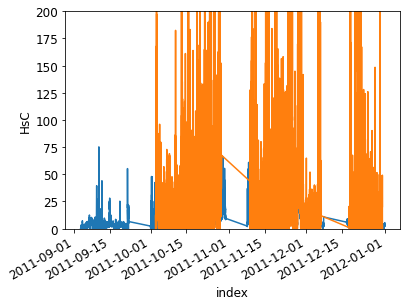

In [55]:
rv.shf.plot()
rv.HsC.plot()
plt.ylim(0,200)

### Import Edson calculated Fluxes 

In [6]:
#import file as a dictionary of numpy arrays using the scipy loadmat function
Edson_raw = loadmat('../Data/Level_1/Dynamo/DC Fluxes From Edson (with closed path)/Transfer_D05.mat')

#drop the metadata keys from the dictionary so that all the remaining arrays are the same size
del Edson_raw['__header__']
del Edson_raw['__version__']
del Edson_raw['__globals__']
del Edson_raw['D']
del Edson_raw['zi']
del Edson_raw['zq']
del Edson_raw['zt']
del Edson_raw['zu']
del Edson_raw['cpa']
del Edson_raw['lstatchk']
del Edson_raw['uklMeas']
del Edson_raw['uklsave']

year = 2011
date = datetime.datetime(year, 1, 1) + pd.to_timedelta(Edson_raw['yday'][0]-1,unit='days')
Edson_Fluxes = pd.DataFrame(index=date)

#iterate over each key in the dict and add to the pandas dataframe as a new column
for key in Edson_raw:
    #print(key)
    Edson_Fluxes[key] = Edson_raw[key][0].tolist()

Edson_Fluxes = Edson_Fluxes.to_xarray()

Plot rain rate & $\delta$SST on top row, wind & fluxes on bottom row on standardized y-axis scales for all events:

## Converting from Edson's Moisture & Sonic Fluxes to Latent & Sensible Heat

**Moisture Flux** is $\overline{w'q'}$ given in units of [m/s][g/g]

$$ H_l = \rho L_E \overline{w'q'} $$

**Sonic Flux** is $\overline{w'T'_{sonic}}$ given in units of [m/s][K] and needs to be corrected for water vapor to get $\overline{w'T'}$ following Dupuis et al. 1997:

$$ H_s = \rho c_p \overline{w'T'} $$

$$ \overline{w'T'} = \frac{\overline{w'T'_{sonic}} - 0.518T\overline{w'q'}}{(1 + 0.518q)} $$


Where $\rho$ is air density [kg/m^3], $c_p = 1.005 + 1.82*q$ [J/g K] is the specific heat for moist air, $L_E = 2260$ [J/g] is the water latent heat of vaporization, $T$ is the air temperature [K], and $q$ is the specific humidity [g/kg].


**However**, we do not have sufficient trust in the moisture flux measurements to use them in calculating sensible heat flux. So instead, we will use the COARE Latent heat flux, divided by $\rho L_E$, to get $\overline{w'q'}$ in our sensible heat flux calculation.

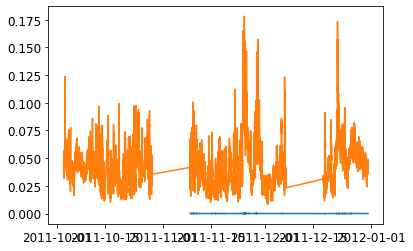

In [36]:
plt.plot(Edson_Fluxes.WQrC)
plt.plot(wq)

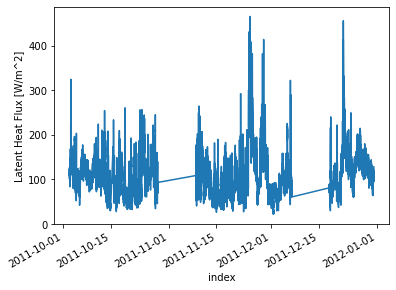

In [7]:
#interpolate coare outputs onto DC timestamps
Edson_Fluxes['Hl_bulk'] = rv.lhf.interp_like(Edson_Fluxes,method='linear')
Edson_Fluxes.Hl_bulk.plot()

(0.0, 1200.0)

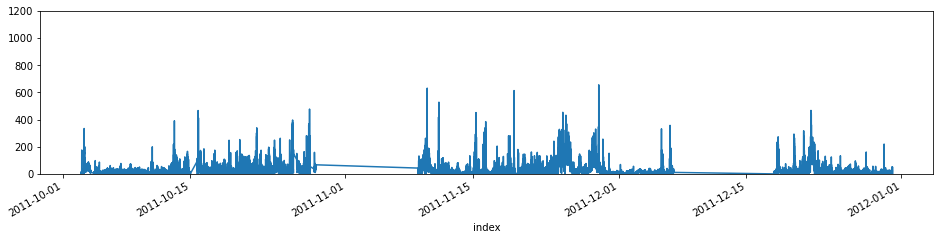

In [8]:
#initialize all variables out of Edson's dataset
ρ = Edson_Fluxes.rhoair #[kg/m^3]
LE = 2260               #[kJ/kg]
q = Edson_Fluxes.Qair   #[g/kg]
T = Edson_Fluxes.Tair + 273.15   #[C] -> [K]
#wq = Edson_Fluxes.WQr   #[m/s g/g]
wTs = Edson_Fluxes.WTr  #[m/s K]

#calculate Latent Heat Flux
#Hl = ρ*LE*wq*1000   # [kg/m^3] [kJ/kg] [m/s g/g]*1000 -> [kJ/m^3][m/s][g/g]*1000 -> [kJ/s/m^2][g/g]*1000 -> [kW/m^2]*1000 -> [W/m^2]

#calculate w'q' from COARE Latent Heat Flux output
wq = Edson_Fluxes.Hl_bulk/ρ/LE/1000

#calculate Sensible Heat Flux
wT = (wTs - 0.518*T*wq) / (1 + 0.518*q)   # ( [m/s K] - [K][m/s][g/g] ) / [g/g] ) -> [m/s][K]
cp = 1.005 + 1.82*q #[J/g K]
Hs = ρ*cp*wT*1000 

#plot
fig,axx = plt.subplots(figsize=(16,3))
#Hl.plot()
Hs.plot()
plt.ylim([0,1200])

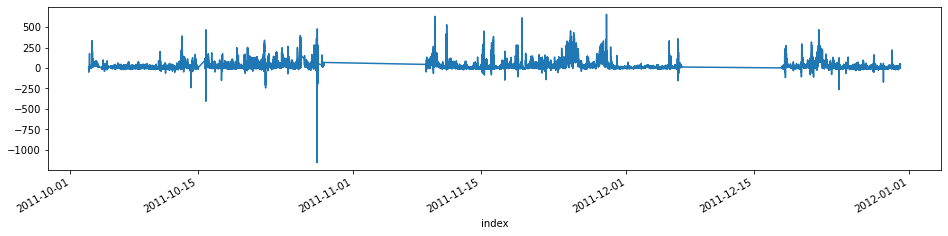

In [9]:
#SAME CALCULATION BUT FOR CLOSED-PATH
ρ = Edson_Fluxes.rhoair #[kg/m^3]
LE = 2260               #[kJ/kg]
q = Edson_Fluxes.Qair   #[g/kg]
T = Edson_Fluxes.Tair + 273.15   #[C] -> [K]
#wq = Edson_Fluxes.WQrC   #[m/s g/g]
wTs = Edson_Fluxes.WTr  #[m/s K]

#calculate Latent Heat Flux
#HlC = ρ*LE*wq*1000   # [kg/m^3] [kJ/kg] [m/s g/g]*1000 -> [kJ/m^3][m/s][g/g]*1000 -> [kJ/s/m^2][g/g]*1000 -> [kW/m^2]*1000 -> [W/m^2]

#calculate w'q' from COARE Latent Heat Flux output
wq = Edson_Fluxes.Hl_bulk/ρ/LE/1000

#calculate Sensible Heat Flux
wT = (wTs - 0.518*T*wq) / (1 + 0.518*q)   # ( [m/s K] - [K][m/s][g/g] ) / [g/g] ) -> [m/s][K]
cp = 1.005 + 1.82*q #[J/g K]
HsC = ρ*cp*wT*1000 

#plot
fig,axx = plt.subplots(figsize=(16,3))
#HlC.plot()
HsC.plot()
#plt.ylim([0,1200])

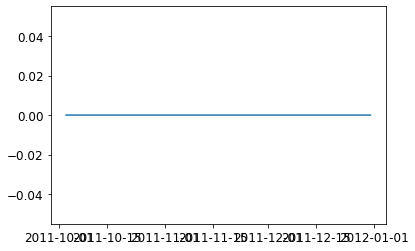

In [40]:
plt.plot(HsC - Hs)

In [10]:
#Edson_Fluxes['Hl'] = Hl
#Edson_Fluxes['Hs'] = Hs
#Edson_Fluxes['HlC'] = HlC
Edson_Fluxes['HsC'] = HsC

In [11]:
#interpolate closed-path fluxes onto revelle dataset
#rv['HlC'] = Edson_Fluxes.HlC.interp_like(rv,method='linear')
rv['HsC'] = Edson_Fluxes.HsC.interp_like(rv,method='linear')

Slice every separate rain event out first (defined as being at least *'min_duration'* long, with a peak rainfall rate of at least *'threshold'*, and surrounded by at least *'min_separation'* minutes of zero precipitation). Then examine the plots of all rain events to tune parameters and identify any that should be removed...

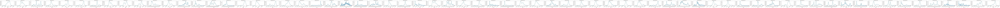

In [12]:
from RainEvent_Toolbox import find_rain_events
rain_event_list = find_rain_events(dataset = rv, 
                                   min_duration = 10,
                                   min_separation = 10,
                                   threshold = 10,
                                   noise_floor = 0.5,
                                   front_pad = 5, 
                                   end_pad = 5)
#plt.savefig('./Figures/Dynamo Rain Event Detection v4.png')

What is the distribution of length of these rain events?

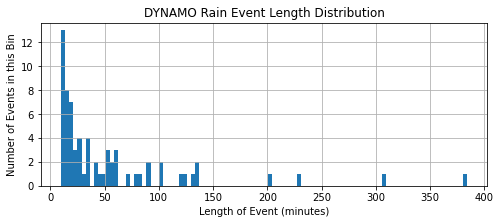

In [12]:
rain_times = []
for event_num in np.arange(0,len(rain_event_list)):
    len_seconds = (rain_event_list[event_num].attrs['Rain End'] - rain_event_list[event_num].attrs['Rain Onset']).item()/1e9/60
    rain_times.append(len_seconds)
    
fig,axx = plt.subplots(facecolor='w',figsize=(8,3))
plt.hist(rain_times,bins=100);

plt.title('DYNAMO Rain Event Length Distribution')
plt.xlabel('Length of Event (minutes)')
plt.ylabel('Number of Events in this Bin')
plt.grid()

Now slice out SST data for each event and calculate relevant parameters:

In [13]:
#import SST data
kt_dynamo = xr.open_dataset('../Data/Level_3/Dynamo/KT15/Dynamo_KT15_CalibratedSST.cdf')
#sort dataset into sequential timesteps
kt_dynamo = kt_dynamo.sortby(kt_dynamo.index)
#resample SST to 10 seconds
kt_1m = kt_dynamo.SST.resample(index='10s').mean()
#how many minutes before rain onset do we want to average as the baseline from which to calculate a delta?
pre_onset_averaging = 3

In [14]:
kt_revelle = kt_1m.interp_like(rv,method='linear')
kt_revelle

<xarray.DataArray 'SST' (index: 134644)>
array([26.626271, 26.702347, 26.67762 , ..., 28.458368, 28.371765, 28.269921])
Coordinates:
  * index    (index) datetime64[ns] 2011-09-03T12:00:00 ... 2012-01-01

In [15]:
kt_revelle.to_pandas().to_csv('KT15 on Revelle timestamps.csv')

C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:1: FutureWarning: The signature of `Series.to_csv` was aligned to that of `DataFrame.to_csv`, and argument 'header' will change its default value from False to True: please pass an explicit value to suppress this warning.
  """Entry point for launching an IPython kernel.


C:\ProgramData\Anaconda3\lib\site-packages\xarray\core\nanops.py:161: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis=axis, dtype=dtype)


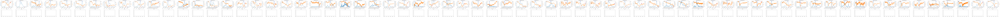

In [14]:
%autoreload
from RainEvent_Toolbox import sst_rain_response
sst_event_list = sst_rain_response(rain_event_list = rain_event_list,
                                   sst = kt_1m,
                                   pre_onset_averaging = pre_onset_averaging)
#plt.savefig('./Figures/Dynamo Rain Events + SST + Fluxes v4.png')

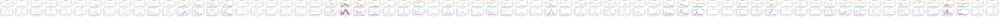

In [17]:
from RainEvent_Toolbox import plot_rain_events
plot_rain_events(rain_event_list = rain_event_list,  
                 sst_event_list = sst_event_list, 
                 rain_ylims = [-1,150],
                 δsst_ylims = [-1,0.5],
                 rhf_ylims = [0,300],
                 wind_ylims = [0,15])
#plt.savefig('./Figures/Dynamo Rain Events + deltaSST + Wind v3.png')

### Comparing Event Characteristics

Plot histograms:

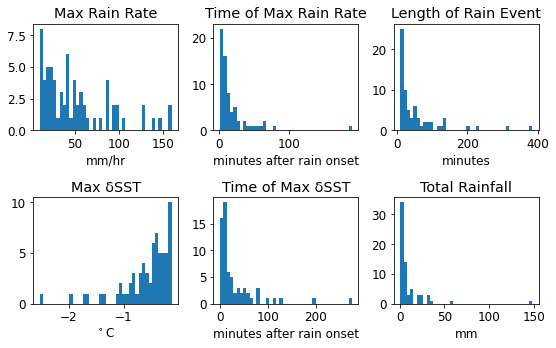

In [196]:
from RainEvent_Toolbox import extract_event_characteristics, plot_histograms
rain_events_summary = extract_event_characteristics(rain_event_list, sst_event_list)
plot_histograms(rain_events_summary, nbins=40)
#plt.savefig('./Figures/Histograms v3.png')

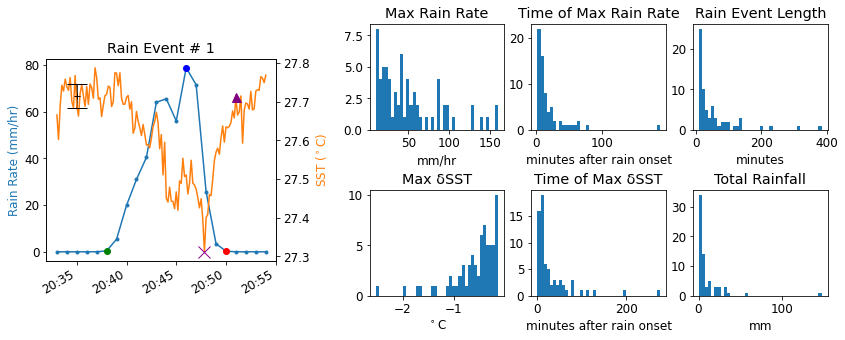

In [250]:
#new plot that combines an example event with the histograms
fig = plt.figure(figsize=(14,5))
ax1 = plt.subplot2grid(shape=(8,20),loc=(1,0),rowspan=6,colspan=6)

#----example event--
event_num = 0
start = pd.to_datetime(rain_event_list[event_num].attrs['Rain Onset'])
end = pd.to_datetime(rain_event_list[event_num].attrs['Rain End'])
first = rain_event_list[event_num].index[0]
last = rain_event_list[event_num].index[-1]
#plot precipitation rate
rain_event_list[event_num].P.plot.line('-o',ax=ax1,markersize=3,fillstyle=None)
ax1.set_ylabel('Rain Rate (mm/hr)',color='C0')
ax1.set_xlabel('')

#plot rainfall start and end times
ax1.plot(start,rain_event_list[event_num].P.sel(index=start),'.g',markersize=12,fillstyle=None)
ax1.plot(end,rain_event_list[event_num].P.sel(index=end),'.r',markersize=12,fillstyle=None)
#plot rainfall peak
ax1.plot(rain_event_list[event_num].attrs['Peak Time'],rain_event_list[event_num].attrs['Peak Rate'],'.b',markersize=12,fillstyle=None)

#plot SST
ax2 = ax1.twinx()
sst_event_list[event_num].sst.plot.line('C1',ax=ax2,fillstyle=None)
ax2.set_ylabel('SST ($^\circ$C)',color='C1')
#plot max δSST and pre-onset mean + std
try:
    ax2.plot(sst_event_list[event_num].attrs['Time of max δsst'],sst_event_list[event_num].sst.sel(index=sst_event_list[event_num].attrs['Time of max δsst']),'x',color='darkmagenta',markersize=12)
    ax2.errorbar(sst_event_list[event_num].attrs['pre-onset time'],sst_event_list[event_num].attrs['pre-onset mean'],yerr=sst_event_list[event_num].attrs['pre-onset std'],fmt='+k',ecolor='k',capsize=10)
except KeyError:
    None

try:
    ax2.plot(sst_event_list[event_num].attrs['Time of sst recovery'],sst_event_list[event_num].sst.sel(index=sst_event_list[event_num].attrs['Time of sst recovery']),'^',color='purple',markersize=9)
except KeyError:
    None

#title
ax1.set_title(f'Rain Event # {event_num+1}')
ax1.xaxis.set_major_formatter(mdates.DateFormatter('%H:%M'))

#----histograms----
nbins=40
ax3 = plt.subplot2grid(shape=(10,5),loc=(0,2),rowspan=4,colspan=1)
ax4 = plt.subplot2grid(shape=(10,5),loc=(0,3),rowspan=4,colspan=1)
ax5 = plt.subplot2grid(shape=(10,5),loc=(0,4),rowspan=4,colspan=1)
ax6 = plt.subplot2grid(shape=(10,5),loc=(6,2),rowspan=4,colspan=1)
ax7 = plt.subplot2grid(shape=(10,5),loc=(6,3),rowspan=4,colspan=1)
ax8 = plt.subplot2grid(shape=(10,5),loc=(6,4),rowspan=4,colspan=1)

rain_events_summary.rain_max.plot.hist(ax=ax3,bins=nbins);
ax3.set_title('Max Rain Rate')
ax3.set_xlabel('mm/hr')

rain_events_summary.t_rain_max.plot.hist(ax=ax4,bins=nbins);
ax4.set_title('Time of Max Rain Rate')
ax4.set_xlabel('minutes after rain onset')

rain_events_summary.L_rain.plot.hist(ax=ax5,bins=nbins);
ax5.set_title('Rain Event Length')
ax5.set_xlabel('minutes')

rain_events_summary.δsst_max.plot.hist(ax=ax6,bins=nbins);
ax6.set_title('Max δSST')
ax6.set_xlabel('$^\circ$C')

rain_events_summary.t_δsst_max.plot.hist(ax=ax7,bins=nbins);
ax7.set_title('Time of Max δSST')
ax7.set_xlabel('minutes after rain onset')

rain_events_summary.rain_total.plot.hist(ax=ax8,bins=nbins)
ax8.set_title('Total Rainfall')
ax8.set_xlabel('mm')

#plt.tight_layout()
#plt.subplots_adjust(wspace=0.2)
plt.savefig('./Figures/Example Event + Histograms v1.png',dpi=300)


### Maybe add a timeseries of the rain events / rain rates over the study period. (Could also annotate with the MJO phases at that time)

Plot relationships between variables:

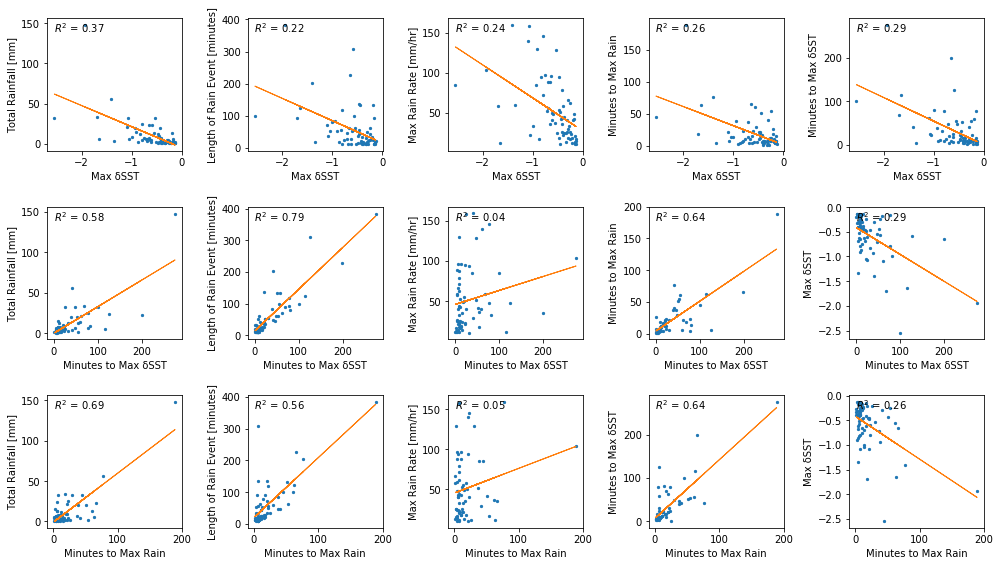

In [9]:
from RainEvent_Toolbox import plot_relationships
plot_relationships(rain_events_summary)
#plt.savefig('./Figures/Scatterplots v3.png')

The three highest correlations are between:
- Minutes to Max $\delta$SST vs. Length of Rain Event ($R^2$ = 0.79)
- Minutes to Max Rain vs. Total Rainfall ($R^2$ = 0.69)
- Minutes to Max Rain vs. Minutes to Max $\delta$SST ($R^2$ = 0.64)

- Should we use a criteria like "95% of total rainfall equally distributed around the peak rain rate" to classify more relevant start and end times for the events? Maybe, but it adds a layer of abstraction
- Try "average rain rate" (total rainfall/length of rain event) - add to the scatter plots
- could then compare that to max rain rate to see how much of the event is "low"/long tails

### Composite Rain Event

First we want to calculate the deltas for any variables we might be interested in from the rain events ($\delta$SST was already calculated):

In [15]:
#define the relevant paramters you would like to calculate a delta for (in addition to SST)
param_list = ['Tsea','TseaTSG','SalTSG','T02','T10','U10','Precip','rhf','SST','SSTrain']

In [16]:
#because the extract_composite_event function is looking for a variable of the form δ{"name"}, we're fudging HlC and HsC by naming them with a delta in front of them when we first add them to the dataset. Kind of clunky but just to try it out.
param_list_2 = ['Tsea','TseaTSG','SalTSG','T02','T10','U10','Precip','rhf','SST','SSTrain','HsC','lhf','shf','Q02','wspd']

## Outliers-included version:

In [17]:
from RainEvent_Toolbox import calculate_deltas
rain_event_list = calculate_deltas(rain_event_list = rain_event_list,
                                   param_list = param_list_2,
                                   pre_onset_averaging = pre_onset_averaging)

C:\ProgramData\Anaconda3\lib\site-packages\xarray\core\nanops.py:161: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis=axis, dtype=dtype)


Now we're ready to put together a composite plot of these delta variables for all rain events. The key is to normalize the timescale by the time to peak SST response, i.e. 
$$ Normalized Time = \frac{(CurrentMinute - StartMinute)}{(Minutes to Max \delta SST)} $$

This way, the rain start is at zero and the peak SST response is at 1. This allows us to superimpose all the rain events in a meaningful way. I've also scaled the size of the dots to indicate what proportion of events were involved in each bin (all events are included between timesteps 0 and 1, of course).

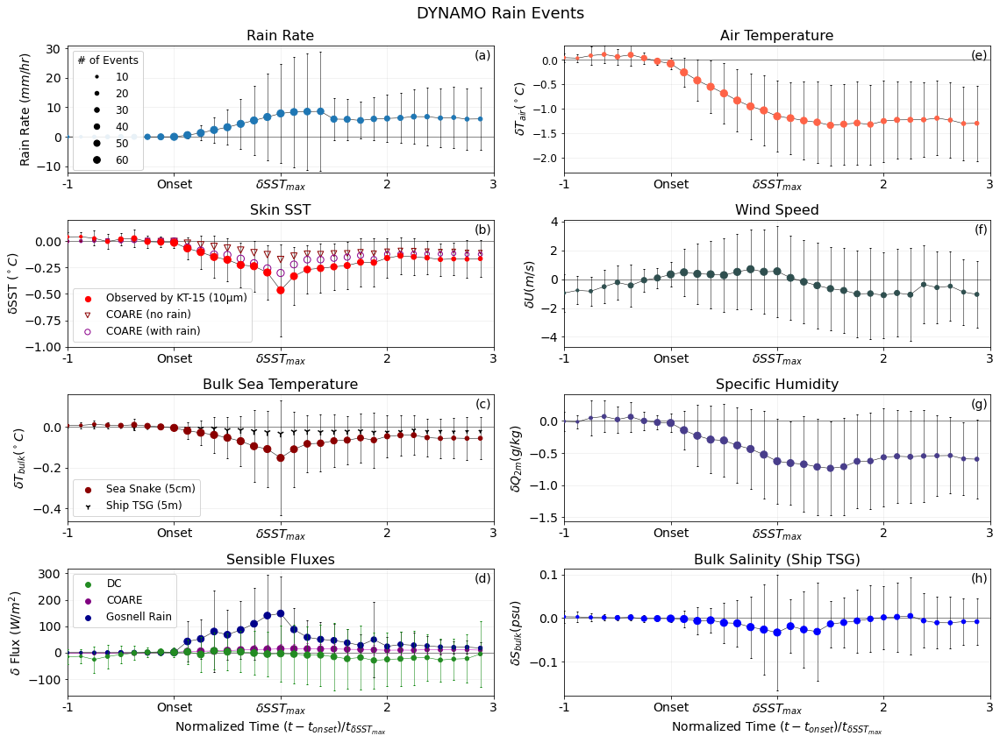

In [24]:
plt.rcParams['font.size'] = 12
%autoreload
from RainEvent_Toolbox import extract_composite_event
composite_event = extract_composite_event(rain_event_list = rain_event_list, 
                                          sst_event_list = sst_event_list, 
                                          param_list = param_list_2, 
                                          start = -1, 
                                          stop = 3, 
                                          spacing = 1/8,
                                          plotflag = 1,
                                          title = 'DYNAMO Rain Events')
#plt.savefig('./Figures/Composite Events with DC Closed-Path Fluxes v19 - COARE no Gosnell no DC for Presentation.png', dpi=300)

# Save Rain Event List, SST Event List, and Composite Event for Data Upload

In [84]:
for event_num in tqdm.tqdm(np.arange(1,len(rain_event_list)+1)):
    rain_event = rain_event_list[event_num-1]
    rain_event.HsC.attrs['long_name'] = 'Direct-Covariance Sensible Heat Flux'
    rain_event.HsC.attrs['units'] = 'W/m^2'
    rain_event.SSTrain.attrs['long_name'] = 'COARE-predicted SST accounting for Gosnell Rain Heat Flux'
    rain_event.SSTrain.attrs['units'] = 'C'
    rain_event.SHFrain.attrs['long_name'] = 'Gosnell Rain Sensible Heat Flux'
    rain_event.SHFrain.attrs['units'] = 'W/m^2'
    rain_event.attrs['Rain Onset'] = rain_event.attrs['Rain Onset'].astype(str)
    rain_event.attrs['Rain End'] = rain_event.attrs['Rain End'].astype(str)
    rain_event.attrs['Peak Time'] = rain_event.attrs['Peak Time'].astype(str)
    rain_event.attrs['pre-onset time'] = str(rain_event.attrs['pre-onset time'])
    rain_event.to_netcdf(f'../Data/Final Data Package/Individual Rain Events/rain_event_{str(event_num).zfill(2)}.nc')
    
    sst_event = sst_event_list[event_num-1]
    sst_event.sst.attrs['long_name'] = 'Skin SST from Infrared Radiometer'
    sst_event.sst.attrs['units'] = 'C'
    sst_event.attrs['pre-onset time'] = str(sst_event.attrs['pre-onset time'])
    sst_event.attrs['Time of max δsst'] = sst_event.attrs['Time of max δsst'].astype(str)
    sst_event.attrs['Time of sst recovery'] = sst_event.attrs['Time of sst recovery'].astype(str)
    sst_event.to_netcdf(f'../Data/Final Data Package/Individual Rain Events/SST for Individual Rain Events/sst_event_{str(event_num).zfill(2)}.nc')

100%|██████████████████████████████████████████████████████████████████████████████████| 68/68 [00:05<00:00, 11.60it/s]


In [43]:
composite_event.to_netcdf('../Data/Final Data Package/Events on Normalized Timescale/composite_rain_events.nc')

In [82]:
sst_event.sst.attrs['long_name'] = 'Skin SST from Infrared Radiometer'
sst_event.sst.attrs['units'] = 'C'

OrderedDict()

In [64]:
rain_event.HsC.attrs['long_name'] = 'Direct-Covariance Sensible Heat Flux'
rain_event.HsC.attrs['units'] = 'W/m^2'

rain_event.SSTrain.attrs['long_name'] = 'COARE-predicted SST accounting for Gosnell Rain Heat Flux'
rain_event.SSTrain.attrs['units'] = 'C'

rain_event.SHFrain.attrs['long_name'] = 'Gosnell Rain Sensible Heat Flux'
rain_event.SHFrain.attrs['units'] = 'W/m^2'

OrderedDict([('pre-onset mean', 44.783179557900375),
             ('pre-onset std', 4.625200074242288)])

In [83]:
composite_event

<xarray.Dataset>
Dimensions:   (event: 68, index: 32)
Coordinates:
  * index     (index) float64 -1.0 -0.875 -0.75 -0.625 ... 2.5 2.625 2.75 2.875
  * event     (event) int32 1 2 3 4 5 6 7 8 9 10 ... 60 61 62 63 64 65 66 67 68
Data variables:
    δsst      (event, index) float64 nan nan nan nan 0.02665 ... nan nan nan nan
    δTsea     (event, index) float64 nan nan nan nan ... nan nan nan nan
    δTseaTSG  (event, index) float64 nan nan nan nan ... nan nan nan nan
    δSalTSG   (event, index) float64 nan nan nan nan -0.0004 ... nan nan nan nan
    δT02      (event, index) float64 nan nan nan nan 0.1393 ... nan nan nan nan
    δT10      (event, index) float64 nan nan nan nan 0.1423 ... nan nan nan nan
    δU10      (event, index) float64 nan nan nan nan 1.448 ... nan nan nan nan
    δPrecip   (event, index) float64 nan nan nan nan ... nan nan nan nan
    δrhf      (event, index) float64 nan nan nan nan -0.5227 ... nan nan nan nan
    δSST      (event, index) float64 nan nan nan nan 0.0

## Outliers-Excluded Version

In [57]:
#loop through events and make a new version of the lists that excludes the outliers
max_thresh = 75 #events with max rain rates above this value will be excluded

rain_events_noOutliers = []
sst_events_noOutliers = []

for i in np.arange(0,len(rain_event_list)):
    if rain_event_list[i].attrs['Peak Rate'] < max_thresh:
        rain_events_noOutliers.append(rain_event_list[i])
        sst_events_noOutliers.append(sst_event_list[i])
        
len(sst_event_list), len(sst_events_noOutliers)

(68, 52)

In [20]:
from RainEvent_Toolbox import calculate_deltas
rain_events_noOutliers = calculate_deltas(rain_event_list = rain_events_noOutliers,
                                           param_list = param_list_2,
                                           pre_onset_averaging = pre_onset_averaging)

NameError: name 'rain_events_noOutliers' is not defined

Now we're ready to put together a composite plot of these delta variables for all rain events. The key is to normalize the timescale by the time to peak SST response, i.e. 
$$ Normalized Time = \frac{(CurrentMinute - StartMinute)}{(Minutes to Max \delta SST)} $$

This way, the rain start is at zero and the peak SST response is at 1. This allows us to superimpose all the rain events in a meaningful way. I've also scaled the size of the dots to indicate what proportion of events were involved in each bin (all events are included between timesteps 0 and 1, of course).

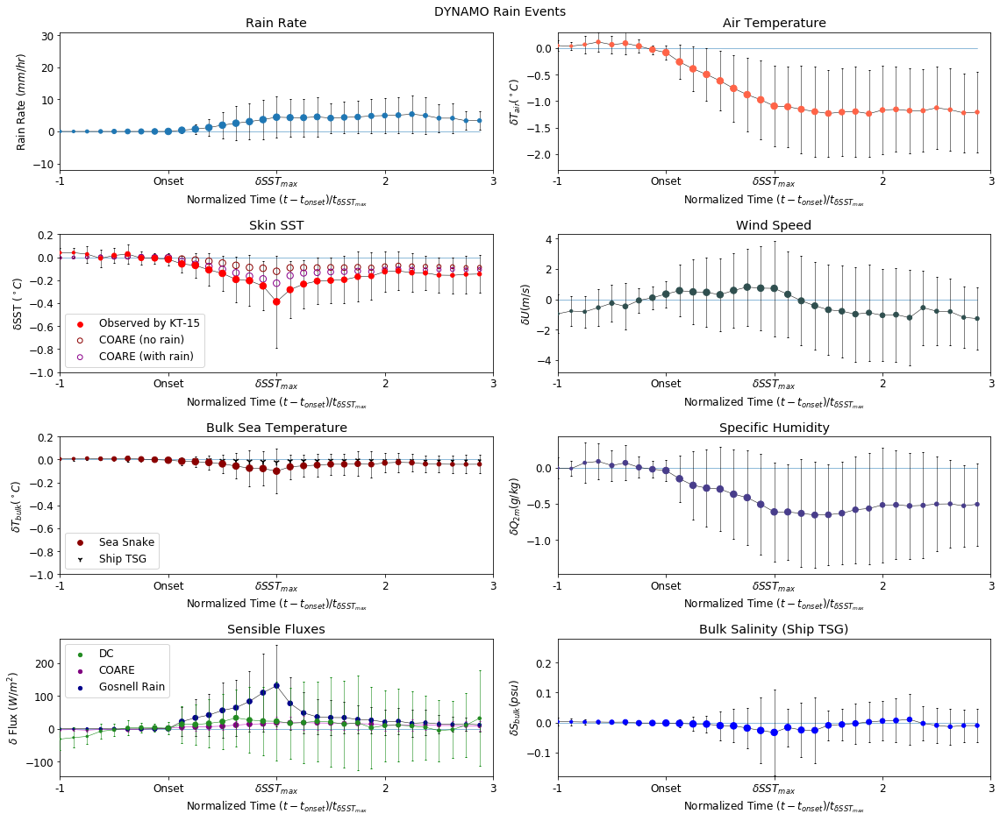

In [56]:
plt.rcParams['font.size'] = 12
%autoreload
from RainEvent_Toolbox import extract_composite_event
composite_event = extract_composite_event(rain_event_list = rain_events_noOutliers, 
                                          sst_event_list = sst_events_noOutliers, 
                                          param_list = param_list_2, 
                                          start = -1, 
                                          stop = 3, 
                                          spacing = 1/8,
                                          plotflag = 1,
                                          title = 'DYNAMO Rain Events')
#plt.savefig('./Figures/Composite Events with DC Closed-Path Fluxes v13.png')

Text(0.5, 1.0, 'Rain Rate vs. δsst for raw (blue) and composite (orange) data')

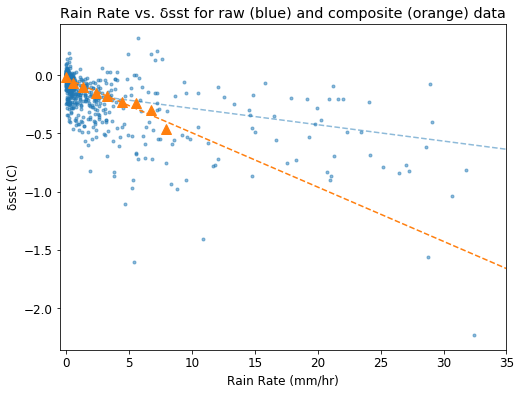

In [22]:
fig,axx = plt.subplots(facecolor='w', figsize=(8,6))

compStart, compEnd = 0, 1
#plot raw data
precip_raw = []
δsst_raw = []
for event_num in np.arange(1,len(composite_event.event)+1):
    data = composite_event.sel(index=slice(compStart, compEnd)).sel(event=event_num)
    precip_raw.extend(data.δPrecip.values.tolist())
    δsst_raw.extend(data.δsst.values.tolist())
    h1 = axx.plot(data.δPrecip,data.δsst,'.',color='C0', alpha=0.5)

#plot regression to raw data
nanMask = np.isnan(δsst_raw)

slope1, intercept1, r_value1, p_value1, std_err1 = scipy.stats.linregress(np.array(precip_raw)[~nanMask], np.array(δsst_raw)[~nanMask])
precip_array = np.arange(0,40)
axx.plot(precip_array, precip_array*slope1 + intercept1, 'C0', zorder=0, linestyle='--', alpha=0.5)

#plot means across events
δsst_mean = composite_event.sel(index=slice(compStart, compEnd)).δsst.mean(dim='event',skipna=True)
δsst_std = composite_event.sel(index=slice(compStart, compEnd)).δsst.std(dim='event',skipna=True)
precip_mean = composite_event.sel(index=slice(compStart, compEnd)).δPrecip.mean(dim='event',skipna=True)
precip_std = composite_event.sel(index=slice(compStart, compEnd)).δPrecip.std(dim='event',skipna=True)
h2 = axx.plot(precip_mean, δsst_mean,'^', color='C1',markersize=10, zorder=10)

#plot regression to means
slope, intercept, r_value, p_value, std_err = scipy.stats.linregress(precip_mean, δsst_mean)
precip_array = np.arange(0,40)
axx.plot(precip_array, precip_array*slope + intercept, 'C1', zorder=20, linestyle='--')
#axx.annotate('$R^2$ = %0.2f' % r_value**2, xy=(0.75, 0.89), xycoords='axes fraction')

axx.set_xlim([-0.5,35])
axx.set_ylabel('δsst (C)')
axx.set_xlabel('Rain Rate (mm/hr)')
axx.set_title('Rain Rate vs. δsst for raw (blue) and composite (orange) data')

In [25]:
slope, intercept, r_value**2, p_value

(-0.04665486429413697,
 -0.02791577076626381,
 0.9322073626696378,
 2.425824786680348e-05)

#### Edson call 11/3/21

(starting point) Rainfall = ocean cooling = "sensible heat out of the ocean" (something of a construct) + reduction in turbulent sensible flux

Could we convert the Gosen construct to a "delta-T" of cool freshwater entering the ocean?  Say air-sea temp diff is 2 degrees - rain will reduce that by a few 10ths of a degree, can we back that out using:

dT/dt ~ 1/(penetration depth of rain) * rain flux

Linking rain-induced sensible heat flux to how the ocean reacts to it

Is the COARE loop reaching a steady state with our modification in it? They (Jim+Fairall) just prescribed 6 iterations because it was always converging so quickly, but now that we've modified the loop would be good to make sure it's still converging. Maybe say when ustar changes by less than 1% between iterations, you're done.

Latent fluxes - take those off and replace with salinity in the final figure. Don't have confidence in them from closed-path.

Then start writing!!!!

__

Carol Anne conversation - she's interested in incorporating this into her high-resolution mixed layer model

Zappa's 2009 paper on rain-induced mixing. Instead she has an estimate of rain-induced momentum flux in her model, which does then enhance the dissipation rate. Rain rate * wind speed * some factor => momentum flux.

At verrry high vertical resolution, she sees freshwater on surface and enhancement of mixing.

Does P-E to change salinity of the surface, but uses Gosnell to do sensible heat flux, and doesn't recalculate fluxes after model has come up with SST (which is basically what COARE does).

________________

What could the rain sensible heat flux term be missing? 
- assumption that the rain is at wet bulb temp when actually it's slightly colder
- under-estimation of rain sensible heat flux for another reason
- OR is it something in the skin temperature correction that is being poorly accounted for in the presence of a cold fresh layer?

We want to be able to provide some thoughts on this in our discussion

Would be very useful to see delta-Q and wind speed on this plot to make it 8-panel. Also cut it off at timestep 3.5.

Panels: 
- Left Side is Air Temp, Skin SST, Bulk SST, Sensible
- Right Side is Rain Rate, Wind Speed, Delta-Q, Latent
(add Salinity to Bulk SST panel? Or it replaces Latent if we decide Latent from closed-path is a red herring)

Slight DC increase compared to COARE perhaps due to the change in SST driven by rain leads to a modification of the turbulent heat fluxes?

How much does the coare modification affect the interfacial flux?

**Read Peter Webster's original rain-induced heat flux paper**

Edson says Dalton number was definitely lower during rain events

____

Running COARE with KT15 SST instead of sea snake - do you see a signal in turbulent sensible flux of the surface cooling effect of rain? And also does running COARE with bulk temp instead of sea snake lead to better estimation of true surface temperature during rain events?

Difference between measured skin temp and COARE calculated skin temp could be due to the assumption that the raindrops are at the wet bulb temperature - if they're a bit colder, then rain heat flux will be underestimated. Gosnell 1995 (original reference for rain heat flux calculation) says max difference between raindrop temp and wet bulb temp is 0.2K - we are well within that range.


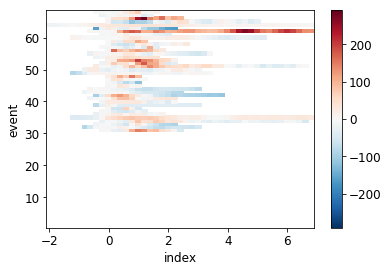

In [20]:
composite_event.δlhf.where(~np.isnan(composite_event.δHlC)).plot()

## **NEXT** Separate by 7 m/s wind threshold from Volkov 2019
Dong 2016 also suggests a ~6m/s threshold - worth investigating how different cutoffs affect these plots - is it actually quite a clear relationship for low-wind situations? When do you get the biggest fluxes?

In [66]:
#generate plot of threshold vs. max delta-sst for above and below cases
δsst_means_above = []
δsst_means_below = []
δsst_stds_above = []
δsst_stds_below = []
δTsea_means_above = []
δTsea_means_below = []
δTsea_stds_above = []
δTsea_stds_below = []
sizes_above = []
sizes_below = []
thresholds = np.arange(2,17)

for threshold in tqdm.tqdm(thresholds):
    rain_above, rain_below = [], []
    sst_above, sst_below = [], []

    #loop through each event and sort events into "above" and "below" lists based on mean wind speed between rain onset and max δsst
    for rain,sst in zip(rain_event_list,sst_event_list):
        start = pd.to_datetime(rain.attrs['Rain Onset'])
        sst_max = pd.to_datetime(sst.attrs['Time of max δsst'])
        wind_mean = rain.U10.sel(index=slice(start,sst_max)).mean().item()

        if wind_mean > threshold:
            rain_above.append(rain)
            sst_above.append(sst)
        else:
            rain_below.append(rain)
            sst_below.append(sst)

    composite_above = extract_composite_event(rain_event_list = rain_above, 
                                              sst_event_list = sst_above, 
                                              param_list = param_list_2, 
                                              start = -2, 
                                              stop = 7, 
                                              spacing = 0.2,
                                              plotflag = 0,
                                              title = '')
    composite_below = extract_composite_event(rain_event_list = rain_below, 
                                              sst_event_list = sst_below, 
                                              param_list = param_list_2, 
                                              start = -2, 
                                              stop = 7, 
                                              spacing = 0.2,
                                              plotflag = 0,
                                              title = '')
    #calculate mean and std of composite event at maximum δsst
    δsst_mean_above = composite_above.δsst.mean(dim='event',skipna=True).sel(index=1).item()
    δsst_mean_below = composite_below.δsst.mean(dim='event',skipna=True).sel(index=1).item()
    δsst_std_above = composite_above.δsst.std(dim='event',skipna=True).sel(index=1).item()
    δsst_std_below = composite_below.δsst.std(dim='event',skipna=True).sel(index=1).item()
    
    δsst_means_above.append(δsst_mean_above)
    δsst_means_below.append(δsst_mean_below)
    δsst_stds_above.append(δsst_std_above)
    δsst_stds_below.append(δsst_std_below)
    
    #calculate mean and std of composite event at maximum δTsea
    δTsea_mean_above = composite_above.δTsea.mean(dim='event',skipna=True).sel(index=1).item()
    δTsea_mean_below = composite_below.δTsea.mean(dim='event',skipna=True).sel(index=1).item()
    δTsea_std_above = composite_above.δTsea.std(dim='event',skipna=True).sel(index=1).item()
    δTsea_std_below = composite_below.δTsea.std(dim='event',skipna=True).sel(index=1).item()
    
    δTsea_means_above.append(δTsea_mean_above)
    δTsea_means_below.append(δTsea_mean_below)
    δTsea_stds_above.append(δTsea_std_above)
    δTsea_stds_below.append(δTsea_std_below)
    
    #calculate how many entries are involved with each event to scale dot sizes
    entries_above = composite_above.δsst.sel(index=1).count().values.item()
    entries_below = composite_below.δsst.sel(index=1).count().values.item()
    
    sizes_above.append(entries_above)
    sizes_below.append(entries_below)


  0%|                                                                                           | 0/15 [00:00<?, ?it/s]C:\ProgramData\Anaconda3\lib\site-packages\xarray\core\nanops.py:161: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis=axis, dtype=dtype)
100%|██████████████████████████████████████████████████████████████████████████████████| 15/15 [02:04<00:00,  8.12s/it]


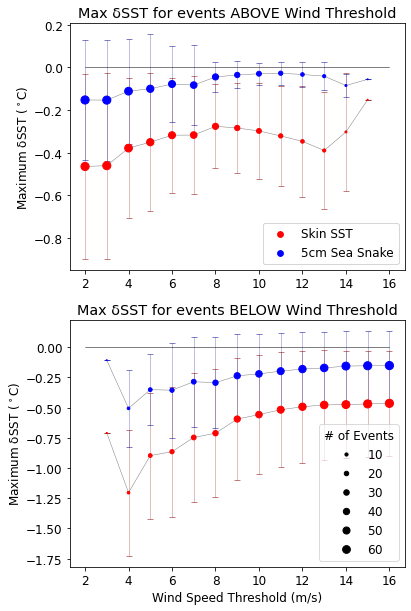

In [87]:
capsz = 3

fig,axx = plt.subplots(nrows = 2, figsize=(6,10))

axx[0].errorbar(x=thresholds, y=δsst_means_above, yerr=δsst_stds_above, fmt='-k', ecolor='darkred', linewidth=0.5, capsize=capsz, zorder=100, alpha = 0.5)
h1 = axx[0].scatter(x=thresholds, y=δsst_means_above, s=sizes_above, c='red',zorder=200)

axx[0].errorbar(x=thresholds, y=δTsea_means_above, yerr=δTsea_stds_above, fmt='-k', ecolor='darkblue', linewidth=0.5, capsize=capsz, zorder=100,alpha = 0.5)
h2 = axx[0].scatter(x=thresholds, y=δTsea_means_above, s=sizes_above, c='blue',zorder=200)

axx[0].plot(thresholds,np.zeros(len(thresholds)),color='k',linewidth = 0.5,zorder=1000)

axx[0].legend([h1,h2],['Skin SST','5cm Sea Snake'])
axx[0].set_title('Max δSST for events ABOVE Wind Threshold')

#axx[0].set_xlabel('Wind Speed Threshold (m/s)')
axx[0].set_ylabel('Maximum δSST ($^\circ$C)')



axx[1].errorbar(x=thresholds, y=δsst_means_below, yerr=δsst_stds_below, fmt='-k', ecolor='darkred', linewidth=0.5, capsize=capsz, zorder=100, alpha = 0.5)
h3 = axx[1].scatter(x=thresholds, y=δsst_means_below, s=sizes_below, c='red',zorder=200)

axx[1].errorbar(x=thresholds, y=δTsea_means_below, yerr=δTsea_stds_below, fmt='-k', ecolor='darkblue', linewidth=0.5, capsize=capsz, zorder=100,alpha = 0.5)
h4 = axx[1].scatter(x=thresholds, y=δTsea_means_below, s=sizes_below, c='blue',zorder=200)

axx[1].plot(thresholds,np.zeros(len(thresholds)),color='k',linewidth = 0.5,zorder=1000)

axx[1].legend([h1,h2],['Skin SST','5cm Sea Snake'])
axx[1].legend(*h4.legend_elements("sizes", num=6),title='# of Events',loc='lower right', framealpha=0.7).set_zorder(1000)



axx[1].set_title('Max δSST for events BELOW Wind Threshold')

axx[1].set_xlabel('Wind Speed Threshold (m/s)')
axx[1].set_ylabel('Maximum δSST ($^\circ$C)')

plt.savefig('./Figures/Wind Threshold vs Max SST v2.png', dpi=300)

## Changing to Binned by Wind Speed - more informative

In [20]:
#generate plot of wind speed bin vs. max delta-sst
δsst_means = []
δsst_stds = []
δTsea_means = []
δTsea_stds = []
sizes = []
wind_bins = np.arange(2,17)

for wind_bin in tqdm.tqdm(wind_bins):
    rain_bin = []
    sst_bin = []

    #loop through each event and determine whether it belongs in this bin
    for rain,sst in zip(rain_event_list,sst_event_list):
        start = pd.to_datetime(rain.attrs['Rain Onset'])
        sst_max = pd.to_datetime(sst.attrs['Time of max δsst'])
        wind_mean = rain.U10.sel(index=slice(start,sst_max)).mean().item()

        if (wind_mean>wind_bin-0.5 and wind_mean<=wind_bin+0.5):
            rain_bin.append(rain)
            sst_bin.append(sst)

    composite_bin = extract_composite_event(rain_event_list = rain_bin, 
                                              sst_event_list = sst_bin, 
                                              param_list = param_list_2, 
                                              start = -2, 
                                              stop = 7, 
                                              spacing = 0.2,
                                              plotflag = 0,
                                              title = '')

    #calculate mean and std of composite event at maximum δsst
    δsst_mean_bin = composite_bin.δsst.mean(dim='event',skipna=True).sel(index=1).item()
    δsst_std_bin = composite_bin.δsst.std(dim='event',skipna=True).sel(index=1).item()
    
    δsst_means.append(δsst_mean_bin)
    δsst_stds.append(δsst_std_bin)
    
    #calculate mean and std of composite event at maximum δTsea
    δTsea_mean_bin = composite_bin.δTsea.mean(dim='event',skipna=True).sel(index=1).item()
    δTsea_std_bin = composite_bin.δTsea.std(dim='event',skipna=True).sel(index=1).item()
    
    δTsea_means.append(δTsea_mean_bin)
    δTsea_stds.append(δTsea_std_bin)
    
    #calculate how many entries are involved with each event to scale dot sizes
    entries = composite_bin.δsst.sel(index=1).count().values.item()
    
    sizes.append(entries*10)


  0%|                                                                                           | 0/15 [00:00<?, ?it/s]C:\ProgramData\Anaconda3\lib\site-packages\xarray\core\nanops.py:161: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis=axis, dtype=dtype)
100%|██████████████████████████████████████████████████████████████████████████████████| 15/15 [00:09<00:00,  2.13it/s]


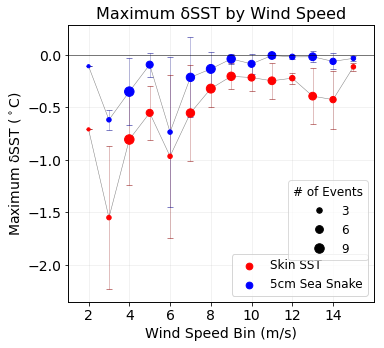

In [21]:
panel_font = 14
title_font = 16
capsz = 3

fig,axx = plt.subplots(figsize=(5.5,5))

axx.errorbar(x=wind_bins, y=δsst_means, yerr=δsst_stds, fmt='-k', ecolor='darkred', linewidth=0.5, capsize=capsz, zorder=100, alpha = 0.5)
h1 = axx.scatter(x=wind_bins, y=δsst_means, s=sizes, c='red',zorder=200)

axx.errorbar(x=wind_bins, y=δTsea_means, yerr=δTsea_stds, fmt='-k', ecolor='darkblue', linewidth=0.5, capsize=capsz, zorder=100, alpha = 0.5)
h2 = axx.scatter(x=wind_bins, y=δTsea_means, s=sizes, c='blue',zorder=200)

#axx.plot(wind_bins,np.zeros(len(wind_bins)),color='k',linewidth = 0.5,zorder=1000)
axx.hlines(y=0,xmin=0,xmax=17,color='k',linewidth = 0.5,zorder=1000)

axx.legend([h1,h2],['Skin SST','5cm Sea Snake'])

par = axx.twinx()
par.legend(handles = h2.legend_elements("sizes", num=3)[0], labels=['3','6','9'], title='# of Events', bbox_to_anchor=(1,0.46), framealpha=0.7).set_zorder(1000)
par.set_yticks([])

plt.title('Maximum δSST by Wind Speed', fontsize=title_font)

axx.set_xlim([1,16])

axx.set_xlabel('Wind Speed Bin (m/s)', fontsize=panel_font)
axx.set_ylabel('Maximum δSST ($^\circ$C)', fontsize=panel_font)
axx.xaxis.set_tick_params(labelsize=panel_font)
axx.yaxis.set_tick_params(labelsize=panel_font)

axx.set_xticks([2,4,6,8,10,12,14])
axx.grid(alpha=0.2)

plt.tight_layout()
#plt.savefig('./Figures/Max dSST by Wind Speed v1.png', dpi=300)

## Investigating the post-Rain recovery 
Re-running the same detection and processing code but keeping a 2-hour tail on each event to investigate recovery

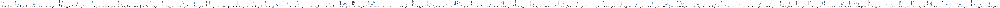

In [22]:
from RainEvent_Toolbox import find_rain_events
rain_event_list = find_rain_events(dataset = rv, 
                                   min_duration = 10,
                                   min_separation = 10,
                                   threshold = 10,
                                   noise_floor = 0.5,
                                   front_pad = 5, 
                                   end_pad = 120) #end_pad is usually 5, changed it to 2 hours to investigate the post-rain process
#plt.savefig('./Figures/Dynamo Rain Event Detection v4.png')

In [23]:
#import SST data
kt_dynamo = xr.open_dataset('../Data/Level_3/Dynamo/KT15/Dynamo_KT15_CalibratedSST.cdf')
#sort dataset into sequential timesteps
kt_dynamo = kt_dynamo.sortby(kt_dynamo.index)
#resample SST to 10 seconds
kt_1m = kt_dynamo.SST.resample(index='10s').mean()
#how many minutes before rain onset do we want to average as the baseline from which to calculate a delta?
pre_onset_averaging = 3

C:\ProgramData\Anaconda3\lib\site-packages\xarray\core\nanops.py:161: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis=axis, dtype=dtype)


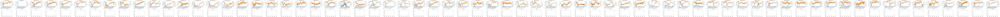

In [24]:
%autoreload
from RainEvent_Toolbox import sst_rain_response
sst_event_list = sst_rain_response(rain_event_list = rain_event_list,
                                   sst = kt_1m,
                                   pre_onset_averaging = pre_onset_averaging)
#plt.savefig('./Figures/Dynamo Rain Events + SST + Fluxes v4.png')

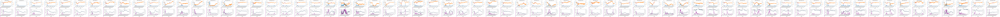

In [159]:
%autoreload
from RainEvent_Toolbox import plot_rain_events
plot_rain_events(rain_event_list = rain_event_list,  
                 sst_event_list = sst_event_list, 
                 rain_ylims = [-1,150],
                 δsst_ylims = [-1,0.5],
                 rhf_ylims = [0,300],
                 wind_ylims = [0,15])
#plt.savefig('./Figures/Dynamo Rain Events + deltaSST + Wind v3.png')

In [25]:
#hand-picking only simplest events
simple_events = [1,3,5,6,7,9,10,11,12,14,17,19,20,27,32,33,37,42,43,44,47,49,57,60,68]
windmeans = []
sst_recoveries = []
peak_rates = []
event_lengths = []
δssts = []

for event_num in [x-1 for x in simple_events]:
    event_length = (rain_event_list[event_num].attrs['Rain End'] - rain_event_list[event_num].attrs['Rain Onset']).astype('timedelta64[m]').astype('float')
    δsst_max = sst_event_list[event_num].attrs['Max δsst']
    
    #if event_length < 250:
    #if δsst_max < -0.4:
    sst_max = pd.to_datetime(sst_event_list[event_num].attrs['Time of max δsst'])
    sst_rec = pd.to_datetime(sst_event_list[event_num].attrs['Time of sst recovery'])
    wind_mean = rain_event_list[event_num].U10.sel(index=slice(sst_max,sst_rec)).mean().item()
    windmeans.append(wind_mean)

    sst_recoveries.append(sst_event_list[event_num].attrs['Minutes to sst recovery'])

    peak_rates.append(rain_event_list[event_num].attrs['Peak Rate'])

    event_lengths.append(event_length)

    δssts.append(δsst_max)

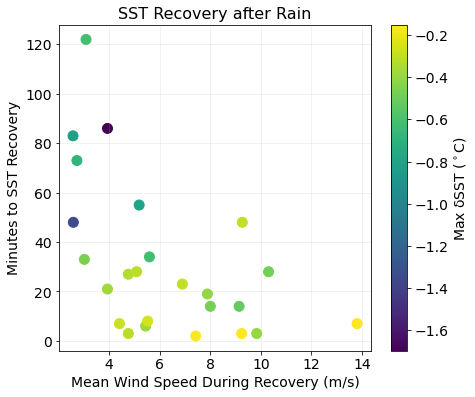

In [26]:
panel_font = 14
title_font = 16

fig,axx = plt.subplots(figsize=(7,6))
h1 = axx.scatter(windmeans,sst_recoveries,c=δssts,s=100)
cbar = plt.colorbar(h1,label='Max δSST ($^\circ$C)')

plt.xlabel('Mean Wind Speed During Recovery (m/s)',fontsize=panel_font)
plt.ylabel('Minutes to SST Recovery',fontsize=panel_font)
axx.xaxis.set_tick_params(labelsize=panel_font)
axx.yaxis.set_tick_params(labelsize=panel_font)
cbar.ax.tick_params(labelsize=panel_font)
cbar.ax.yaxis.label.set_fontsize(panel_font)

plt.title('SST Recovery after Rain',fontsize=title_font)
axx.grid(alpha=0.2)

#plt.savefig('./Figures/Wind Speed vs. Time for SST to Recover after Rain v2.png', dpi=300)

# Combine these two figures into 1 with 2 panels

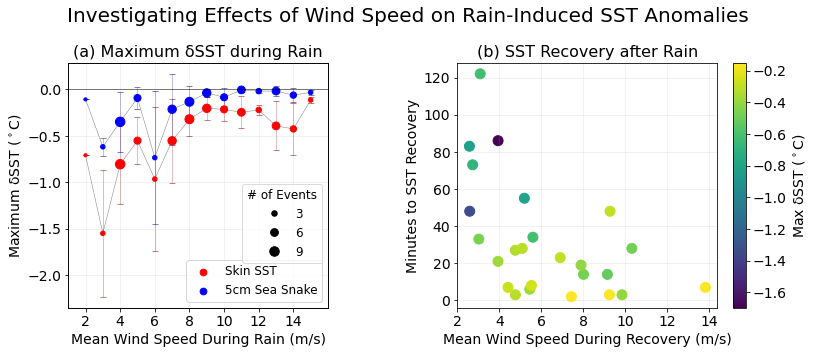

In [60]:
panel_font = 14
title_font = 16
capsz = 3

fig = plt.figure(figsize=(11.5,5))
axx0 = plt.subplot2grid(shape=(5,12),loc=(0,0),rowspan=5,colspan=5)

#---Figure 1: Max SST deviation as a funtion of wind speed---
axx0.errorbar(x=wind_bins, y=δsst_means, yerr=δsst_stds, fmt='-k', ecolor='darkred', linewidth=0.5, capsize=capsz, zorder=100, alpha = 0.5)
h1 = axx0.scatter(x=wind_bins, y=δsst_means, s=sizes, c='red',zorder=200)

axx0.errorbar(x=wind_bins, y=δTsea_means, yerr=δTsea_stds, fmt='-k', ecolor='darkblue', linewidth=0.5, capsize=capsz, zorder=100, alpha = 0.5)
h2 = axx0.scatter(x=wind_bins, y=δTsea_means, s=sizes, c='blue',zorder=200)

axx0.hlines(y=0,xmin=0,xmax=17,color='k',linewidth = 0.5,zorder=1000)

axx0.legend([h1,h2],['Skin SST','5cm Sea Snake'])

par = axx0.twinx()
par.legend(handles = h2.legend_elements("sizes", num=3)[0], labels=['3','6','9'], title='# of Events', bbox_to_anchor=(1,0.53), framealpha=0.7).set_zorder(1000)
par.set_yticks([])

axx0.set_title('(a) Maximum δSST during Rain', fontsize=title_font)

axx0.set_xlim([1,16])

axx0.set_xlabel('Mean Wind Speed During Rain (m/s)', fontsize=panel_font)
axx0.set_ylabel('Maximum δSST ($^\circ$C)', fontsize=panel_font)
axx0.xaxis.set_tick_params(labelsize=panel_font)
axx0.yaxis.set_tick_params(labelsize=panel_font)

axx0.set_xticks([2,4,6,8,10,12,14])
axx0.grid(alpha=0.2)

#-----Figure 2: Recovery as a function of wind speed----
axx1 = plt.subplot2grid(shape=(5,12),loc=(0,6),rowspan=5,colspan=6)

h1 = axx1.scatter(windmeans,sst_recoveries,c=δssts,s=100)
cbar = plt.colorbar(h1,ax=axx1,label='Max δSST ($^\circ$C)')

axx1.set_xlabel('Mean Wind Speed During Recovery (m/s)',fontsize=panel_font)
axx1.set_ylabel('Minutes to SST Recovery',fontsize=panel_font)
axx1.xaxis.set_tick_params(labelsize=panel_font)
axx1.yaxis.set_tick_params(labelsize=panel_font)
cbar.ax.tick_params(labelsize=panel_font)
cbar.ax.yaxis.label.set_fontsize(panel_font)
axx1.set_xticks([2,4,6,8,10,12,14])

axx1.set_title('(b) SST Recovery after Rain',fontsize=title_font)
axx1.grid(alpha=0.2)

plt.suptitle('Investigating Effects of Wind Speed on Rain-Induced SST Anomalies',fontsize=20,y=0.98)

plt.tight_layout()

plt.savefig('./Figures/Wind Effects Figures v1.png', dpi=300)

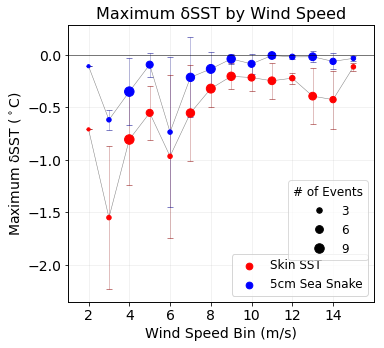

In [21]:
panel_font = 14
title_font = 16
capsz = 3

fig,axx = plt.subplots(figsize=(5.5,5))

axx.errorbar(x=wind_bins, y=δsst_means, yerr=δsst_stds, fmt='-k', ecolor='darkred', linewidth=0.5, capsize=capsz, zorder=100, alpha = 0.5)
h1 = axx.scatter(x=wind_bins, y=δsst_means, s=sizes, c='red',zorder=200)

axx.errorbar(x=wind_bins, y=δTsea_means, yerr=δTsea_stds, fmt='-k', ecolor='darkblue', linewidth=0.5, capsize=capsz, zorder=100, alpha = 0.5)
h2 = axx.scatter(x=wind_bins, y=δTsea_means, s=sizes, c='blue',zorder=200)

#axx.plot(wind_bins,np.zeros(len(wind_bins)),color='k',linewidth = 0.5,zorder=1000)
axx.hlines(y=0,xmin=0,xmax=17,color='k',linewidth = 0.5,zorder=1000)

axx.legend([h1,h2],['Skin SST','5cm Sea Snake'])

par = axx.twinx()
par.legend(handles = h2.legend_elements("sizes", num=3)[0], labels=['3','6','9'], title='# of Events', bbox_to_anchor=(1,0.46), framealpha=0.7).set_zorder(1000)
par.set_yticks([])

plt.title('Maximum δSST by Wind Speed', fontsize=title_font)

axx.set_xlim([1,16])

axx.set_xlabel('Wind Speed Bin (m/s)', fontsize=panel_font)
axx.set_ylabel('Maximum δSST ($^\circ$C)', fontsize=panel_font)
axx.xaxis.set_tick_params(labelsize=panel_font)
axx.yaxis.set_tick_params(labelsize=panel_font)

axx.set_xticks([2,4,6,8,10,12,14])
axx.grid(alpha=0.2)

plt.tight_layout()
#plt.savefig('./Figures/Max dSST by Wind Speed v1.png', dpi=300)

In [155]:
windmeans = []
sst_recoveries = []
peak_rates = []
event_lengths = []
δssts = []

for event_num in np.arange(0,len(rain_event_list)):
    event_length = (rain_event_list[event_num].attrs['Rain End'] - rain_event_list[event_num].attrs['Rain Onset']).astype('timedelta64[m]').astype('float')
    δsst_max = sst_event_list[event_num].attrs['Max δsst']
    
    if event_length < 250:
        if δsst_max < -0.4:
            sst_max = pd.to_datetime(sst_event_list[event_num].attrs['Time of max δsst'])
            sst_rec = pd.to_datetime(sst_event_list[event_num].attrs['Time of sst recovery'])
            wind_mean = rain_event_list[event_num].U10.sel(index=slice(sst_max,sst_rec)).mean().item()
            windmeans.append(wind_mean)

            sst_recoveries.append(sst_event_list[event_num].attrs['Minutes to sst recovery'])

            peak_rates.append(rain_event_list[event_num].attrs['Peak Rate'])

            event_lengths.append(event_length)

            δssts.append(δsst_max)

Text(0, 0.5, 'Minutes to SST recovery')

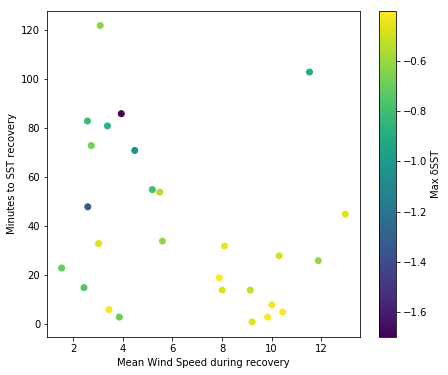

In [156]:
fig,axx = plt.subplots(figsize=(7,6))
h1 = axx.scatter(windmeans,sst_recoveries,c=δssts)
plt.colorbar(h1,label='Max δSST')

plt.xlabel('Mean Wind Speed during recovery')
plt.ylabel('Minutes to SST recovery')

In [154]:
δssts

[Timestamp('2011-09-09 20:47:50'),
 Timestamp('2011-10-01 13:45:00'),
 Timestamp('2011-10-01 20:09:30'),
 Timestamp('2011-10-03 08:44:20'),
 Timestamp('2011-10-14 05:14:30'),
 Timestamp('2011-10-16 03:57:40'),
 Timestamp('2011-10-27 21:52:30'),
 Timestamp('2011-11-08 01:09:40'),
 Timestamp('2011-11-08 08:32:00'),
 Timestamp('2011-11-09 18:09:50'),
 Timestamp('2011-11-09 23:12:10'),
 Timestamp('2011-11-10 03:35:30'),
 Timestamp('2011-11-15 09:41:50'),
 Timestamp('2011-11-19 12:31:10'),
 Timestamp('2011-11-21 17:17:10'),
 Timestamp('2011-11-22 01:47:20'),
 Timestamp('2011-11-22 03:51:10'),
 Timestamp('2011-11-23 06:17:00'),
 Timestamp('2011-11-23 16:49:50'),
 Timestamp('2011-11-25 03:14:40'),
 Timestamp('2011-11-25 11:55:40'),
 Timestamp('2011-11-25 14:34:20'),
 Timestamp('2011-11-28 02:07:00'),
 Timestamp('2011-11-28 14:22:40'),
 Timestamp('2011-11-28 18:53:00'),
 Timestamp('2011-12-22 11:21:10'),
 Timestamp('2011-12-25 01:43:40')]

C:\ProgramData\Anaconda3\lib\site-packages\xarray\core\nanops.py:161: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis=axis, dtype=dtype)


Text(0, 0.5, 'Minutes to SST recovery')

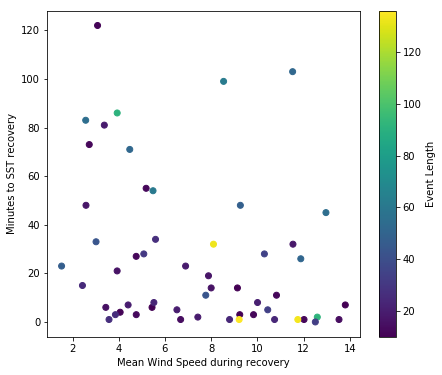

In [132]:
windmeans = []
sst_recoveries = []
peak_rates = []
event_lengths = []
δssts = []

for event_num in np.arange(0,len(rain_event_list)):
    event_length = (rain_event_list[event_num].attrs['Rain End'] - rain_event_list[event_num].attrs['Rain Onset']).astype('timedelta64[m]').astype('float')
    
    if event_length < 250:
        sst_max = pd.to_datetime(sst_event_list[event_num].attrs['Time of max δsst'])
        sst_rec = pd.to_datetime(sst_event_list[event_num].attrs['Time of sst recovery'])
        wind_mean = rain_event_list[event_num].U10.sel(index=slice(sst_max,sst_rec)).mean().item()
        windmeans.append(wind_mean)

        sst_recoveries.append(sst_event_list[event_num].attrs['Minutes to sst recovery'])

        peak_rates.append(rain_event_list[event_num].attrs['Peak Rate'])


        event_lengths.append(event_length)

        δssts.append(sst_event_list[event_num].attrs['Max δsst'])
    
fig,axx = plt.subplots(figsize=(7,6))
h1 = axx.scatter(windmeans,sst_recoveries,c=event_lengths)
plt.colorbar(h1,label='Event Length')

plt.xlabel('Mean Wind Speed during recovery')
plt.ylabel('Minutes to SST recovery')

In [ ]:
#Generate the composite plots for every threshold pair
for threshold in tqdm.tqdm(np.arange(1,20)):
    rain_above, rain_below = [], []
    sst_above, sst_below = [], []

    #loop through each event and sort events into "above" and "below" lists based on mean wind speed between rain onset and max δsst
    for rain,sst in zip(rain_event_list,sst_event_list):
        start = pd.to_datetime(rain.attrs['Rain Onset'])
        sst_max = pd.to_datetime(sst.attrs['Time of max δsst'])
        wind_mean = rain.U10.sel(index=slice(start,sst_max)).mean().item()

        if wind_mean > threshold:
            rain_above.append(rain)
            sst_above.append(sst)
        else:
            rain_below.append(rain)
            sst_below.append(sst)

    composite_above = extract_composite_event(rain_event_list = rain_above, 
                                              sst_event_list = sst_above, 
                                              param_list = param_list, 
                                              start = -2, 
                                              stop = 7, 
                                              spacing = 0.2,
                                              plotflag = 1,
                                              title = f'DYNAMO Rain Events ABOVE {threshold} m/s')
    plt.savefig(f'./Figures/Wind Threshold Composites/Composite Events Wind Threshold {threshold} ABOVE.png')
    plt.close()

    composite_below = extract_composite_event(rain_event_list = rain_below, 
                                              sst_event_list = sst_below, 
                                              param_list = param_list, 
                                              start = -2, 
                                              stop = 7, 
                                              spacing = 0.2,
                                              plotflag = 1,
                                              title = f'DYNAMO Rain Events BELOW {threshold} m/s')

    plt.savefig(f'./Figures/Wind Threshold Composites/Composite Events Wind Threshold {threshold} BELOW.png')
    plt.close()


In [61]:
#generate plot of threshold vs. max delta-sst for above and below cases
δsst_means_above = []
δsst_means_below = []
δsst_stds_above = []
δsst_stds_below = []
sizes_above = []
sizes_below = []
thresholds = np.arange(2,17)

for threshold in tqdm.tqdm(thresholds):
    rain_above, rain_below = [], []
    sst_above, sst_below = [], []

    #loop through each event and sort events into "above" and "below" lists based on mean wind speed between rain onset and max δsst
    for rain,sst in zip(rain_event_list,sst_event_list):
        start = pd.to_datetime(rain.attrs['Rain Onset'])
        sst_max = pd.to_datetime(sst.attrs['Time of max δsst'])
        wind_mean = rain.U10.sel(index=slice(start,sst_max)).mean().item()

        if wind_mean > threshold:
            rain_above.append(rain)
            sst_above.append(sst)
        else:
            rain_below.append(rain)
            sst_below.append(sst)

    composite_above = extract_composite_event(rain_event_list = rain_above, 
                                              sst_event_list = sst_above, 
                                              param_list = param_list, 
                                              start = -2, 
                                              stop = 7, 
                                              spacing = 0.2,
                                              plotflag = 0,
                                              title = '')
    composite_below = extract_composite_event(rain_event_list = rain_below, 
                                              sst_event_list = sst_below, 
                                              param_list = param_list, 
                                              start = -2, 
                                              stop = 7, 
                                              spacing = 0.2,
                                              plotflag = 0,
                                              title = '')
    #calculate mean and std of composite event at maximum δsst
    δTsea_mean_above = composite_above.δTsea.mean(dim='event',skipna=True).sel(index=1).item()
    δTsea_mean_below = composite_below.δTsea.mean(dim='event',skipna=True).sel(index=1).item()
    δTsea_std_above = composite_above.δTsea.std(dim='event',skipna=True).sel(index=1).item()
    δTsea_std_below = composite_below.δTsea.std(dim='event',skipna=True).sel(index=1).item()
    
    δTsea_means_above.append(δTsea_mean_above)
    δTsea_means_below.append(δTsea_mean_below)
    δTsea_stds_above.append(δTsea_std_above)
    δTsea_stds_below.append(δTsea_std_below)
    
    #calculate how many entries are involved with each event to scale dot sizes
    entries_above = composite_above.δTsea.sel(index=1).count().values.item()
    entries_below = composite_below.δTsea.sel(index=1).count().values.item()
    
    sizes_above.append(entries_above)
    sizes_below.append(entries_below)


  0%|                                                                                           | 0/15 [00:00<?, ?it/s]C:\ProgramData\Anaconda3\lib\site-packages\xarray\core\nanops.py:161: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis=axis, dtype=dtype)
C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:20: RuntimeWarning: invalid value encountered in less
100%|██████████████████████████████████████████████████████████████████████████████████| 15/15 [01:37<00:00,  6.25s/it]


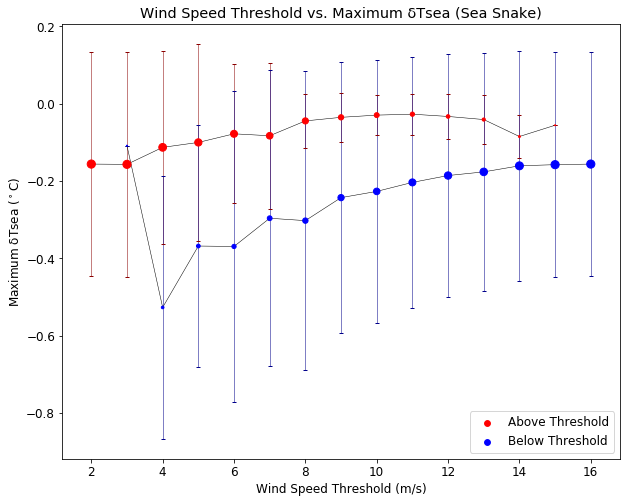

In [62]:
fig,axx = plt.subplots(figsize=(10,8))

axx.errorbar(x=thresholds, y=δsst_means_above, yerr=δsst_stds_above, fmt='-k', ecolor='darkred', linewidth=0.5, capsize=10*spacing, zorder=100)
h1 = axx.scatter(x=thresholds, y=δsst_means_above, s=sizes_above, c='red',zorder=200)

axx.errorbar(x=thresholds, y=δsst_means_below, yerr=δsst_stds_below, fmt='-k', ecolor='darkblue', linewidth=0.5, capsize=10*spacing, zorder=100)
h2 = axx.scatter(x=thresholds, y=δsst_means_below, s=sizes_below, c='blue',zorder=200)

axx.plot(x=thresholds,y=np.zeros(len(thresholds)),color='k',linewidth = 0.5,zorder=1000)

axx.legend([h1,h2],['Above Threshold','Below Threshold'])
plt.title('Wind Speed Threshold vs. Maximum δTsea (Sea Snake)')

axx.set_xlabel('Wind Speed Threshold (m/s)')
axx.set_ylabel('Maximum δTsea ($^\circ$C)')

plt.savefig('./Figures/Wind Threshold vs Max Sea Snake v1.png')

# Experimenting with Changing definition of a rain event

Rather than being a start-to-finish "it's raining" thing, try treating each rainfall peak as its own event - may get a more characteristic relationship that way

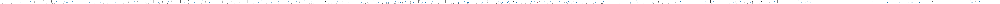

In [170]:
from RainEvent_Toolbox import find_rain_events
rain_event_list = find_rain_events(dataset = rv, 
                                   min_duration = 1,
                                   min_separation = 1,
                                   threshold = 10,
                                   noise_floor = 2,
                                   front_pad = 5, 
                                   end_pad = 3) 
#plt.savefig('./Figures/Dynamo Rain Event Detection v4.png')

In [74]:
#import SST data
kt_dynamo = xr.open_dataset('../Data/Level_3/Dynamo/KT15/Dynamo_KT15_CalibratedSST.cdf')
#sort dataset into sequential timesteps
kt_dynamo = kt_dynamo.sortby(kt_dynamo.index)
#resample SST to 10 seconds
kt_1m = kt_dynamo.SST.resample(index='10s').mean()
#how many minutes before rain onset do we want to average as the baseline from which to calculate a delta?
pre_onset_averaging = 3

C:\ProgramData\Anaconda3\lib\site-packages\xarray\core\nanops.py:161: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis=axis, dtype=dtype)
C:\ProgramData\Anaconda3\lib\site-packages\xarray\core\nanops.py:161: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis=axis, dtype=dtype)
C:\ProgramData\Anaconda3\lib\site-packages\xarray\core\nanops.py:161: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis=axis, dtype=dtype)


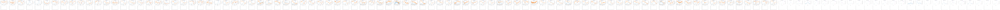

In [171]:
%autoreload
from RainEvent_Toolbox import sst_rain_response
sst_event_list = sst_rain_response(rain_event_list = rain_event_list,
                                   sst = kt_1m,
                                   pre_onset_averaging = pre_onset_averaging)
#plt.savefig('./Figures/Dynamo Rain Events + SST + Fluxes v4.png')

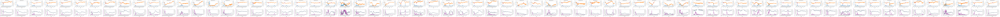

In [114]:
%autoreload
from RainEvent_Toolbox import plot_rain_events
plot_rain_events(rain_event_list = rain_event_list,  
                 sst_event_list = sst_event_list, 
                 rain_ylims = [-1,150],
                 δsst_ylims = [-1,0.5],
                 rhf_ylims = [0,300],
                 wind_ylims = [0,15])
#plt.savefig('./Figures/Dynamo Rain Events + deltaSST + Wind v3.png')

#### Scatter plotting rain rate vs wind speed

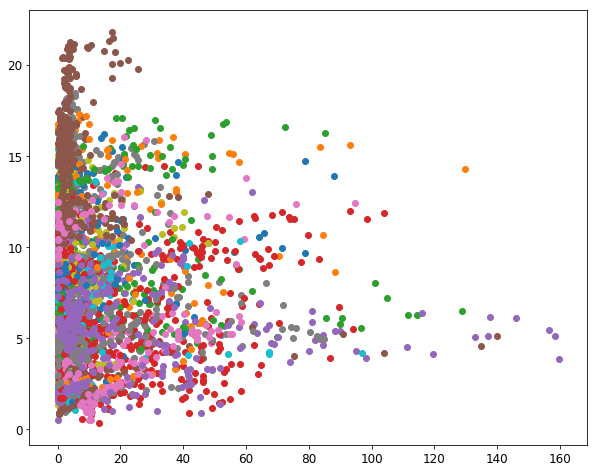

In [49]:
fig,axx = plt.subplots(figsize=(10,8))

for rain_event in rain_event_list:
    axx.scatter(x=rain_event.P, y=rain_event.U10)

In [47]:
rain_event

<xarray.Dataset>
Dimensions:   (index: 22)
Coordinates:
  * index     (index) datetime64[ns] 2011-09-09T20:33:00 ... 2011-09-09T20:54:00
Data variables:
    COG       (index) float64 ...
    E         (index) float64 ...
    Evap      (index) float64 ...
    Heading   (index) float64 ...
    IRdn      (index) float64 ...
    IRup      (index) float64 ...
    Lat       (index) float64 ...
    Lon       (index) float64 ...
    P         (index) float64 0.0 0.0 0.0 0.0 0.0 0.4 ... 0.2514 0.0 0.0 0.0 0.0
    Pair10    (index) float64 ...
    Precip    (index) float64 6.842 6.842 6.842 6.842 ... 14.55 14.55 14.55
    Q02       (index) float64 ...
    Q10       (index) float64 ...
    Qsea      (index) float64 ...
    RH02      (index) float64 ...
    RH10      (index) float64 ...
    SOG       (index) float64 ...
    SSQ       (index) float64 ...
    SST       (index) float64 27.39 27.38 27.38 27.38 ... 27.33 27.35 27.36
    SalTSG    (index) float64 34.86 34.86 34.86 34.86 ... 34.86 34.86 

In [ ]:
means_above = composite_above.mean(dim='event',skipna=True)
means_below = composite_below.mean(dim='event',skipna=True)

stds_above = composite_above.std(dim='event',skipna=True)
stds_below = composite_below.std(dim='event',skipna=True)

idx = 0

fig,axx = plt.subplots(nrows = 2, ncols = 2, figsize = (12,8))

def plot_sst_deltas(means, stds, axis, start, stop):
    ticks = np.arange(start,stop+1,1)
    ticklabels = ticks.astype('str').tolist()
    ticklabels[-start] = 'Onset'
    ticklabels[-start + 1] = r'$ \delta SST_{max} $'
    
    axx[idx,0].errorbar(x=resample_coords, y=means.δsst, yerr=stds.δsst, fmt='-k', ecolor='k', linewidth=0.5, capsize=10*spacing, zorder=100)
    h1 = axx[idx,0].scatter(x=resample_coords, y=means.δsst, s=sizes, c='red',zorder=200)
    h2 = axx[idx,0].scatter(x=resample_coords, y=means.δSST, s=sizes, facecolors='none', edgecolors='darkred' ,zorder=150) #plots COARE skin-corrected SST
    h3 = axx[idx,0].scatter(x=resample_coords, y=means.δSSTrain, s=sizes, facecolors='none', edgecolors='darkmagenta' ,zorder=150) #plots COARE skin-corrected SST + rain effect
    #axx[idx,0].set_xlim([resample_coords[0],resample_coords[-1]])
    axx[idx,0].set_xticks(ticks)
    axx[idx,0].set_xticklabels(ticklabels)
    axx[idx,0].set_xlabel(r'Normalized Time $ (t-t_{onset})/t_{δSST_{max}}$')
    axx[idx,0].set_ylabel('δSST ($^\circ C$)')
    axx[idx,0].set_ylim(temp_ylims)
    axx[idx,0].set_title('Skin SST')
    axx[idx,0].legend([h1,h2,h3],['Observed by KT-15', 'COARE (no rain)','COARE (with rain)'])

## Develop a basic relationship between Rain Rate and $\delta SST$ to use in the Global CO2 Flux Manuscript?

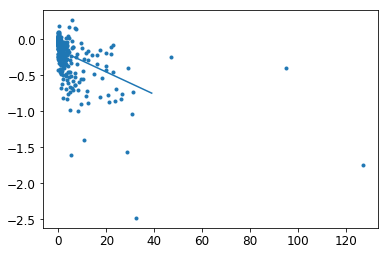

In [13]:
fig,axx = plt.subplots(facecolor='w')

#plot raw data
precip_raw = []
δsst_raw = []
for event_num in np.arange(1,len(composite_event.event)+1):
    data = composite_event.sel(index=slice(0,1)).sel(event=event_num)
    precip_raw.extend(data.δPrecip.values.tolist())
    δsst_raw.extend(data.δsst.values.tolist())
    axx.plot(data.δPrecip,data.δsst,'.',color='C0')

#plot regression to raw data
nanMask = np.isnan(δsst_raw)

slope1, intercept1, r_value1, p_value1, std_err1 = scipy.stats.linregress(np.array(precip_raw)[~nanMask], np.array(δsst_raw)[~nanMask])
precip_array = np.arange(0,40)
axx.plot(precip_array, precip_array*slope1 + intercept1, 'C0', zorder=20)

Text(0.5, 1.0, 'Rain Rate vs. δsst for raw (blue) and composite (orange) data')

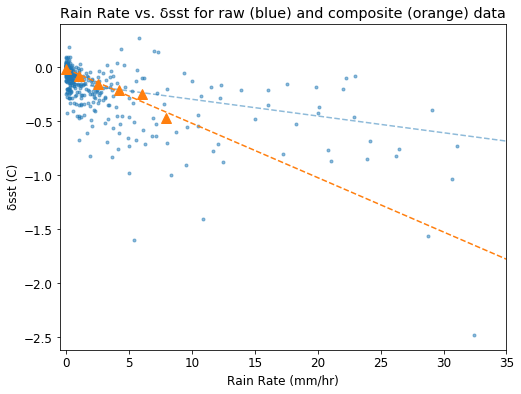

In [14]:
fig,axx = plt.subplots(facecolor='w', figsize=(8,6))

compStart, compEnd = 0, 1
#plot raw data
precip_raw = []
δsst_raw = []
for event_num in np.arange(1,len(composite_event.event)+1):
    data = composite_event.sel(index=slice(compStart, compEnd)).sel(event=event_num)
    precip_raw.extend(data.δPrecip.values.tolist())
    δsst_raw.extend(data.δsst.values.tolist())
    h1 = axx.plot(data.δPrecip,data.δsst,'.',color='C0', alpha=0.5)

#plot regression to raw data
nanMask = np.isnan(δsst_raw)

slope1, intercept1, r_value1, p_value1, std_err1 = scipy.stats.linregress(np.array(precip_raw)[~nanMask], np.array(δsst_raw)[~nanMask])
precip_array = np.arange(0,40)
axx.plot(precip_array, precip_array*slope1 + intercept1, 'C0', zorder=0, linestyle='--', alpha=0.5)

#plot means across events
δsst_mean = composite_event.sel(index=slice(compStart, compEnd)).δsst.mean(dim='event',skipna=True)
δsst_std = composite_event.sel(index=slice(compStart, compEnd)).δsst.std(dim='event',skipna=True)
precip_mean = composite_event.sel(index=slice(compStart, compEnd)).δPrecip.mean(dim='event',skipna=True)
precip_std = composite_event.sel(index=slice(compStart, compEnd)).δPrecip.std(dim='event',skipna=True)
h2 = axx.plot(precip_mean, δsst_mean,'^', color='C1',markersize=10, zorder=10)

#plot regression to means
slope, intercept, r_value, p_value, std_err = scipy.stats.linregress(precip_mean, δsst_mean)
precip_array = np.arange(0,40)
axx.plot(precip_array, precip_array*slope + intercept, 'C1', zorder=20, linestyle='--')
#axx.annotate('$R^2$ = %0.2f' % r_value**2, xy=(0.75, 0.89), xycoords='axes fraction')

axx.set_xlim([-0.5,35])
axx.set_ylabel('δsst (C)')
axx.set_xlabel('Rain Rate (mm/hr)')
axx.set_title('Rain Rate vs. δsst for raw (blue) and composite (orange) data')

In [15]:
slope, intercept

(-0.05035737566589752, -0.017021955625662222)

In [30]:
δsst_mean.mean(dim='')

<xarray.DataArray 'δsst' (index: 6)>
array([-0.015783, -0.086417, -0.157008, -0.212959, -0.251032, -0.469222])
Coordinates:
  * index    (index) float64 0.0 0.2 0.4 0.6 0.8 1.0

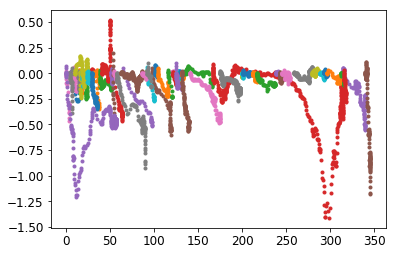

In [22]:
fig,axx=plt.subplots(facecolor='w')

for event in rain_event_list:
    axx.plot(event.Precip, event.δSST,'.')


## Re-do plot including only rain events which occurred at night

In [40]:
rain_event_list_night = []
night_threshold = 3 #if the average downwelling solar is less than this value during the rain event, consider it to be nighttime
for event in rain_event_list:
    if np.abs(event.Solardn.mean()) < night_threshold:
        rain_event_list_night.append(event)

len(rain_event_list_night)

34

C:\ProgramData\Anaconda3\lib\site-packages\xarray\core\nanops.py:161: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis=axis, dtype=dtype)


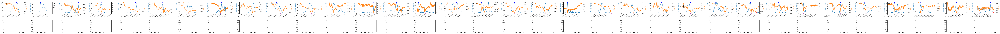

In [41]:
from RainEvent_Toolbox import sst_rain_response
sst_event_list_night = sst_rain_response(rain_event_list = rain_event_list_night,
                                           sst = kt_1m,
                                           pre_onset_averaging = pre_onset_averaging)

In [43]:
#define the relevant paramters you would like to calculate a delta for (in addition to SST)
param_list = ['Tsea','TseaTSG','SalTSG','T02','T10','U10','Precip','rhf','SST']

from RainEvent_Toolbox import calculate_deltas
rain_event_list_night = calculate_deltas(rain_event_list = rain_event_list_night,
                                           param_list = param_list,
                                           pre_onset_averaging = pre_onset_averaging)

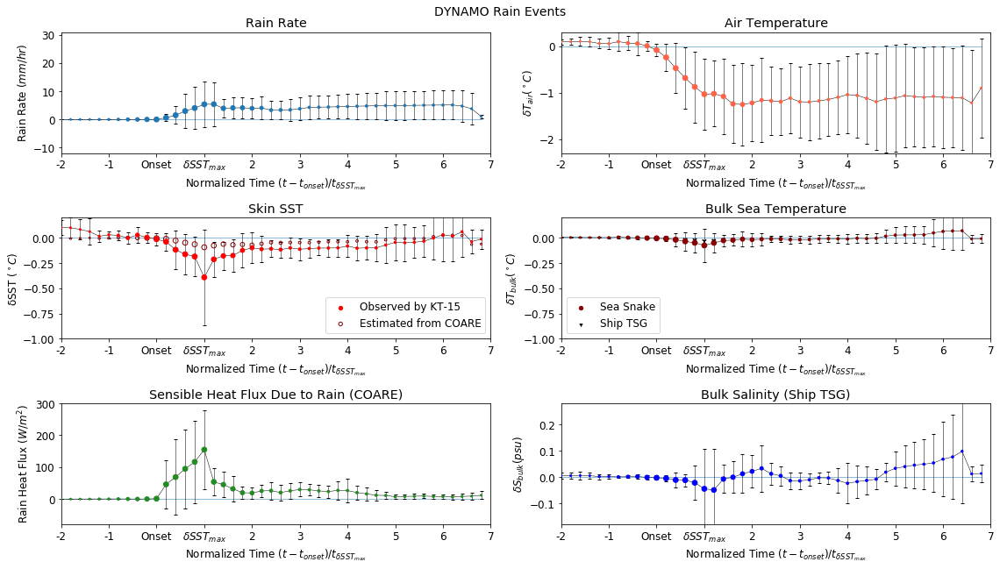

In [48]:
plt.rcParams['font.size'] = 12
%autoreload
from RainEvent_Toolbox import extract_composite_event
composite_event_night = extract_composite_event(rain_event_list = rain_event_list_night, 
                                                  sst_event_list = sst_event_list_night, 
                                                  param_list = param_list, 
                                                  start = -2, 
                                                  stop = 7, 
                                                  spacing = 0.2)
plt.savefig('./Figures/Composite Events v7 NIGHT ONLY.png')

## Compare COARE SST to KT-15 SST for non-rain times

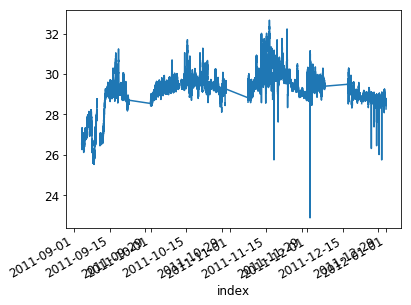

In [55]:
kt_1m.where(rv.P==0).plot()

In [83]:
kt_1m_seaTemp = kt_dynamo.SeaTemp_Cal.resample(index='10s').mean()

In [84]:
kt_seaTemp_norain = kt_1m_seaTemp.where(rv.P==0)
len(kt_seaTemp_norain)

113140

In [62]:
kt_norain = kt_1m.where(rv.P==0)
rv_norain = rv.where(rv.P==0).where(kt_norain!=0)
len(rv_norain.index),len(kt_norain)

(113140, 113140)

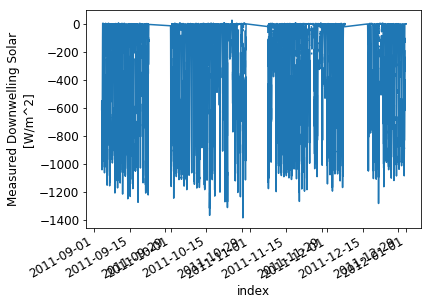

In [115]:
rv_norain.Solardn.plot()

In [116]:
night_threshold = -4  #downwelling is negative
kt_norain_day = kt_norain.where(rv_norain.Solardn<=night_threshold)
kt_norain_night = kt_norain.where(rv_norain.Solardn>night_threshold)

kt_seatemp_norain_day = kt_seaTemp_norain.where(rv_norain.Solardn<=night_threshold)
kt_seatemp_norain_night = kt_seaTemp_norain.where(rv_norain.Solardn>night_threshold)

rv_norain_day = rv_norain.where(rv_norain.Solardn<=night_threshold)
rv_norain_night = rv_norain.where(rv_norain.Solardn>night_threshold)

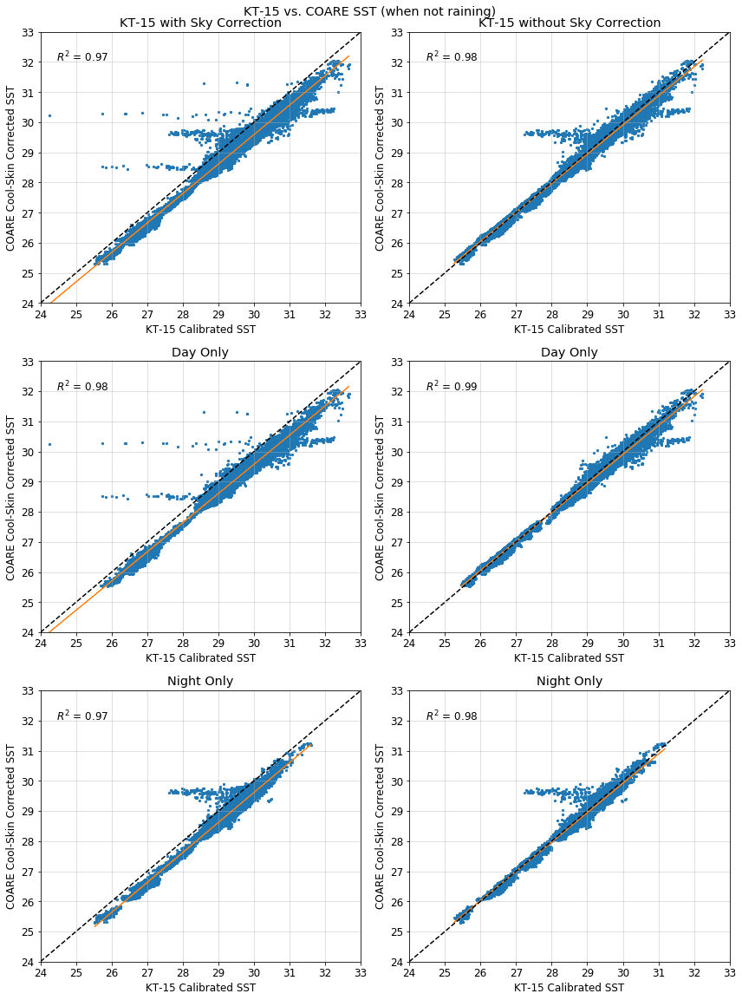

In [119]:
%autoreload
from RainEvent_Toolbox import scatterplot_with_linreg

fig,axx = plt.subplots(nrows=3,ncols=2,figsize=(12,16),facecolor='w')

idx = np.isfinite(kt_norain.values)
scatterplot_with_linreg(axx[0,0], kt_norain[idx], 'KT-15 Calibrated SST', rv_norain.SST[idx], 'COARE Cool-Skin Corrected SST')
scatterplot_with_linreg(axx[0,1], kt_seaTemp_norain[idx], 'KT-15 Calibrated SST', rv_norain.SST[idx], 'COARE Cool-Skin Corrected SST')

idx_day = np.isfinite(kt_norain_day.values)
scatterplot_with_linreg(axx[1,0], kt_norain_day[idx_day], 'KT-15 Calibrated SST', rv_norain_day.SST[idx_day], 'COARE Cool-Skin Corrected SST')
scatterplot_with_linreg(axx[1,1], kt_seatemp_norain_day[idx_day], 'KT-15 Calibrated SST', rv_norain_day.SST[idx_day], 'COARE Cool-Skin Corrected SST')

idx_night = np.isfinite(kt_norain_night.values)
scatterplot_with_linreg(axx[2,0], kt_norain_night[idx_night], 'KT-15 Calibrated SST', rv_norain_night.SST[idx_night], 'COARE Cool-Skin Corrected SST')
scatterplot_with_linreg(axx[2,1], kt_seatemp_norain_night[idx_night], 'KT-15 Calibrated SST', rv_norain_night.SST[idx_night], 'COARE Cool-Skin Corrected SST')

axx[0,0].set_title('KT-15 with Sky Correction')
axx[0,1].set_title('KT-15 without Sky Correction')

axx[1,0].set_title('Day Only')
axx[1,1].set_title('Day Only')

axx[2,0].set_title('Night Only')
axx[2,1].set_title('Night Only')

lines = np.arange(24,34)
for axis in axx[:,0]:
    axis.plot(lines,lines,'--k')
    axis.set_ylim([24,33])
    axis.set_xlim([24,33])
    axis.grid(alpha=0.5)
for axis in axx[:,1]:
    axis.plot(lines,lines,'--k')
    axis.set_ylim([24,33])
    axis.set_xlim([24,33])
    axis.grid(alpha=0.5)
    
plt.suptitle('KT-15 vs. COARE SST (when not raining)',y=0.9999)

plt.tight_layout()

plt.savefig('./Figures/KT_COARE_comparison_norain_v2.png')

In [127]:
kt_1m_seaTemp = kt_dynamo.SeaTemp.resample(index='10s').mean()

In [130]:
kt_seaTemp_norain = kt_1m_seaTemp.where(rv.P==0)
len(kt_seaTemp_norain)

113140

In [62]:
kt_norain = kt_1m.where(rv.P==0)
rv_norain = rv.where(rv.P==0).where(kt_norain!=0)
len(rv_norain.index),len(kt_norain)

(113140, 113140)

In [131]:
night_threshold = -4  #downwelling is negative
kt_norain_day = kt_norain.where(rv_norain.Solardn<=night_threshold)
kt_norain_night = kt_norain.where(rv_norain.Solardn>night_threshold)

kt_seatemp_norain_day = kt_seaTemp_norain.where(rv_norain.Solardn<=night_threshold)
kt_seatemp_norain_night = kt_seaTemp_norain.where(rv_norain.Solardn>night_threshold)

rv_norain_day = rv_norain.where(rv_norain.Solardn<=night_threshold)
rv_norain_night = rv_norain.where(rv_norain.Solardn>night_threshold)

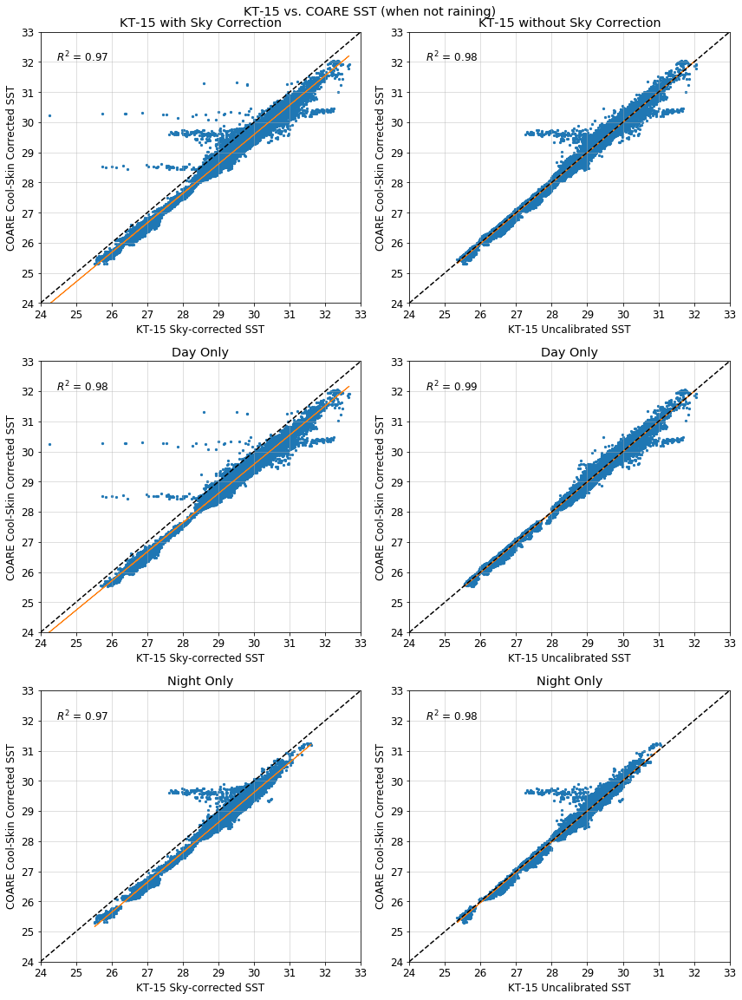

In [132]:
%autoreload
from RainEvent_Toolbox import scatterplot_with_linreg

fig,axx = plt.subplots(nrows=3,ncols=2,figsize=(12,16),facecolor='w')

idx = np.isfinite(kt_norain.values)
scatterplot_with_linreg(axx[0,0], kt_norain[idx], 'KT-15 Sky-corrected SST', rv_norain.SST[idx], 'COARE Cool-Skin Corrected SST')
scatterplot_with_linreg(axx[0,1], kt_seaTemp_norain[idx], 'KT-15 Uncalibrated SST', rv_norain.SST[idx], 'COARE Cool-Skin Corrected SST')

idx_day = np.isfinite(kt_norain_day.values)
scatterplot_with_linreg(axx[1,0], kt_norain_day[idx_day], 'KT-15 Sky-corrected SST', rv_norain_day.SST[idx_day], 'COARE Cool-Skin Corrected SST')
scatterplot_with_linreg(axx[1,1], kt_seatemp_norain_day[idx_day], 'KT-15 Uncalibrated SST', rv_norain_day.SST[idx_day], 'COARE Cool-Skin Corrected SST')

idx_night = np.isfinite(kt_norain_night.values)
scatterplot_with_linreg(axx[2,0], kt_norain_night[idx_night], 'KT-15 Sky-corrected SST', rv_norain_night.SST[idx_night], 'COARE Cool-Skin Corrected SST')
scatterplot_with_linreg(axx[2,1], kt_seatemp_norain_night[idx_night], 'KT-15 Uncalibrated SST', rv_norain_night.SST[idx_night], 'COARE Cool-Skin Corrected SST')

axx[0,0].set_title('KT-15 with Sky Correction')
axx[0,1].set_title('KT-15 without Sky Correction')

axx[1,0].set_title('Day Only')
axx[1,1].set_title('Day Only')

axx[2,0].set_title('Night Only')
axx[2,1].set_title('Night Only')

lines = np.arange(24,34)
for axis in axx[:,0]:
    axis.plot(lines,lines,'--k')
    axis.set_ylim([24,33])
    axis.set_xlim([24,33])
    axis.grid(alpha=0.5)
for axis in axx[:,1]:
    axis.plot(lines,lines,'--k')
    axis.set_ylim([24,33])
    axis.set_xlim([24,33])
    axis.grid(alpha=0.5)
    
plt.suptitle('KT-15 vs. COARE SST (when not raining)',y=0.9999)

plt.tight_layout()

plt.savefig('./Figures/KT_COARE_comparison_norain_v2_uncalibrated.png')

(24, 33)

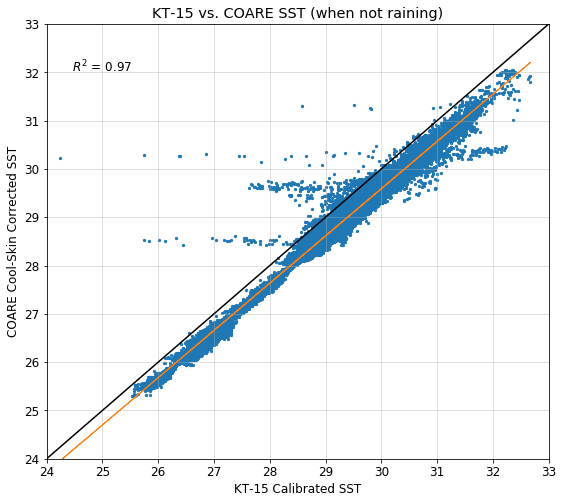

In [88]:
%autoreload
from RainEvent_Toolbox import scatterplot_with_linreg

idx = np.isfinite(kt_norain.values)

fig,axx = plt.subplots(figsize=(9,8),facecolor='w')
scatterplot_with_linreg(axx, kt_norain[idx], 'KT-15 Calibrated SST', rv_norain.SST[idx], 'COARE Cool-Skin Corrected SST')

lines = np.arange(24,34)
plt.plot(lines,lines,'k')
plt.title('KT-15 vs. COARE SST (when not raining)')
plt.grid(alpha=0.5)
plt.xlim([24,33])
plt.ylim([24,33])

#plt.savefig('./Figures/KT_COARE_comparison_norain.png')

- ~~Add bulk TSG temp to right-hand bulk temp plot~~
- ~~what does the plot look like if we only include rain events at night? (remove potential diurnal effect)~~
- ~~compare COARE's corrected SST to our KT-15 SST for all non-rain-contaminated times- how close are they?~~

- ~~Add 1:1 line to plot, and make one plot with sky-corrected KT15 and one without sky-correction. Put lines on TOP of scatterplots. Then make a version for just day vs. just night to see if there's a reflection.~~

Next step: use Jim's fluxes to see what direct fluxes look like

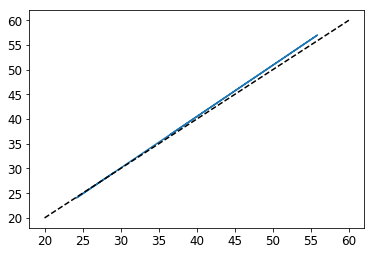

In [126]:
fig,axx=plt.subplots(facecolor='w')
plt.plot(kt_dynamo.SeaTemp,kt_dynamo.SeaTemp_Cal)
plt.plot([20,60],[20,60],'--k')

# ------------------
# More Stuff
# ------------------

## Correlation between rain rate & delta-SST between onset and max

Text(0.5, 1.0, 'Between Rain Onset and Time of Max δSST')

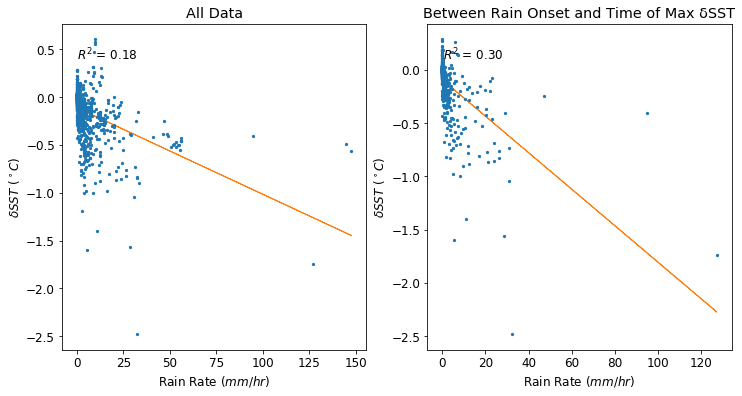

In [102]:
#fill list with pandas dataframes of each event, then concat them together into one big dataframe
events_df_list = []
for event_num in np.arange(1,len(composite_event.event)+1):
    events_df_list.append(composite_event.sel(event=event_num).to_dataframe())
all_events = pd.concat(events_df_list).dropna().reset_index()

#plot them
fig,axx=plt.subplots(ncols=2, figsize=(12,6),facecolor='w')

from RainEvent_Toolbox import scatterplot_with_linreg
scatterplot_with_linreg(axis=axx[0], 
                        x=all_events.δPrecip, xlabel='Rain Rate $(mm/hr)$', 
                        y=all_events.δsst, ylabel='$\delta SST$ $(^\circ C)$')
axx[0].set_title('All Data')


all_events_sub = all_events.where(all_events['index']<=1).dropna()
scatterplot_with_linreg(axis=axx[1], 
                        x=all_events_sub.δPrecip, xlabel='Rain Rate $(mm/hr)$', 
                        y=all_events_sub.δsst, ylabel='$\delta SST$ $(^\circ C)$')
axx[1].set_title('Between Rain Onset and Time of Max δSST')

In [5]:
#for Edson
SeaTemp = kt_dynamo.SeaTemp_Cal.to_pandas()
kt_seatemp_1min = SeaTemp.resample('1min', loffset='30s').mean()
kt_seatemp_1min.to_csv('../Data/Level_3/Dynamo/KT15/Dynamo_KT15_SeaTemp_1min.csv')

C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: The signature of `Series.to_csv` was aligned to that of `DataFrame.to_csv`, and argument 'header' will change its default value from False to True: please pass an explicit value to suppress this warning.
  after removing the cwd from sys.path.


In [6]:
SeaTemp_nocal = kt_dynamo.SeaTemp.to_pandas()
kt_seatempnocal_1min = SeaTemp_nocal.resample('1min', loffset='30s').mean()

In [7]:
kt_seatemp_1min.mean()

28.70808432878319

In [8]:
kt_seatempnocal_1min.mean()

28.669257520620963

(28, 32)

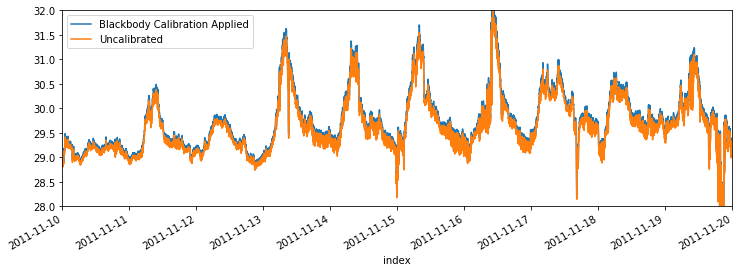

In [9]:
fig,axx = plt.subplots(figsize=(12,4),facecolor='w')
kt_seatemp_1min.plot()
kt_seatempnocal_1min.plot()
plt.legend(['Blackbody Calibration Applied','Uncalibrated'])

axx.set_xlim([pd.datetime(2011,11,10),pd.datetime(2011,11,20)])
axx.set_ylim([28,32])

#### Looking to see if there are any other post-rain warming events like the Nov 23 event (Rain event #45 by current detection parameters)

In [12]:
from RainEvent_Toolbox import find_rain_events
from RainEvent_Toolbox import sst_rain_response

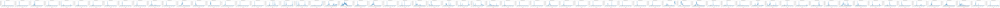

In [13]:
#re-do rain event detection with a really long end pad so that we can look at the following 4 hours, and put the preceding 1hr as well
rain_event_list_long = find_rain_events(dataset = rv, 
                                        min_duration = 10,
                                        min_separation = 10,
                                        threshold = 10,
                                        noise_floor = 0.5,
                                        front_pad = 60, 
                                        end_pad = 4*60)

In [14]:
SeaTemp = kt_dynamo.SeaTemp_Cal.to_pandas()
kt_seatemp_10s = SeaTemp.resample('10s', loffset='5s').mean().to_xarray()
kt_seatemp_1min = SeaTemp.resample('1min', loffset='30s').mean().to_xarray()

C:\ProgramData\Anaconda3\lib\site-packages\xarray\core\nanops.py:161: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis=axis, dtype=dtype)


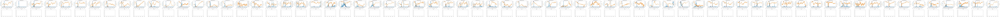

In [15]:
#re-do slicing of sst as well for the long events
sst_event_list_long = sst_rain_response(rain_event_list = rain_event_list_long,
                                        sst = kt_seatemp_1min,
                                        pre_onset_averaging = pre_onset_averaging)

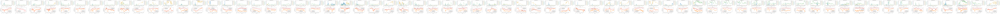

In [16]:
#new version of the plot_rain_events function that includes wind stress, solar insolation, and all sea temps

#initialize figure to plot into based on how many rain events we have
figlength = 6*len(rain_event_list_long)
fig, axx = plt.subplots(nrows=2, ncols=len(rain_event_list_long),facecolor='w',figsize=(figlength,6))

rain_ylims = [0,125]


for event_num in np.arange(0,len(rain_event_list_long)):

    start = pd.to_datetime(rain_event_list_long[event_num].attrs['Rain Onset'])
    end = pd.to_datetime(rain_event_list_long[event_num].attrs['Rain End'])

    #-----TOP PLOT: Wind Stress, Rain Rate & Solar Insolation----
    #precip rate
    rain_event_list_long[event_num].P.plot.line(ax=axx[0,event_num],fillstyle=None)
    axx[0,event_num].set_ylabel('Rain Rate [mm/hr]',color='C0')
    axx[0,event_num].set_ylim(rain_ylims)
    #solar flux
    ax11 = axx[0,event_num].twinx()
    ax11.plot(-rain_event_list_long[event_num].Solardn,color='goldenrod')
    ax11.set_ylabel('Downwelling SW [W/m^2]', color='goldenrod')
    ax11.set_ylim([0,1200])
    #wind stress
    ax1 = axx[0,event_num].twinx()
    offset = 50
    ax1.spines['right'].set_position(('outward',offset))
    rain_event_list_long[event_num].stress.plot.line(color='green',ax=ax1,fillstyle=None,alpha=0.5,zorder=0)
    ax1.set_ylabel('Wind Stress [N/m^2]',color='green')
    ax1.set_ylim([0,0.5])

    #----BOTTOM PLOT: SST & Other Temps-------
    #plot SST
    ax2 = axx[1,event_num]
    ax2.plot(sst_event_list_long[event_num].sst,'C1')    
    #plot sea snake temp
    rain_event_list_long[event_num].Tsea.plot.line('red',ax=ax2,fillstyle=None)
    #plot TSG temp
    rain_event_list_long[event_num].TseaTSG.plot.line('maroon',ax=ax2,fillstyle=None)
    #legend
    ax2.legend(['Surface (KT-15)','10cm (Sea Snake)','Bulk (Ship TSG)'])
    ax2.set_ylabel('Temperature [$^\circ$C]',color='k')
    
    #title
    axx[0,event_num].set_title(f'Rain Event # {event_num+1}')
    
plt.tight_layout()

plt.savefig('./Figures/Dynamo Rain Events + Ocean Temps + SW + Wind Stress v1.png')

By inspection, find events that show the surface warming effect:


In [17]:
12,

(12,)

NameError: name 'kt_skytemp_1min' is not defined

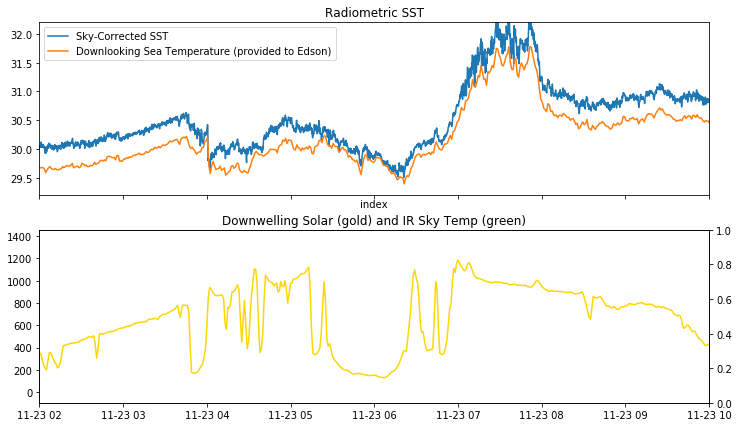

In [18]:
fig,axx = plt.subplots(nrows = 2, figsize=(12,7),facecolor='w', sharex=True)
start = pd.datetime(2011,11,23,2,0,0)
end = pd.datetime(2011,11,23,10,0,0)

kt_1m.plot(ax=axx[0])
kt_seatemp_1min.plot(ax=axx[0])
axx[0].set_xlim([start,end])
axx[0].set_ylim([29.2, 32.2])
axx[0].legend(['Sky-Corrected SST','Downlooking Sea Temperature (provided to Edson)'])
axx[0].set_title('Radiometric SST')

axx[1].plot(-rv.Solardn,color='gold')
axx[1].set_title('Downwelling Solar (gold) and IR Sky Temp (green)')
par = axx[1].twinx()
kt_skytemp_1min.plot(ax=par,color='green')
par.set_xlim([start,end])
par.set_ylim([0,50])

plt.savefig('./Figures/Nov 23 Event Investigation v2.png')

In [99]:
all_events['index']

0      -0.4
1      -0.2
2       0.0
3       0.2
4       0.4
5       0.6
6       0.8
7       1.0
8       1.2
9       1.4
10      0.0
11      0.2
12      0.4
13      0.6
14      0.8
15      1.0
16      1.2
17     -0.6
18     -0.4
19     -0.2
20      0.0
21      0.2
22      0.4
23      0.6
24      0.8
25      1.0
26      1.2
27      1.4
28      1.6
29      1.8
       ... 
1046    0.4
1047    0.6
1048    0.8
1049    1.0
1050    1.2
1051    1.4
1052    1.6
1053    1.8
1054    2.0
1055    2.2
1056    2.4
1057   -0.2
1058    0.0
1059    0.2
1060    0.4
1061    0.6
1062    0.8
1063    1.0
1064    1.2
1065    1.4
1066   -0.4
1067   -0.2
1068    0.0
1069    0.2
1070    0.4
1071    0.6
1072    0.8
1073    1.0
1074    1.2
1075    1.4
Name: index, Length: 1076, dtype: float64

In [97]:
composite_event.sel(event=event_num).to_dataframe().rename({'index':'timescale'})

,event,δsst,δTsea,δTseaTSG,δSalTSG,δT02,δT10,δU10,δPrecip,δrhf
index,,,,,,,,,,
-2.0,68,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
-1.8,68,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
-1.6,68,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
-1.4,68,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
-1.2,68,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
-1.0,68,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
-0.8,68,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
-0.6,68,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
-0.4,68,0.009004,0.034175,-0.000748,-0.000086,0.019221,0.017343,0.083221,0.000000,0.000000


In [52]:
#create a new series 

#fig,axx=plt.subplots(figsize=(8,8),facecolor='w')
#axx.plot(composite_event.sel(event=1).δPrecip, composite_event.sel(event=1).δsst,'.')



### Break up the composite events by MJO Phase??

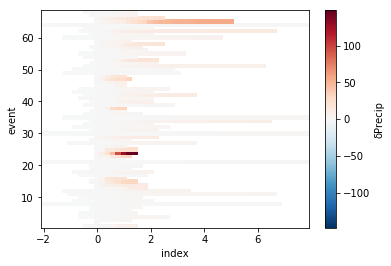

In [29]:
#just saving the original plotting for the first 4 variables I calculated as a composite event

#plot
fig,axx= plt.subplots(nrows=4,ncols=1,figsize=(8,12),facecolor='w')
ticks = np.arange(start,stop+1,1)
ticklabels = ticks.astype('str').tolist()
ticklabels[-start] = 'Onset'
ticklabels[-start + 1] = r'$ \delta SST_{max} $'
plt.suptitle('DYNAMO Rain Events', y=0.999999)

#Subplot 0: Air Temp
axx[0].plot(resample_coords, np.zeros(len(resample_coords)),linewidth = 0.5, zorder=0)
axx[0].errorbar(x=resample_coords, y=means.δT02, yerr=stds.δT02, fmt='-k', ecolor='k', linewidth=0.5, capsize=10*spacing, zorder=100)
axx[0].scatter(x=resample_coords, y=means.δT02, s=sizes, c='tomato',zorder=200)
axx[0].set_xlim([resample_coords[0],resample_coords[-1]])
axx[0].set_xticks(ticks)
axx[0].set_xticklabels(ticklabels)
axx[0].set_xlabel(r'Normalized Time $ (t-t_{onset})/t_{δSST_{max}}$')
axx[0].set_ylabel('$\delta T_{air} (^\circ C)$')
axx[0].set_title('Air Temperature')

#Subplot 1: δSST
axx[1].plot(resample_coords, np.zeros(len(resample_coords)),linewidth = 0.5, zorder=0)
axx[1].errorbar(x=resample_coords, y=means.δsst, yerr=stds.δsst, fmt='-k', ecolor='k', linewidth=0.5, capsize=10*spacing, zorder=100)
axx[1].scatter(x=resample_coords, y=means.δsst, s=sizes, c='red',zorder=200)
axx[1].set_xlim([resample_coords[0],resample_coords[-1]])
axx[1].set_xticks(ticks)
axx[1].set_xticklabels(ticklabels)
axx[1].set_xlabel(r'Normalized Time $ (t-t_{onset})/t_{δSST_{max}}$')
axx[1].set_ylabel('δSST ($^\circ C$)')
axx[1].set_title('SST')

#Subplot 2: δT_bulk (sea snake)
axx[2].plot(resample_coords, np.zeros(len(resample_coords)),linewidth = 0.5, zorder=0)
axx[2].errorbar(x=resample_coords, y=means.δTsea, yerr=stds.δTsea, fmt='-k', ecolor='k', linewidth=0.5, capsize=10*spacing, zorder=100)
axx[2].scatter(x=resample_coords, y=means.δTsea, s=sizes, c='darkred',zorder=200)
axx[2].set_xlim([resample_coords[0],resample_coords[-1]])
axx[2].set_xticks(ticks)
axx[2].set_xticklabels(ticklabels)
axx[2].set_xlabel(r'Normalized Time $ (t-t_{onset})/t_{δSST_{max}}$')
axx[2].set_ylabel('$\delta T_{bulk} (^\circ C)$')
axx[2].set_title('Bulk Sea Temperature (Sea Snake)')

#Subplot 3: Bulk Salinity
axx[3].plot(resample_coords, np.zeros(len(resample_coords)),linewidth = 0.5, zorder=0)
axx[3].errorbar(x=resample_coords, y=means.δSalTSG, yerr=stds.δSalTSG, fmt='-k', ecolor='k', linewidth=0.5, capsize=10*spacing, zorder=100)
axx[3].scatter(x=resample_coords, y=means.δSalTSG, s=sizes, c='blue',zorder=200)
axx[3].set_xlim([resample_coords[0],resample_coords[-1]])
axx[3].set_xticks(ticks)
axx[3].set_xticklabels(ticklabels)
axx[3].set_xlabel(r'Normalized Time $ (t-t_{onset})/t_{δSST_{max}}$')
axx[3].set_ylabel('$\delta S_{bulk} (psu)$')
axx[3].set_title('Bulk Salinity (Ship TSG)')

In [4]:
kt_all = kt_dynamo.rolling({index:1000}).mean()
kt_all

NameError: name 'index' is not defined

In [ ]:
plt.figure(figsize=(36,12),facecolor='w')

kt_dynamo.SeaTemp_Cal.rolling({'index':1000}).mean().plot()
kt_dynamo.SST.rolling({'index':1000}).mean().plot()

plt.gca().set_xlim([pd.datetime(2011,11,9),pd.datetime(2011,12,9)])
plt.gca().set_ylim([28,33])
plt.gca().set_ylabel('Temperature (C)')

plt.legend(['Calibrated Sea Temp','Sky-Corrected SST'])
plt.savefig('./Figures/KT15_skycorrected_vs_seatemp.png')

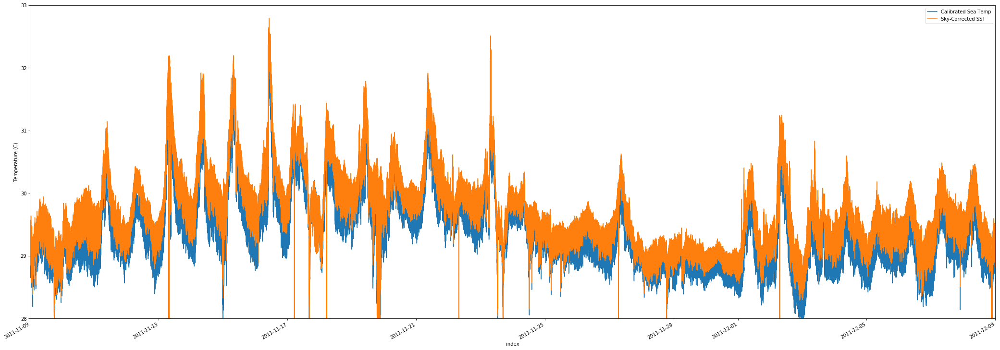

In [40]:
plt.figure(figsize=(36,12),facecolor='w')

kt_dynamo.SeaTemp_Cal.plot()
kt_dynamo.SST.plot()

plt.gca().set_xlim([pd.datetime(2011,11,9),pd.datetime(2011,12,9)])
plt.gca().set_ylim([28,33])
plt.gca().set_ylabel('Temperature (C)')

plt.legend(['Calibrated Sea Temp','Sky-Corrected SST'])

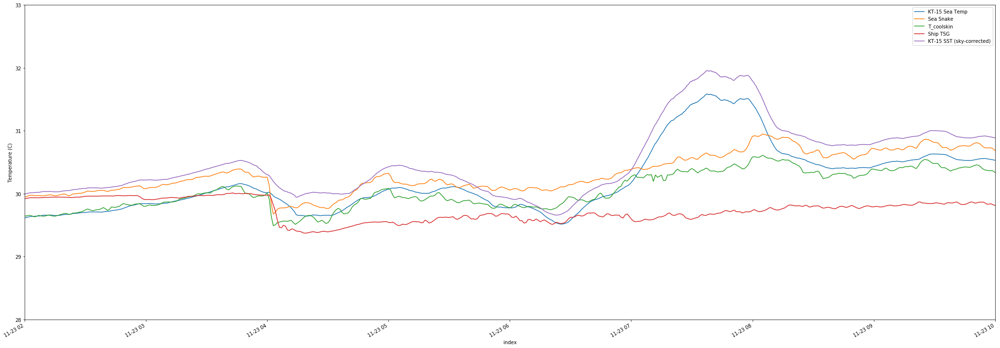

In [6]:
plt.figure(figsize=(36,12),facecolor='w')
start = pd.datetime(2011,11,23,2,0,0)
end = pd.datetime(2011,11,23,10,0,0)

h1 = kt_dynamo.SeaTemp_Cal.rolling({'index':1000}).mean().plot()
h2 = rv.Tsea.plot()
h3 = rv.SST.plot()
h4 = rv.TseaTSG.plot()
h5 = kt_dynamo.SST.rolling({'index':1000}).mean().plot()
plt.gca().set_xlim([start, end])
plt.gca().set_ylim([28,33])
plt.gca().set_ylabel('Temperature (C)')

plt.legend(['KT-15 Sea Temp','Sea Snake','T_coolskin','Ship TSG', 'KT-15 SST (sky-corrected)'])

#plt.savefig('./Figures/Dynamo_KT15_vs_SeaSnake_comparison_SeaTemp.png')

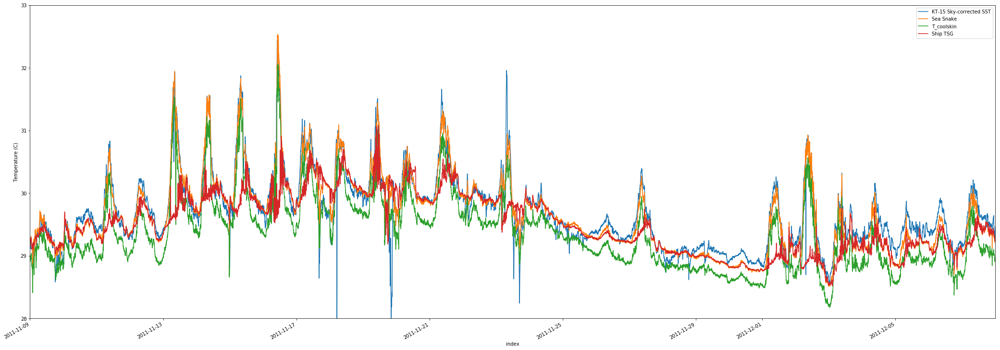

In [48]:
plt.figure(figsize=(36,12),facecolor='w')

h1 = kt_dynamo.SST.rolling({'index':1000}).mean().plot()
h2 = rv.Tsea.plot()
h3 = rv.SST.plot()
h4 = rv.TseaTSG.plot()
plt.gca().set_xlim([pd.datetime(2011,11,9),pd.datetime(2011,12,8)])
plt.gca().set_ylim([28,33])
plt.gca().set_ylabel('Temperature (C)')

plt.legend(['KT-15 Sky-corrected SST','Sea Snake','T_coolskin','Ship TSG'])

plt.savefig('./Figures/Dynamo_KT15_vs_SeaSnake_comparison_SkyCorrectedSST.png')

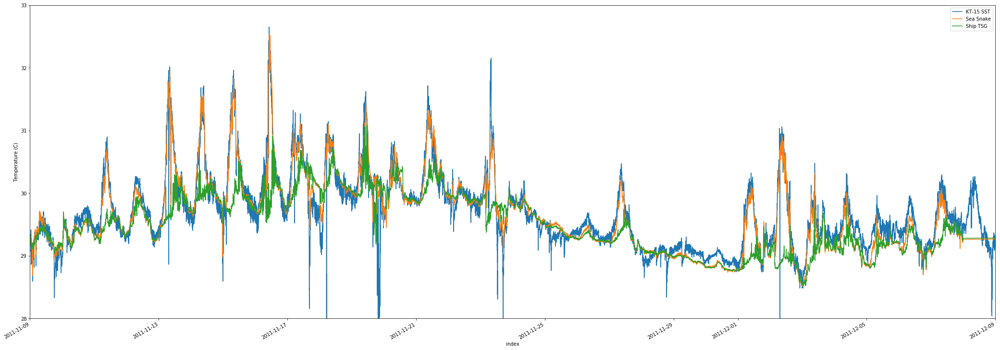

In [38]:
plt.figure(figsize=(36,12),facecolor='w')

h1 = kt_1m.rolling({'index':10}).mean().plot()
h2 = rv.Tsea.plot()
#h3 = rv.SST.plot()
h4 = rv.TseaTSG.plot()
plt.gca().set_xlim([pd.datetime(2011,11,9),pd.datetime(2011,12,9)])
plt.gca().set_ylim([28,33])
plt.gca().set_ylabel('Temperature (C)')

plt.legend(['KT-15 SST','Sea Snake','Ship TSG'])

#plt.savefig('./Figures/Dynamo_KT15_vs_SeaSnake_comparison_v2.png')

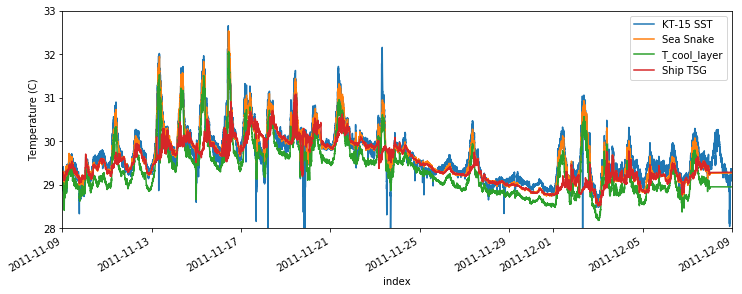

In [36]:
plt.figure(figsize=(12,4),facecolor='w')

h1 = kt_1m.rolling({'index':10}).mean().plot()
h2 = rv.Tsea.plot()
h3 = rv.SST.plot()
h4 = rv.TseaTSG.plot()
plt.gca().set_xlim([pd.datetime(2011,11,9),pd.datetime(2011,12,9)])
plt.gca().set_ylim([28,33])
plt.gca().set_ylabel('Temperature (C)')

plt.legend(['KT-15 SST','Sea Snake','T_cool_layer','Ship TSG'])

plt.savefig('./Figures/Dynamo_KT15_vs_SeaSnake_comparison_v2.png')

## Section 2: Process Study from Falkor Rain Events

There were 4 rain events over the two Falkor cruises that meet the criteria established in the Dynamo rain processing. 2 from 2016, and 2 events from 2019. We have more different types of observations of these events, but they also need to be pieced together.

### Rain Event Detection from Catamaran Rain Sensor

#### Falkor 2016:

Import data from catamaran, including precipitation:

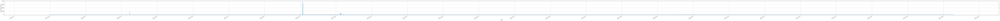

In [75]:
#import rain data
cat_datapath = '../Data/Level_3/Falkor16/Catamaran/catamaran_fk16_alldata.cdf'

cat = xr.open_dataset(cat_datapath)
plt.subplots(figsize=(200,3),facecolor='w')
cat.P.plot()
plt.gca().xaxis.set_major_locator(mdates.DayLocator(interval=1))   #to get a tick every day minutes
plt.grid()

Slice every separate rain event out first (defined as being at least *'min_duration'* long, with a peak rainfall rate of at least *'threshold'*, and surrounded by at least *'min_separation'* minutes of zero precipitation). Then examine the plots of all rain events to tune parameters and identify any that should be removed...

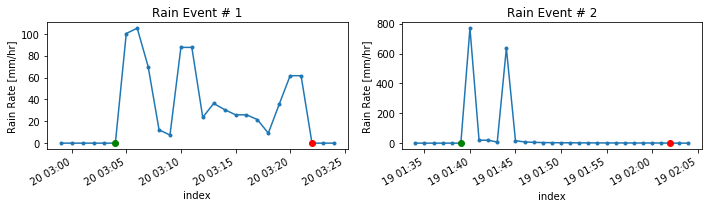

In [76]:
from RainEvent_Toolbox import find_rain_events
rain_event_list = find_rain_events(dataset = cat, 
                                   min_duration = 10,
                                   min_separation = 10,
                                   threshold = 10,
                                   noise_floor = 0.5,
                                   front_pad = 5, 
                                   end_pad = 3)
plt.savefig('./Figures/Falkor 2016 Rain Event Detection v1.png')

Now slice out SST data for each event and calculate relevant parameters:

In [11]:
#import SST data
kt_falkor16 = xr.open_dataset('../Data/Level_3/Falkor16/KT15/Falkor16_KT15_CalibratedSST.cdf').rename(DateTime='index')
#resample SST to 10 seconds
kt_1m = kt_falkor16.sortby(kt_falkor16.index).SST.resample(index='10s').mean()
#how many minutes before rain onset do we want to average as the baseline from which to calculate a delta?
pre_onset_averaging = 3

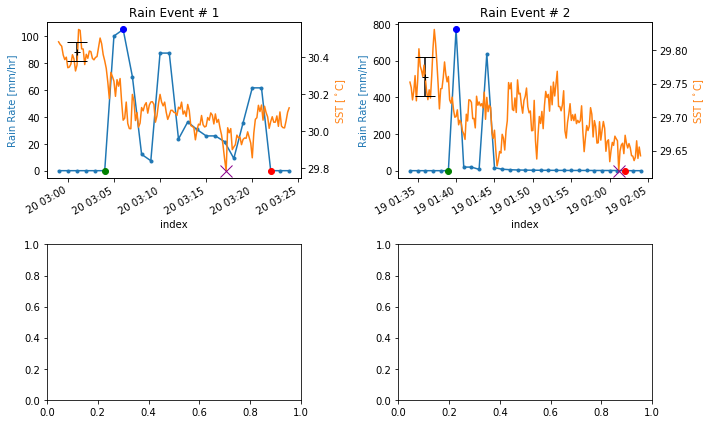

In [12]:
from RainEvent_Toolbox import sst_rain_response
sst_event_list = sst_rain_response(rain_event_list = rain_event_list,
                                   sst = kt_1m,
                                   pre_onset_averaging = pre_onset_averaging)
plt.savefig('./Figures/Falkor 2016 Rain Events + SST.png')

So there are 2 rain events from Falkor 2016 that fit the parameters established for the Dynamo dataset. These could be used as part of the process study side of things. We do have both imagery types for the October 20th event, but only Mitie for the October 19 (the polarimetry failed to record during that specific 20 minutes of rainfall). The October 20th event is the one from the 2018 JGR paper. 

#### Falkor 2019

Things get a little bit funky with this one because there are multiple data entries for individual timestamps. I haven't been able to figure out how to get rid of that (resampling is behaving very strangely, yielding all nans) so I'm just doing it manually here.

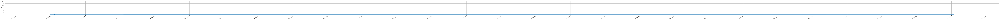

In [8]:
#import rain data
cat_datapath19 = '../Data/Level_3/Falkor19/Catamaran/catamaran_fk19_alldata.cdf'

cat19 = xr.open_dataset(cat_datapath19)#.resample(index='1s').mean()
plt.subplots(figsize=(200,3),facecolor='w')
cat19.P.plot()
plt.gca().xaxis.set_major_locator(mdates.DayLocator(interval=1))   #to get a tick every day
plt.grid()

Slice every separate rain event out first (defined as being at least *'min_duration'* long, with a peak rainfall rate of at least *'threshold'*, and surrounded by at least *'min_separation'* minutes of zero precipitation). Then examine the plots of all rain events to tune parameters and identify any that should be removed...

In [9]:
dataset = cat19
min_duration = 10
min_separation = 10
threshold = 10
noise_floor = 0.5
front_pad = 5
end_pad = 3

rain_rate = dataset.P
rain_event_list = []
rain_event_counter = 0
timestep = 0
while timestep < len(rain_rate):
    #if the current rain rate isn't zero:
    if (rain_rate.isel(index=timestep).values > noise_floor):
        #then we've got ourselves the start of a rain event!
        rain_start = timestep-1 #preceding zero value is the start, for consistency with Deb's approach
        raining = True
        #enter a new loop that finds the end index of this rain event
        while raining:
            #if the current rain rate is zero...AND...it's going to be zero from now until 'min_separation' from now:
            if (rain_rate.isel(index=timestep).values <= noise_floor and
                np.mean(rain_rate.isel(index=slice(timestep,timestep+min_separation)).values) <= noise_floor):
                    #then we've located the end of the rain event
                    rain_end = timestep
                    raining = False
                    #create new dataarray containing solely this rain event, plus some extra timesteps on either side
                    rainevent = dataset.isel(index=slice(rain_start-front_pad,rain_end+end_pad))
                    #calculate peak rainfall rate - if you encounter any issues, set the rate to zero
                    try:
                        peak_rate = dataset.isel(index=slice(rain_start,rain_end)).P.max().values.item()
                    except ValueError:
                        peak_rate = 0
                    #check if the peak of the rain event exceeds 'threshold' and the rain event is long enough
                    if (peak_rate >= threshold and (rain_end - rain_start) >= min_duration):
                        #if so, fill out metadata and add this to the master list of rain events
                        rain_event_counter = rain_event_counter + 1
                        rainevent.attrs['Rain Event #'] = rain_event_counter
                        rainevent.attrs['Rain Onset'] = rain_rate.isel(index=rain_start).index.values
                        rainevent.attrs['Rain End'] = rain_rate.isel(index=rain_end).index.values
                        rainevent.attrs['Peak Rate'] = peak_rate
                        rainevent.attrs['Peak Time'] = rainevent.P.where(rainevent.P==peak_rate,drop=True).index.values[0]
                        rain_event_list.append(rainevent)
                        #(if not, just discard and move on)
            #as long as it keeps raining, just increment the timestep and start over
            else:
                timestep = timestep + 1
        #[spits us out at the timestep after the event ends]
    #if we haven't found a rain event, just increment the timestep and start over
    else:
        timestep = timestep + 1
len(rain_event_list)


3

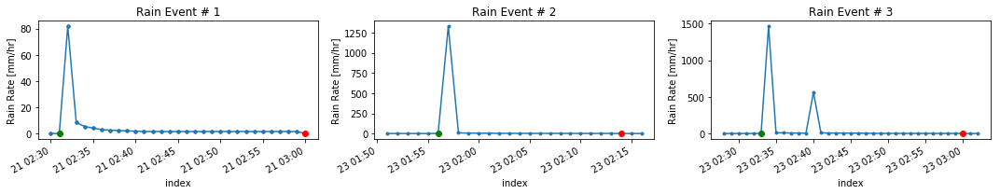

In [10]:
figlength = 5*len(rain_event_list)
fig, axx = plt.subplots(nrows=1, ncols=len(rain_event_list),facecolor='w',figsize=(figlength,3))

for event_num in np.arange(0,len(rain_event_list)):
    rain_event_list[event_num].P.plot.line('-o',ax=axx[event_num],markersize=3,fillstyle=None)
    axx[event_num].set_title(f'Rain Event # {event_num+1}')
    start = rain_event_list[event_num].attrs['Rain Onset']
    axx[event_num].plot(start,rain_event_list[event_num].P.sel(index=start).mean(),'.g',markersize=12,fillstyle=None)
    end = rain_event_list[event_num].attrs['Rain End']
    axx[event_num].plot(end,rain_event_list[event_num].P.sel(index=end).mean(),'.r',markersize=12,fillstyle=None)
plt.tight_layout()
plt.savefig('./Figures/Falkor 2019 Rain Event Detection v2.png')

Now slice out SST data for each event and calculate relevant parameters:

In [13]:
#import SST data
kt_falkor19 = xr.open_dataset('../Data/Level_3/Falkor19/KT15/Falkor19_KT15_CalibratedSST_v2.cdf').rename(DateTime='index')
#resample SST to 10 seconds
kt_1m = kt_falkor19.sortby(kt_falkor19.index).SST.resample(index='10s').mean()
#how many minutes before rain onset do we want to average as the baseline from which to calculate a delta?
pre_onset_averaging = 3

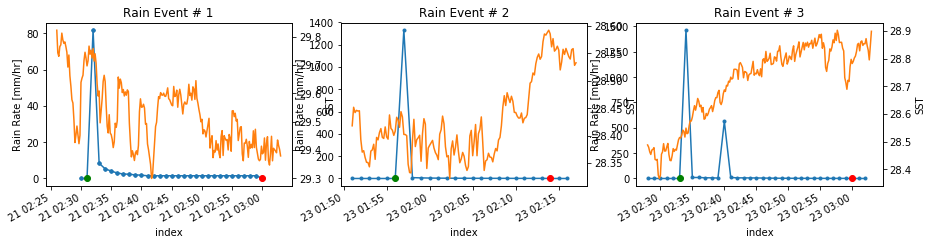

In [14]:
#from RainEvent_Toolbox import sst_rain_response
#sst_event_list = sst_rain_response(rain_event_list = rain_event_list,
#                                   sst = kt_1m,
#                                   pre_onset_averaging = pre_onset_averaging)

figlength = 5*len(rain_event_list)
fig, axx = plt.subplots(nrows=1, ncols=len(rain_event_list),facecolor='w',figsize=(figlength,3))


for event_num in np.arange(0,len(rain_event_list)):
    rain_event_list[event_num].P.plot.line('-o',ax=axx[event_num],markersize=3,fillstyle=None)
    axx[event_num].set_title(f'Rain Event # {event_num+1}')
    start = rain_event_list[event_num].attrs['Rain Onset']
    axx[event_num].plot(start,rain_event_list[event_num].P.sel(index=start).mean(),'.g',markersize=12,fillstyle=None)
    end = rain_event_list[event_num].attrs['Rain End']
    axx[event_num].plot(end,rain_event_list[event_num].P.sel(index=end).mean(),'.r',markersize=12,fillstyle=None)
    #axx[event_num].set_xlim([start,end])
    
    ax2 = axx[event_num].twinx()
    kt_1m.sel(index=slice(start-pd.Timedelta('5min'),end+pd.Timedelta('3min'))).plot(ax=ax2,color='C1')
    

plt.savefig('./Figures/Falkor 2019 Rain Events + SST v2.png')

Coverage notes:

- SPIP was in the water to witness both of these events. The 21st corresponds to SPIP deployment 2, while the 23rd corresponds to SPIP deployment 4.
- The 21st has mitie coverage from 2:27 - 2:47am, perfect for that rain event. The 23rd has Mitie coverage from 1:50-2:10 (perfect for rain event 2) and 2:50-3:10 (less useful for rain event 3)

There was also another rain event observed by SPIP on the 22nd after the catamaran was pulled, where a freshwater lens formed !! . Here is the SPIP plot, and a plot of the SST:

![Dep2RainSPIP](./Figures/SPIP_SummaryPlot_deployment2_RainEvent.png)

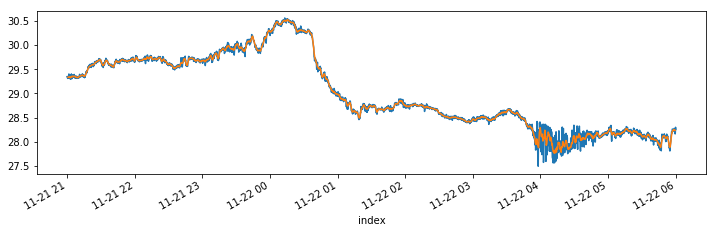

In [29]:
plt.figure(figsize=(12,3),facecolor='w')
kt_1m.loc['2019-11-21 21:00:00':'2019-11-22 6:00:00'].plot()
kt_1m.loc['2019-11-21 21:00:00':'2019-11-22 6:00:00'].rolling(index=10,center=True).mean().plot()

Timeline of events _At SPIP's location_: 
1. Winds pick up around 00:30, destroying the DWL and likely leading to the sudden decrease in SST measured by the KT-15s. 
2. Light rain begins around 01:15, and SPIP observes a cold surface layer (likely due to the heat flux associated with the wind increase). 
3. **Mitie was recording from 03:27-03:47**. Then from 03:45-04:00, the rain rate increases greatly and a cold freshwater lens develops in the upper ~1.5m. We see that reflected in the KT15 data as well, a significant drop in the same time period. 
4. Unfortunately SPIP was pulled shortly after 4:00, but the KT15 data does suggest that the rain event continued for less than an hour. Perhaps we could use ship met data to corroborate the story of the storm passing. The Mitie makes observations again from 04:27-04:47, so that could also give us insight into the tail end of the event. 

# NEXT STEPS
- Lit review of Dynamo, SPURS, anything else about Ocean Surface Response to Rain
- Sketch out outline of paper 
    - Figures:
        - Example rain event
        - Characterizing the dataset with histograms
        - Relationships between key variables
        - Composite event
    - Introduction includes references to Falkor rain event imagery and processes from Wurl et al 2018 JGR and Laxague+Zappa 2020 GRL.

# Appendices

## Appendix 0: Review of datasets

## Dynamo 
### Variable Names

$\Delta SST_{skin}$ - departure of skin temperature (KT15) from 3-minute mean prior to rain onset

$t_{*SST}$ - time from rain onset to maximum SST response (maximum $\Delta SST_{skin}$)

$L_{rain}$ - length of rain event

$t_{*rain}$ - time from rain onset to peak rain rate

### Overview of DYNAMO dataset

The figure below shows a series of histograms of relevant variables for each of the 103 identified rain events on DYNAMO.
The events are largely ~1hr long and deposit ~15mm rain, with only a few very long events (>10hrs). The mean $\Delta SST_{skin}$ due to rain is $-0.51 ^\circ C$.

![Histograms](./Figures/Histograms v1.png)


### Relationships between variables

The figure below attempts to relate both the maximum skin temperature deviation ($\Delta SST_{skin}$) and the time between rain onset and maxiumum skin temperature deviation ($t_{*SST}$) to other relevant parameters.
![Scatterplots](./Figures/Scatterplots v1.png)

The relationship between $t_{*rain}$ and $t_{*SST}$ looks fairly robust and close to 1:1 (red line). It makes some intuitive sense that the time period of the largest rain rate would tend to correspond to the time period of the largest SST deviation.

The other relationship that may have some legs is between $L_{rain}$ vs. $t_{*SST}$. However, this correspondence may just reflect the agreement between $t_{*rain}$ and $t_{*SST}$, in that longer rain events may tend to take longer to reach their maximum rain rate. **Plot $L_{rain}$ vs. $t_{*rain}$ and verify.** 

### Normalized timeseries of temperature deviation

The figure below shows a bin-averaged timeseries of all 103 rain events, where rain onset for each event corresponds to T=0, and the timescale of the event is normalized by $t_{*SST}$, the time it takes to reach the maximum SST deviation. This means that the maximum $\Delta SST_{skin}$ always occurs at T=1. 

![Timeseries](./Figures/Timeseries_v1.png)

It would seem to make more sense to **normalize the timescale in this figure by $t_{*rain}$ rather than $t_{*SST}$**, especially given the good correspondence between the two.

The **locations of the bins** also seem arbitrary and poorly chosen, as there is no bin centered on 0 or 1, the two most important parts of the timescale. 

There is very close temporal alignment of the trends in $\Delta SST_{skin}$, $\Delta T_{bulk}$, and $\Delta T_{air}$, with the drop in SST about double the drop in bulk water temperature. It is interesting that there is no time lag between the trends in SST and bulk temperature - likely due to some combination of these two factors:
    - insufficient temporal resolution between bins to see the delay
    - downward mixing occuring on sufficiently short timescales
    
**Come up with something other than the symbol delta to characterize these anomalies.**


#### Deb's scripts:
*SST_rain_comparison_ID_rainpeaks.m*    does the basic peak detection and collates met data from Edson.

*SST_rain_comparison_bin_average_interim.m*   plots some histograms and scatterplots

*SST_rain_comparison_with_anomaly.m*    Collates variables into structure Var

*SST_rain_comparison_peak_response.m*   Adds times to max SST response, time to recover, etc.

*SST_rain_comparison_bin_average_more.m*  bin averages to create composite event - scales to beginning of event, and produces unscaled time as well (want scaled!)

*SST_rain_comparison_bin_average_long_short.m*   bin averages to create
composite but selects out long events

From Deb's peak detection algorithm:" A point is considered a maximum peak if it has the maximal
value, and was preceded (to the left) by a value lower by DELTA." Minimum peak rainfall rate to be considered an 'event' was 45mm/hr. No minimum time set by Deb.

## Overview of Falkor Dataset(s)

There is a major challenge in extending the rigor of the DYNAMO processing to the Falkor datasets:  **there was no rain sensor onboard the ship.** In 2016, the catamaran had a rain sensor, and in 2019, the SPIP had a rain sensor, but this limits us to rain events in which SPIP or Cat were in the waterfor the entire duration of the event. There are only 5 rain events recorded by SPIP in 2019 from start to end, and they are all extremely mild rain rates. 

However, there is another event from which we can get some really interesting information. On November 22, 2019, SPIP captured the process of a diurnal warm layer breaking down in the presence of an oncoming rain event, followed by the development of a cold freshwater lens on the surface in response to increased rainfall and decreasing wind forcing:

![Dep2RainSPIP](./Figures/SPIP_SummaryPlot_deployment2_RainEvent.png)

**Calculate a dilution rate from this**

#### Mitie and KT15 data
**A key thing to account for when comparing SPIP data to shipboard observations is the potential separation between them. I will need to make a map of their tracks during the time periods of interest.**

The Mitie was recording 20 minutes of every hour, so during this rain event it recorded from 03:27 - 03:47. A screenshot of the Mitie at 3:47 is shown below:

![MitieS2Screengrab](./Figures/Mitie_s2_screenshot1.png)

Let's take a look at this event as recorded by the KT-15s:
**Zappa can you provide the reference for the sky-correction algorithm?**

In [1]:
import numpy as np
import pandas as pd
import glob
from matplotlib import pyplot as plt
%matplotlib inline

In [4]:
#import a KT15 labview data file:
kt = pd.read_csv('../Data/Working/Falkor19/KT15/2019_Falkor_325_043435.txt',                                   #filename to read in
                 delimiter='\s+', skiprows=1, header=None,                                                     #treat whitespace as the delimeter, ignore the header line
                 usecols=[0,1,2,3,4,5], names=['Date','Time','SeaRef','SeaTemp','SkyRef','SkyTemp'],           #use the first 6 columns, and name them as specified
                 parse_dates={'DateTime':[0,1]}, index_col=0,                                                  #parse the first two columns as a single DateTime, and make it the index column
                 na_values=['AMB'],                                                                            #list of other things the parser might encounter in these files, that should be treated like NaNs
                 dtype={'SeaRef':np.float64, 'SeaTemp':np.float64, 'SkyRef':np.float64, 'SkyTemp':np.float64}, #explicitly specify that data columns must be 64-bit floating point numbers
                 error_bad_lines=False, warn_bad_lines=True)                                                   #if there is a bad line in the data file, drop it from the file and show a warning, but continue parsing
kt.dropna(axis='index',how='any',inplace=True)                                                                 #drop any rows that have a NaN value in them
kt.head()

,SeaRef,SeaTemp,SkyRef,SkyTemp
DateTime,,,,
2019-11-21 04:34:36.153,31.51,27.94,31.69,22.40
2019-11-21 04:34:36.953,31.51,27.98,31.69,22.38
2019-11-21 04:34:37.754,31.51,27.90,31.69,22.31
2019-11-21 04:34:38.554,31.51,27.92,31.69,22.33
2019-11-21 04:34:39.354,31.51,27.94,31.69,22.31


In [7]:
#apply sky correction - what is the source for these coefficients?
K0u = -1.9151
K1u = 0.041767
K2u = -0.00033291
K3u = 1.0715e-06
K4u = -8.651e-10
K5u = K6u = K7u = K8u = 0 

K0d = -82.135
K1d = 2.293
K2d = -0.020287
K3d = 6.7301e-05
K4d = -5.2395e-08
K5d = K6d = K7d = K8d = 0

y0 = 136.33
A = 20.927
power = 0.40045

RadTempSKY = kt.SkyTemp + 273.16
RadTempSEA = kt.SeaTemp + 273.16
ReflectedSkyRad = K0u + K1u*RadTempSKY + K2u*RadTempSKY**2 + K3u*RadTempSKY**3 + K4u*RadTempSKY**4 + K5u*RadTempSKY**5 + K6u*RadTempSKY**6 + K7u*RadTempSKY**7 + K8u*RadTempSKY**8
TotalRad = K0d + K1d*RadTempSEA + K2d*RadTempSEA**2 + K3d*RadTempSEA**3 + K4d*RadTempSEA**4 + K5d*RadTempSEA**5 + K6d*RadTempSEA**6 + K7d*RadTempSEA**7 + K8d*RadTempSEA**8
SSTRad = TotalRad - ReflectedSkyRad
kt['SST_nocal'] = y0 + A*(SSTRad)**power - 273.16

We'll plot the KT-15 SST (sky-corrected, but not yet blackbody calibrated) for the time period of the SPIP deployment (plus a little extra at the end):

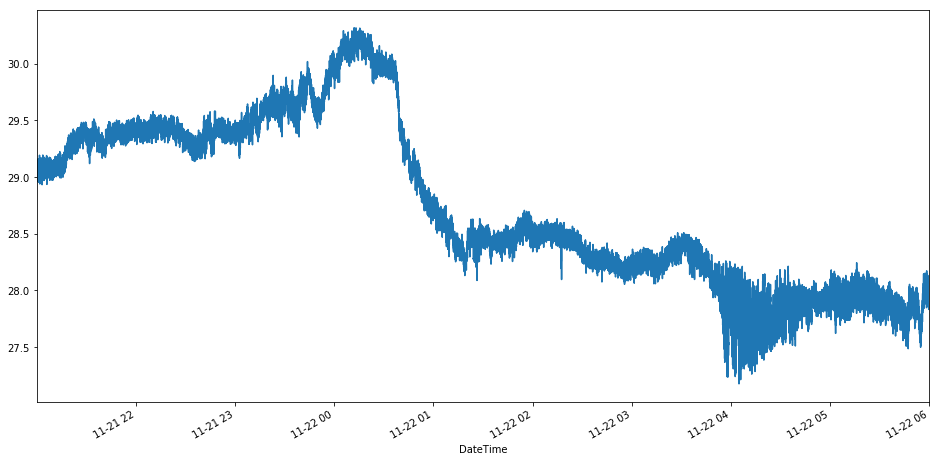

In [16]:
kt.SST_nocal.loc['2019-11-21 21:00:00':'2019-11-22 6:00:00'].plot(figsize=(16,8))

Tought to look at a timeseries of this length with the full sub-second resolution. Let's apply a centered rolling mean to tease out the longer-term trends:

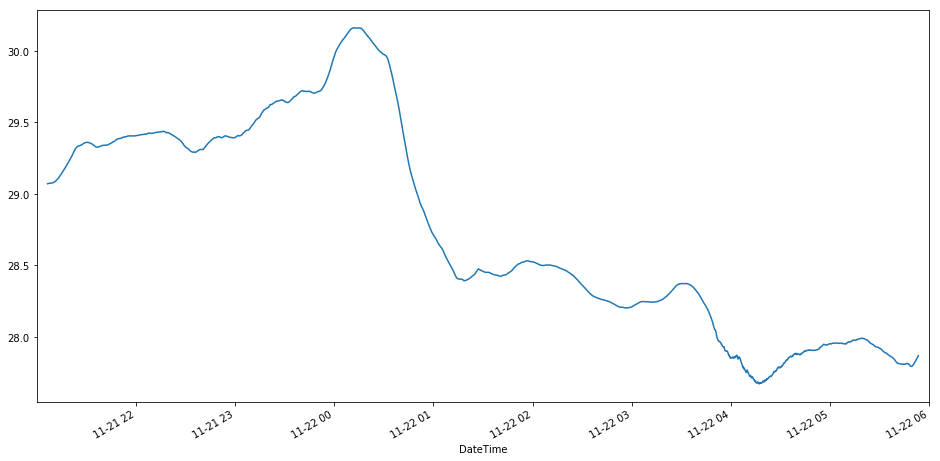

In [17]:
kt.SST_nocal.loc['2019-11-21 21:00:00':'2019-11-22 6:00:00'].rolling(1000,center=True).mean().plot(figsize=(16,8))

Timeline of events _At SPIP's location_: 
1. Winds pick up around 00:30, destroying the DWL and likely leading to the sudden decrease in SST measured by the KT-15s. 
2. Light rain begins around 01:15, and SPIP observes a cold surface layer (likely due to the heat flux associated with the wind increase). 
3. Then from 03:45-04:00, the rain rate increases greatly and a cold freshwater lens develops in the upper ~1.5m. We see that reflected in the KT15 data as well, a significant drop in the same time period. 
4. Unfortunately SPIP was pulled shortly after 4:00, but the KT15 data does suggest that the rain event did not last much longer than that. Perhaps we could use ship met data to corroborate the story of the storm passing. The Mitie makes observations again from 04:27-04:47, so that could also give us insight into the tail end of the event. 

**note that the ship was maneuvering throughout this entire event, we will have to be very careful about that**

**Do the same treatment as Dynamo for Falkor16+19 rain events (piece together rain onset times from public cat data)**

Read BAMS article (Chen & Moum) about DYNAMO and Laxague+Zappa article about rain event from 2016.

Should also refer to some SPURS work - Zappa to find

Katsaros 198X paper shows exactly how to generate the sky correction coefficients. Zappa 1998 Appendix also talks about this.

Add 9-11um instrument to toolbox (once Zappa finds igor function)

### Literature Review: 
- Chen & Moum BAMS dynamo summary paper
- Simon P. de Szoeke Dynamo Paper (https://journals.ametsoc.org/doi/full/10.1175/JCLI-D-14-00477.1)
- Big Dynamo paper (https://journals.ametsoc.org/doi/full/10.1175/JAS-D-13-0348.1)
- Laxague+Zappa article about Falkor rain event from 2016
- SPURS papers (https://www.jstor.org/stable/26651184?seq=1#metadata_info_tab_contents)


## Appendix 1: KT-15 Processing

We will follow the same importing steps multiple times, once for each experiment. Start by importing all the python packages we'll need, along with the custom functions contained in the module 'KT15_Toolbox.py'.

In [2]:
import numpy as np
import pandas as pd
import xarray as xr
import numpy as np
import glob
from matplotlib import pyplot as plt
%matplotlib inline
#plt.style.use("classic")

from KT15_Toolbox import KT15_importraw, KT15_labcalibration, KT15_calibrate_skycorrect82

### - Falkor 2019 -

First, we import the raw data files (Level 0) from each experiment, and save the data as a collated netCDF (Level 1). This can take a while for a large dataset, so don't run this cell if you don't mean it.

In [4]:
#Falkor 2019: Takes ~7 minutes to run. 
KT15_importraw(data_folder = '..\Data\Level_0\Falkor19\KT15',
               output_path = '..\Data\Level_1\Falkor19\KT15', 
               sea_serial = 7417,
               sky_serial = 7409, 
               experiment = 'Falkor19')

Next we'll import calibration data acquired in the Lab while looking at a blackbody, and extract a linear fit from the data that allows us to calibrate our field measurements and increase their accuracy.

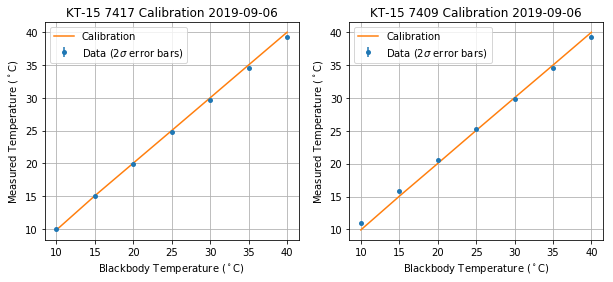

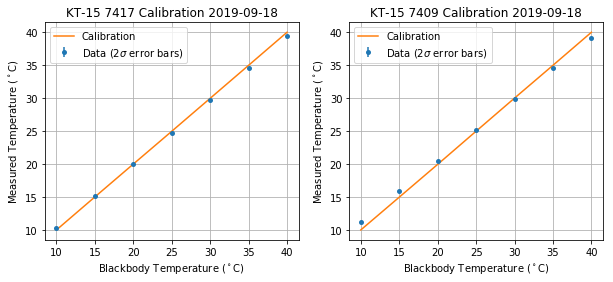

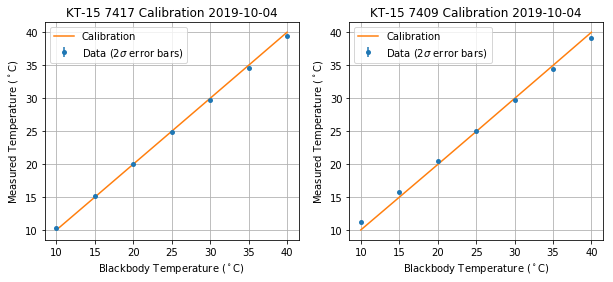

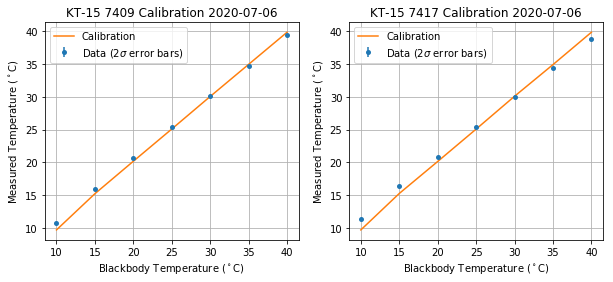

In [3]:
for cal_folder in glob.glob('../Data/Level_0/Falkor19/KT15_LabCalibrations/*'):  
    KT15_labcalibration(data_folder = cal_folder,
                        output_path = '../Data/Level_1/Falkor19/KT15_LabCalibrations', 
                        caltemps = [10,15,20,25,30,35,40])

We are ready to apply the lab calibrations and sky-correct the data:

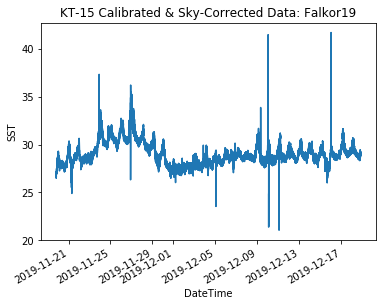

In [12]:
%autoreload
from KT15_Toolbox import KT15_calibrate_skycorrect82
KT15_calibrate_skycorrect82(l1data_path = '../Data/Level_1/Falkor19/KT15/Falkor19_KT15_7417_7409.cdf',
                            output_path = '../Data/Level_3/Falkor19/KT15/',
                            cal_path = '../Data/Level_1/Falkor19/KT15_LabCalibrations/')

The KT-15 SST is now an L3 product, ready for use in science analysis in the body of the paper.

### - Falkor 2016 -

First, we import the raw data files (Level 0) from each experiment, and save the data as a collated netCDF (Level 1). This can take a while for a large dataset, so don't run this cell if you don't mean it.

In [ ]:
#Falkor 2016: Takes ~7 minutes to run. Note the sea and sky instruments are opposite from Falkor19
KT15_importraw(data_folder = '../Data/Level_0/Falkor16/KT15/',
               output_path = '../Data/Level_1/Falkor16/KT15/', 
               sea_serial = 7409,
               sky_serial = 7417, 
               experiment = 'Falkor16')

Next we'll import calibration data acquired in the Lab while looking at a blackbody, and extract a linear fit from the data that allows us to calibrate our field measurements and increase their accuracy.

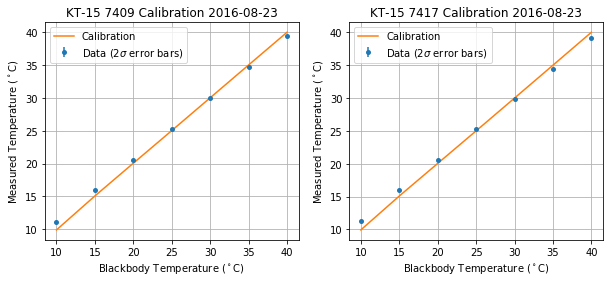

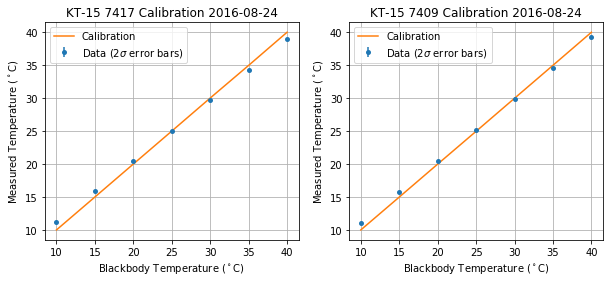

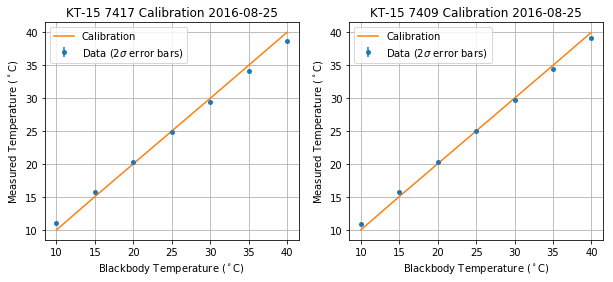

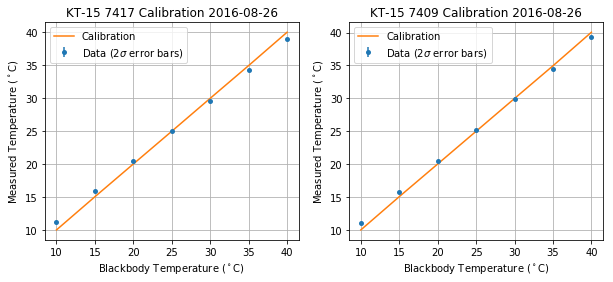

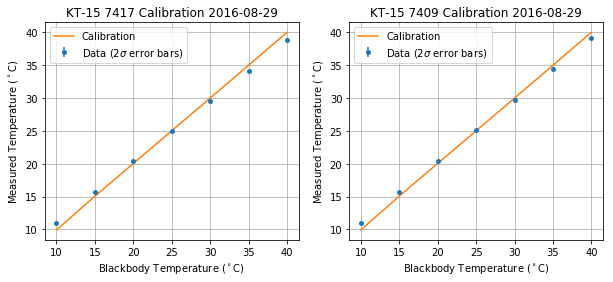

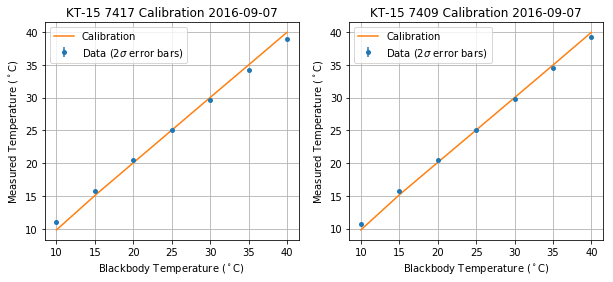

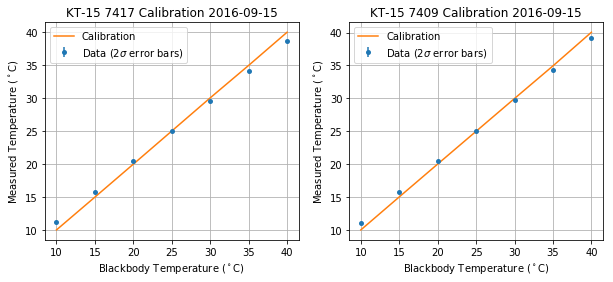

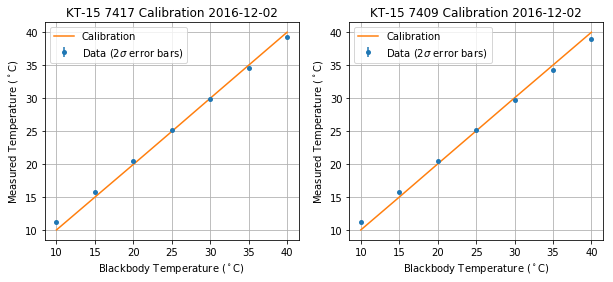

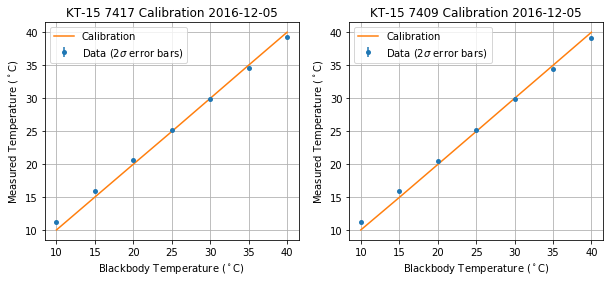

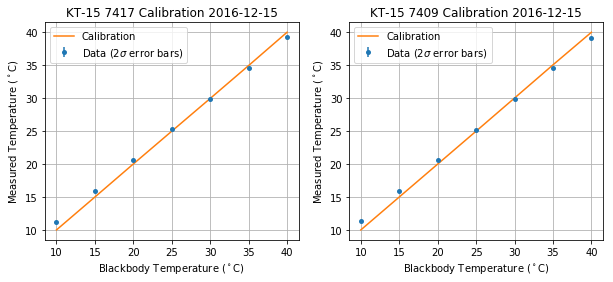

In [3]:
for cal_folder in glob.glob('../Data/Level_0/Falkor16/KT15_LabCalibrations/*'):  
    KT15_labcalibration(data_folder = cal_folder,
                        output_path = '../Data/Level_1/Falkor16/KT15_LabCalibrations', 
                        caltemps = [10,15,20,25,30,35,40])

We are ready to apply the lab calibrations and sky-correct the data:

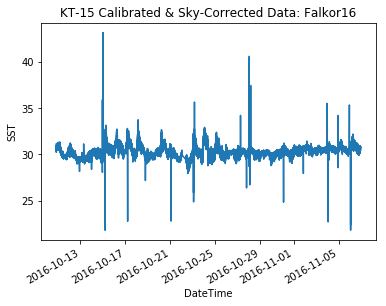

In [4]:
KT15_calibrate_skycorrect82(l1data_path = '../Data/Level_1/Falkor16/KT15/Falkor16_KT15_7409_7417.cdf',
                            output_path = '../Data/Level_3/Falkor16/KT15/',
                            cal_path = '../Data/Level_1/Falkor16/KT15_LabCalibrations/')

The KT-15 SST is now an L3 product, ready for use in science analysis in the body of the paper.

In [27]:
kt_fk16 = xr.open_dataset('../Data/Level_3/Falkor16/KT15/Falkor16_KT15_CalibratedSST.cdf')
kt_fk16

<xarray.Dataset>
Dimensions:      (DateTime: 2785822)
Coordinates:
  * DateTime     (DateTime) datetime64[ns] 2016-10-10T20:15:43.825000 ... 2016-11-06T22:38:04.215000
Data variables:
    SeaRef       (DateTime) float64 ...
    SeaTemp      (DateTime) float64 ...
    SkyRef       (DateTime) float64 ...
    SkyTemp      (DateTime) float64 ...
    SkyTemp_Cal  (DateTime) float64 ...
    SeaTemp_Cal  (DateTime) float64 ...
    SST          (DateTime) float64 ...
Attributes:
    experiment:  Falkor16
    sea_serial:  7409
    sky_serial:  7417
    sea_slope:   0.9356645728890147
    sea_yint:    1.7417109487690503
    sky_slope:   0.9270068573636857
    sky_yint:    1.9150189288935866

In [28]:
kt_fk16.SST.to_pandas().to_csv('../Data/Level_3/Falkor16/KT15//Falkor16_KT15_CalibratedSSTONLY.csv')

C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:1: FutureWarning: The signature of `Series.to_csv` was aligned to that of `DataFrame.to_csv`, and argument 'header' will change its default value from False to True: please pass an explicit value to suppress this warning.
  """Entry point for launching an IPython kernel.


### - Dynamo -

First, we import the raw data files (Level 0) from each experiment, and save the data as a collated netCDF (Level 1). This can take a while for a large dataset, so don't run this cell if you don't mean it.

In [ ]:
#Dynamo 2011: Takes ~30 minutes to run.
KT15_importraw(data_folder = '../Data/Level_0/Dynamo/KT15/',
               output_path = '../Data/Level_1/Dynamo/KT15/', 
               sea_serial = 7409,
               sky_serial = 7417, 
               experiment = 'Dynamo')

The KT-15s were calibrated by Deb using constants "calculated by Eric circa 2007" and "in use until at least June 2013". It is critical to note that her code treats "a" as the y-intercept and "b" as the slope, which is counter-intuitive to me so I need to keep that straight. These are the coefficients:

- Upa = 2.6117;       % +/- 0.0344	(yint) % KT7417
- Upb = 0.90621;      % +/- 0.00143 (slope)
- Downa = 1.4897;     % +/- 0.0281	(yint) %KT7409
- Downb = 0.94989;    % +/- 0.00117 (slope)

It appears there was also a calibration done in 2014, with these coefficients:

- Upb = 0.9509; (slope)      
- Upa = 1.28615; (yint)      
- Downb = 0.9726; (slope)    
- Downa = 0.65781; (yint)

Let's compare these coefficients to the ones on the two Falkor experiments:

In [8]:
xr.open_dataset('../Data/Level_3/Falkor16/KT15/Falkor16_KT15_CalibratedSST.cdf').attrs

OrderedDict([('experiment', 'Falkor16'),
             ('sea_serial', 7409),
             ('sky_serial', 7417),
             ('sea_slope', 0.9356645728890147),
             ('sea_yint', 1.7417109487690503),
             ('sky_slope', 0.9270068573636857),
             ('sky_yint', 1.9150189288935866)])

In [9]:
xr.open_dataset('../Data/Level_3/Falkor19/KT15/Falkor19_KT15_CalibratedSST.cdf').attrs

OrderedDict([('experiment', 'Falkor19'),
             ('sea_serial', 7417),
             ('sky_serial', 7409),
             ('sea_slope', 0.9727612699942666),
             ('sea_yint', 0.4628266465754239),
             ('sky_slope', 0.9338967855693827),
             ('sky_yint', 1.8237596338977193)])

Generally, all the slopes are very close to 1, and the y-intercepts vary between 0.5-2. All seems quite reasonable. Still, given the inconsistencies in Deb's code (such as a section in which she was trying switching the slopes and yintercepts for reasons I cannot fathom), I'd like to get a hold of the actual raw calibration data. But I cannot find it in any obvious place on the servers, so I may have no choice but to trust these coefficients from Deb's code...

For now, because they seem reasonable enough, I'll just manually make cal files for both the 2007 and 2014 coefficients:

In [6]:
output_path = '../Data/Level_1/Dynamo/KT15_LabCalibrations/'

cal_7409_2007 = xr.Dataset(attrs={'serial_number':7409,
                                  'calibration_date':'2007',
                                  'slope':0.94989,
                                  'yint': 1.4897})
cal_7409_2007.to_netcdf(output_path+'/KT15_LabCalibration_7409_2007-00-00.cdf')

cal_7409_2014 = xr.Dataset(attrs={'serial_number':7409,
                                  'calibration_date':'2014',
                                  'slope':0.9726,
                                  'yint': 0.65781})
cal_7409_2014.to_netcdf(output_path+'/KT15_LabCalibration_7409_2014-00-00.cdf')

cal_7417_2007 = xr.Dataset(attrs={'serial_number':7417,
                                  'calibration_date':'2007',
                                  'slope':0.90621,
                                  'yint': 2.6117})
cal_7417_2007.to_netcdf(output_path+'/KT15_LabCalibration_7417_2007-00-00.cdf')

cal_7417_2014 = xr.Dataset(attrs={'serial_number':7417,
                                  'calibration_date':'2014',
                                  'slope':0.9509,
                                  'yint': 1.28615})
cal_7417_2014.to_netcdf(output_path+'/KT15_LabCalibration_7417_2014-00-00.cdf')

We are ready to apply the lab calibrations and sky-correct the data:

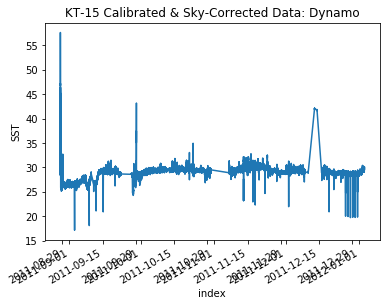

In [11]:
KT15_calibrate_skycorrect82(l1data_path = '../Data/Level_1/Dynamo/KT15/Dynamo_KT15_7409_7417.cdf',
                            output_path = '../Data/Level_3/Dynamo/KT15/',
                            cal_path = '../Data/Level_1/Dynamo/KT15_LabCalibrations/')

The KT-15 SST is now an L3 product, ready for use in science analysis in the body of the paper.

## Appendix 2: Rain Data Processing

### - Falkor 2016 -

Rain data available to us from Falkor 2016 come from the tipping bucket sensor on the catamaran. We'll import that and take a look at it here.

In [1]:
import numpy as np
import pandas as pd
import xarray as xr
import numpy as np
import datetime as dt
import glob
import tqdm
import time
from matplotlib import pyplot as plt
%matplotlib inline

C:\Users\cwitt\Anaconda3\lib\site-packages\distributed\utils.py:133: RuntimeWarning: Couldn't detect a suitable IP address for reaching '8.8.8.8', defaulting to '127.0.0.1': [WinError 10051] A socket operation was attempted to an unreachable network
  RuntimeWarning,


In [2]:
#make the relevant variables (ie rain rate) be formatted identically to Dynamo dataset so that we can run the same function on them 
cat = pd.read_csv('../Data/Level_1/Falkor16/Catamaran/Wurl-etal_2017.tab',skiprows=82,delimiter='\t',index_col=2,parse_dates=True,
                   names=['Event','Method','Lon','Lat','Depth_SML','Depth_Bulk',
                          'LocalTime','fDOM_Volts_SML','fDOM_SML','fDOM_Volts_Bulk','fDOM_Bulk',
                          'fDOM_EF','Fo','Fm','No','Fv','Ft','Chl_a','Chl_QF','Sal_SML','Sal_Bulk','Sal_delta',
                          'pH_SML','pH_Bulk','pH_delta','Temp_SML','Temp_Bulk','Temp_delta',
                          'TempHP_2cm','TempHP_15cm','TempHP_delta','AirTemp','RH','DewPoint',
                          'WindSpeed','WindDir','Pres','HeatIndex','THWIndex','THSWIndex','Precip','P','SW','SolarE','UVI',
                          'Erythem','HDD','CDD','SAS_SML','SAS_SML_std','SAS_Bulk','SAS_Bulk_std','SAS_EF'])

#there are 6 entries per minute and only one of them contains useful data - drop all the lines that have NaN as the precip value
cat = cat[~np.isnan(cat['P'])]
#convert to xarray and fill out metadata
cat_xr = cat.to_xarray()

cat_xr.attrs['experiment'] = 'Falkor2016'

cat_xr.Lon.attrs['long_name'] = 'Longitude'
cat_xr.Lon.attrs['units'] = 'deg'

cat_xr.Lat.attrs['long_name'] = 'Latitude'
cat_xr.Lat.attrs['units'] = 'deg'

cat_xr.Depth_SML.attrs['long_name'] = 'Water Depth of SML Measurements'
cat_xr.Depth_SML.attrs['units'] = 'm'

cat_xr.Depth_Bulk.attrs['long_name'] = 'Water Depth of Bulk Measurements'
cat_xr.Depth_Bulk.attrs['units'] = 'm'

cat_xr.fDOM_Volts_SML.attrs['long_name'] = 'Raw Voltage Output of SML fDOM Measurements'
cat_xr.fDOM_Volts_SML.attrs['units'] = 'mV'

cat_xr.fDOM_SML.attrs['long_name'] = 'SML Fluorescent Dissolved Organic Matter'
cat_xr.fDOM_SML.attrs['units'] = 'µg/l'

cat_xr.fDOM_Volts_Bulk.attrs['long_name'] = 'Raw Voltage Output of SML fDOM Measurements'
cat_xr.fDOM_Volts_Bulk.attrs['units'] = 'mV'

cat_xr.fDOM_Bulk.attrs['long_name'] = 'Bulk Fluorescent Dissolved Organic Matter'
cat_xr.fDOM_Bulk.attrs['units'] = 'µg/l'

cat_xr.fDOM_EF.attrs['long_name'] = 'Fluorescent Dissolved Organic Matter Enrichment Factor'

cat_xr.Fo.attrs['long_name'] = 'Minimum Fluorescence'

cat_xr.Fm.attrs['long_name'] = 'Maximum Fluorescence'

cat_xr.No.attrs['long_name'] = 'Number blank'

cat_xr.Fv.attrs['long_name'] = 'Fluorescence, variable'

cat_xr.Ft.attrs['long_name'] = 'Fluorescence, yield at any given time'

cat_xr.Chl_a.attrs['long_name'] = 'Chlorophyll a'
cat_xr.Chl_a.attrs['units'] = 'µg/l'

cat_xr.Chl_QF.attrs['long_name'] = 'Chlorophyll Quality Flag (< means Fm lower than calibration curve)'

cat_xr.Sal_SML.attrs['long_name'] = 'SML Salinity'
cat_xr.Sal_SML.attrs['units'] = 'psu'

cat_xr.Sal_Bulk.attrs['long_name'] = 'Bulk Salinity'
cat_xr.Sal_Bulk.attrs['units'] = 'psu'

cat_xr.Sal_delta.attrs['long_name'] = 'Salinity Difference between SML and Bulk'
cat_xr.Sal_delta.attrs['units'] = 'psu'

cat_xr.pH_SML.attrs['long_name'] = 'SML pH'

cat_xr.pH_Bulk.attrs['long_name'] = 'Bulk pH'

cat_xr.pH_delta.attrs['long_name'] = 'pH Difference between SML and Bulk'

cat_xr.Temp_SML.attrs['long_name'] = 'SML Temperature'
cat_xr.Temp_SML.attrs['units'] = '°C'

cat_xr.Temp_Bulk.attrs['long_name'] = 'Bulk Temperature'
cat_xr.Temp_Bulk.attrs['units'] = '°C'

cat_xr.Temp_delta.attrs['long_name'] = 'Temperature Difference between SML and Bulk'
cat_xr.Temp_delta.attrs['units'] = '°C'

cat_xr.TempHP_2cm.attrs['long_name'] = 'High-Precision Temperature at 2cm Depth'
cat_xr.TempHP_2cm.attrs['units'] = '°C'

cat_xr.TempHP_15cm.attrs['long_name'] = 'High-Precision Temperature at 15cm Depth'
cat_xr.TempHP_15cm.attrs['units'] = '°C'

cat_xr.TempHP_delta.attrs['long_name'] = 'Temperature Difference between 2cm and 15cm Depth'
cat_xr.TempHP_delta.attrs['units'] = '°C'

cat_xr.AirTemp.attrs['long_name'] = 'Air Temperature'
cat_xr.AirTemp.attrs['units'] = '°C'

cat_xr.RH.attrs['long_name'] = 'Relative Humidity'
cat_xr.RH.attrs['units'] = '%'

cat_xr.DewPoint.attrs['long_name'] = 'Dew/Frost Point'
cat_xr.DewPoint.attrs['units'] = '°C'

cat_xr.WindSpeed.attrs['long_name'] = 'Wind Speed'
cat_xr.WindSpeed.attrs['units'] = 'm/s'

cat_xr.WindDir.attrs['long_name'] = 'Wind Direction Description'

cat_xr.Pres.attrs['long_name'] = 'Air Pressure'
cat_xr.Pres.attrs['units'] = 'bar'

cat_xr.HeatIndex.attrs['units'] = '°C'
cat_xr.THWIndex.attrs['units'] = '°C'
cat_xr.THSWIndex.attrs['units'] = '°C'

cat_xr.Precip.attrs['long_name'] = 'Total Rainfall'
cat_xr.Precip.attrs['units'] = 'mm'

cat_xr.P.attrs['long_name'] = 'Rain Rate'
cat_xr.P.attrs['units'] = 'mm/hr'

cat_xr.SW.attrs['long_name'] = 'Downwelling SW Radiation'
cat_xr.SW.attrs['units'] = 'W/m^2'

cat_xr.SolarE.attrs['long_name'] = 'Solar Energy'
cat_xr.SolarE.attrs['units'] = 'W'

cat_xr.UVI.attrs['long_name'] = 'Ultraviolet Index'

cat_xr.Erythem.attrs['long_name'] = 'Erythemal dose, minimal'
cat_xr.Erythem.attrs['units'] = 'MED'

cat_xr.HDD.attrs['long_name'] = 'Heat degree-day'

cat_xr.CDD.attrs['long_name'] = 'Cool degree-day'

cat_xr.SAS_SML.attrs['long_name'] = 'Surface Active Substances (SML)'
cat_xr.SAS_SML.attrs['units'] = 'mg/L'

cat_xr.SAS_SML_std.attrs['long_name'] = 'Surface Active Substances (SML) Standard Deviation'
cat_xr.SAS_SML_std.attrs['units'] = 'mg/L'

cat_xr.SAS_Bulk.attrs['long_name'] = 'Surface Active Substances (Bulk)'
cat_xr.SAS_Bulk.attrs['units'] = 'mg/L'

cat_xr.SAS_Bulk_std.attrs['long_name'] = 'Surface Active Substances (Bulk) Standard Deviation'
cat_xr.SAS_Bulk_std.attrs['units'] = 'mg/L'

cat_xr.SAS_EF.attrs['long_name'] = 'Surface Active Substances Enrichment Factor'

cat_xr

<xarray.Dataset>
Dimensions:          (index: 5894)
Coordinates:
  * index            (index) datetime64[ns] 2016-10-11T23:34:00 ... 2016-11-06T06:59:00
Data variables:
    Event            (index) object 'FK161010_1' 'FK161010_1' ... 'FK161010_17'
    Method           (index) object 'Cat' 'Cat' 'Cat' ... 'Cat' 'Cat' 'Cat'
    Lon              (index) float64 128.7 128.7 128.7 ... 144.7 144.7 144.7
    Lat              (index) float64 -14.49 -14.49 -14.49 ... 3.631 3.631 3.631
    Depth_SML        (index) int64 0 0 0 0 0 0 0 0 0 0 0 ... 0 0 0 0 0 0 0 0 0 0
    Depth_Bulk       (index) int64 1 1 1 1 1 1 1 1 1 1 1 ... 1 1 1 1 1 1 1 1 1 1
    LocalTime        (index) object '09:04:06' '09:05:06' ... '16:59:00'
    fDOM_Volts_SML   (index) float64 0.09 0.09 0.09 0.1 0.12 ... nan nan nan nan
    fDOM_SML         (index) float64 3.6 3.6 3.6 4.0 4.8 ... nan nan nan nan nan
    fDOM_Volts_Bulk  (index) float64 0.07 0.07 0.06 0.06 ... nan nan nan nan
    fDOM_Bulk        (index) float64 2.8 2.8

In [3]:
#save as L3 data product
cat_xr.to_netcdf('../Data/Level_3/Falkor16/Catamaran/catamaran_fk16_alldata.cdf')

Catamaran Data from Falkor 2016 is now a L3 data product, ready for use in science analysis

### - Falkor 2019 -

Rain data available to us from Falkor 2019 come from the tipping bucket sensor on the catamaran. We'll import that and take a look at it here.

In [1]:
import numpy as np
import pandas as pd
import xarray as xr
import numpy as np
import datetime as dt
import glob
import tqdm
import time
from matplotlib import pyplot as plt
%matplotlib inline

In [48]:
files = glob.glob('../Data/Level_1/Falkor19/Catamaran/SeaSurface_*.csv')
data_list = []

for file in files:
    data = pd.read_csv(file,skiprows=8,index_col=0,parse_dates=True)
    data_list.append(data)

cat19 = pd.concat(data_list)

#want to rename all the variables to match with 2016 data
cat19.rename(columns={'Cool_DD':'CDD',
                      'Dew_point_C':'DewPoint', 
                      'EF':'fDOM_EF', 
                      'FDOM_Bulk':'fDOM_Bulk', 
                      'FDOM_SML':'fDOM_SML', 
                      'Heat_DD':'HDD', 
                      'Heat_Index_C':'HeatIndex',
                      'Latitude_degrees_north':'Lat',
                      'Longitude_degrees_east':'Lon',
                      'Pressure_bar':'Pres', 
                      'Rain_mm':'Precip', 
                      'Rain_rate_mmhr':'P',
                      'Salinity_Bulk':'Sal_Bulk', 
                      'Salinity_SML':'Sal_SML', 
                      'Solar_Energy_W':'SolarE', 
                      'Solar_rad_Wm2':'SW', 
                      'THSW_Index_C':'THSWIndex', 
                      'THW_Index_C':'THWIndex', 
                      'Temp_Air_C':'AirTemp', 
                      'UV_index':'UVI', 
                      'Wind_dir':'WindDir', 
                      'Windspeed_ms':'WindSpeed', 
                      'delta_Sal':'Sal_delta', 
                      'delta_pH':'ph_delta', 
                      }, inplace=True)


#there are 6 entries per minute and only one of them contains useful data - drop all the lines that have NaN as the precip value
cat19 = cat19[~np.isnan(cat19['P'])]


cat19.index.rename('index',inplace=True)

C:\ProgramData\Anaconda3\lib\site-packages\IPython\core\interactiveshell.py:2785: DtypeWarning: Columns (18) have mixed types. Specify dtype option on import or set low_memory=False.
  interactivity=interactivity, compiler=compiler, result=result)
C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:8: FutureWarning: Sorting because non-concatenation axis is not aligned. A future version
of pandas will change to not sort by default.

To accept the future behavior, pass 'sort=False'.

To retain the current behavior and silence the warning, pass 'sort=True'.

  


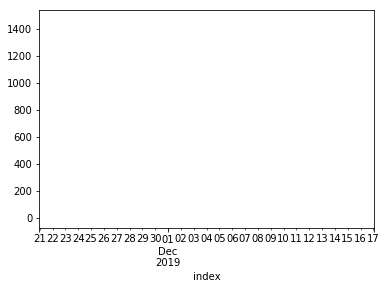

In [65]:
cat19.P.resample('S').apply(np.nanmedian).plot()

In [3]:
#convert to xarray and fill out metadata
cat_xr = cat19.to_xarray()

cat_xr.attrs['experiment'] = 'Falkor2019'

cat_xr.Lon.attrs['long_name'] = 'Longitude'
cat_xr.Lon.attrs['units'] = 'deg'

cat_xr.Lat.attrs['long_name'] = 'Latitude'
cat_xr.Lat.attrs['units'] = 'deg'

cat_xr.fDOM_SML.attrs['long_name'] = 'SML Fluorescent Dissolved Organic Matter'
cat_xr.fDOM_SML.attrs['units'] = 'µg/l'

cat_xr.fDOM_Bulk.attrs['long_name'] = 'Bulk Fluorescent Dissolved Organic Matter'
cat_xr.fDOM_Bulk.attrs['units'] = 'µg/l'

cat_xr.fDOM_EF.attrs['long_name'] = 'Fluorescent Dissolved Organic Matter Enrichment Factor'

cat_xr.Fo.attrs['long_name'] = 'Minimum Fluorescence'

cat_xr.Fm.attrs['long_name'] = 'Maximum Fluorescence'

cat_xr.Fv.attrs['long_name'] = 'Fluorescence, variable'

cat_xr.Sal_SML.attrs['long_name'] = 'SML Salinity'
cat_xr.Sal_SML.attrs['units'] = 'psu'

cat_xr.Sal_Bulk.attrs['long_name'] = 'Bulk Salinity'
cat_xr.Sal_Bulk.attrs['units'] = 'psu'

cat_xr.Sal_delta.attrs['long_name'] = 'Salinity Difference between SML and Bulk'
cat_xr.Sal_delta.attrs['units'] = 'psu'

cat_xr.pH_SML.attrs['long_name'] = 'SML pH'

cat_xr.pH_Bulk.attrs['long_name'] = 'Bulk pH'

cat_xr.AirTemp.attrs['long_name'] = 'Air Temperature'
cat_xr.AirTemp.attrs['units'] = '°C'

cat_xr.RH.attrs['long_name'] = 'Relative Humidity'
cat_xr.RH.attrs['units'] = '%'

cat_xr.DewPoint.attrs['long_name'] = 'Dew/Frost Point'
cat_xr.DewPoint.attrs['units'] = '°C'

cat_xr.WindSpeed.attrs['long_name'] = 'Wind Speed'
cat_xr.WindSpeed.attrs['units'] = 'm/s'

cat_xr.WindDir.attrs['long_name'] = 'Wind Direction Description'

cat_xr.Pres.attrs['long_name'] = 'Air Pressure'
cat_xr.Pres.attrs['units'] = 'bar'

cat_xr.HeatIndex.attrs['units'] = '°C'
cat_xr.THWIndex.attrs['units'] = '°C'
cat_xr.THSWIndex.attrs['units'] = '°C'

cat_xr.Precip.attrs['long_name'] = 'Total Rainfall'
cat_xr.Precip.attrs['units'] = 'mm'

cat_xr.P.attrs['long_name'] = 'Rain Rate'
cat_xr.P.attrs['units'] = 'mm/hr'

cat_xr.SW.attrs['long_name'] = 'Downwelling SW Radiation'
cat_xr.SW.attrs['units'] = 'W/m^2'

cat_xr.SolarE.attrs['long_name'] = 'Solar Energy'
cat_xr.SolarE.attrs['units'] = 'W'

cat_xr.UVI.attrs['long_name'] = 'Ultraviolet Index'

cat_xr.HDD.attrs['long_name'] = 'Heat degree-day'

cat_xr.CDD.attrs['long_name'] = 'Cool degree-day'

cat_xr

<xarray.Dataset>
Dimensions:                 (index: 10965)
Coordinates:
  * index                   (index) datetime64[ns] 2019-11-20T23:25:00 ... 2019-12-17T01:40:00
Data variables:
    Blank                   (index) object nan nan nan nan ... 46.0 46.0 46.0
    Celsius                 (index) float64 nan nan nan nan ... nan nan nan nan
    Cond_Bulk               (index) float64 nan nan nan ... 4.36e+04 4.36e+04
    Cond_SML                (index) float64 4.66e+04 4.66e+04 ... 4.7e+04
    CDD                     (index) float64 0.007 0.007 0.007 ... 24.0 23.0 23.0
    DP                      (index) float64 nan nan nan nan ... nan nan nan nan
    DewPoint                (index) float64 24.8 24.8 24.8 ... 25.8 25.8 25.8
    fDOM_EF                 (index) float64 nan nan nan ... 6.554e+04 6.554e+04
    fDOM_Bulk               (index) float64 nan nan nan nan ... 0.4 0.4 0.0 0.0
    fDOM_SML                (index) float64 nan nan nan nan ... -2.8 -2.4 -2.4
    Fahrenheit              

In [4]:
cat_xr_drop = cat_xr.drop(['Blank','Fm','Yield'])

In [5]:
#save as L3 data product
cat_xr_drop.to_netcdf('../Data/Level_3/Falkor19/Catamaran/catamaran_fk19_alldata.cdf')

Catamaran Data from Falkor 2016 is now a L3 data product, ready for use in science analysis

### - Dynamo -

The data from R/V Revelle was provided by Jim Edson in a L1 .mat format. Here we'll import it and save the relevant variables into a science-ready netcdf.

From the Readme Edson included with the Revelle data files, these are the variables:

| Variable | Description |
|:-----|:-----|
|Yday |     Decimal yearday (UTC)
|Lat  |     Latitude (deg)
|Lon  |     Longitude (deg)
|SOG  |     Speed over ground (m/s)
|COG  |     Course over ground (deg)
|Heading|   Ship's heading (deg)
|Cspd |     Current speed (m/s)
|Cdir |     Current direction (deg) from
|U10  |     Wind speed (m/s) relative to earth adjusted to 10 m
|Wdir |     Wind direction (deg) from relative to earth
|Ur10 |     Wind speed (m/s) relative to water adjusted to 10 m
|WdirR|     Wind direction (deg) from relative to water
|Pair10|    Pressure (mb) adjusted to 10 m
|RH10  |    Relative humidity(%) adjusted to 10 m
|T10   |    Temperature (C) adjusted to 10 m
|Tsea  |    Near surface sea temperature (C) from Sea snake
|SST   |    Sea surface temperature (C) from Tsea minus cool skin
|Q10  |     Specific humidity (g/Kg) adjusted to 10 m
|Qsea |     Specific humidity (g/Kg) 'near' ocean surface from sea snake
|SSQ  |     Sea surface specific humidity (g/Kg) from Qsea minus cool skin
|stress |   Surface stress (N/m2) measured relative to water
|shf  |     Sensible heat flux (W/m2)
|lhf  |     Latent heat flux (W/m2)
|rhf  |     Sensible heat flux from rain (W/m2)
|Solarup |  Reflected solar (W/m2) estimated from Payne (1972)
|Solardn |  Measured downwelling solar (W/m2)
|IRup    |  Upwelling IR (W/m2) computed from SST 
|IRdn    |  Measured downwelling IR (W/m2)
|E       |  Evaporation rate (mm/hr)
|P  |       Precipitation rate (mm/hr)
|Evap |      Accumulated evaporation for Leg (mm)
|Precip |   Accumulated precipitation for Leg (mm)
|Interped | 1=data interpolated due to poor relative winds (0=no interpolation)
           

In [7]:
rv.Tsea.mean() - rv.SST.mean()

<xarray.DataArray ()>
array(0.281298)

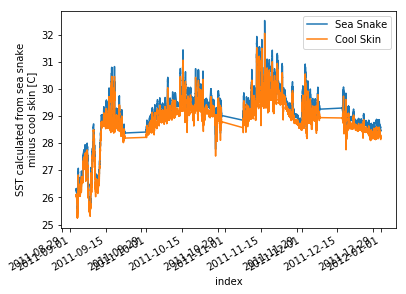

In [4]:
fig,axx = plt.subplots(facecolor='w')
rv.Tsea.plot()
rv.SST.plot()
plt.legend(['Sea Snake','Cool Skin'])

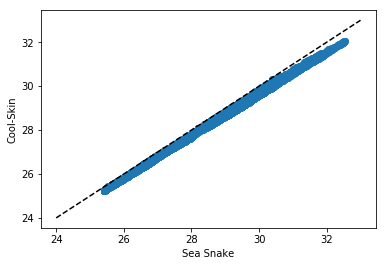

In [6]:
fig,axx = plt.subplots(facecolor='w')
axx.scatter(rv.Tsea,rv.SST)
axx.set_xlabel('Sea Snake')
axx.set_ylabel('Cool-Skin')
lines = np.arange(24,34)
axx.plot(lines,lines,'--k')

In [29]:
import numpy as np
import pandas as pd
import xarray as xr
import numpy as np
import datetime as dt
import glob
import tqdm
import time
from matplotlib import pyplot as plt
%matplotlib inline
from scipy.io import loadmat

In [30]:
#generate list of 1min Revelle .mat data files in the Level-1 Folder (provided by Jim Edson)
data_folder = '../Data/Level_1/Dynamo/Revelle_FluxData/'
files = glob.glob(data_folder + '/*1minute*.mat')

Revelle_dfs = []

#iterate over list of files
for filepath in files: 
    #import file as a dictionary of numpy arrays using the scipy loadmat function
    Revelle_Leg = loadmat(filepath)
    print(filepath)
    #drop the metadata keys from the dictionary so that all the remaining arrays are the same size
    del Revelle_Leg['__header__']
    del Revelle_Leg['__version__']
    del Revelle_Leg['__globals__']

    #initialize pandas dataframe with time as the index
    year = 2011
    date = dt.datetime(year, 1, 1) + pd.to_timedelta(Revelle_Leg['yday'][0]-1,unit='days')
    Revelle_df = pd.DataFrame(index=date)

    #iterate over each key in the dict and add to the pandas dataframe as a new column
    for key in Revelle_Leg:
        Revelle_df[key] = Revelle_Leg[key][0].tolist()
    
    #add the pandas dataframe to a list of dataframes
    Revelle_dfs.append(Revelle_df)

#concatenate all the dataframes in the list into one complete dataframe along the vertical (index) axis
RevelleData = pd.concat(Revelle_dfs, axis=0, sort=True)
RevelleData

../Data/Level_1/Dynamo/Revelle_FluxData\Revelle1minuteLeg1_r4.mat
../Data/Level_1/Dynamo/Revelle_FluxData\Revelle1minuteLeg2_r4.mat
../Data/Level_1/Dynamo/Revelle_FluxData\Revelle1minuteLeg3_r4.mat
../Data/Level_1/Dynamo/Revelle_FluxData\Revelle1minuteLeg4_r4.mat


,COG,E,Evap,Heading,IRdn,IRup,Lat,Lon,P,Pair10,...,shf,sigDir,sigH,stress,wdir,wdirR,wspd,wspdR,yday,zenith
2011-09-03 12:00:00.000000000,271.946077,0.156782,0.002613,275.113925,-384.944433,452.409581,-12.222304,103.963430,0.414286,1012.666808,...,-1.486750,NaN,NaN,0.053796,90.047206,92.337732,7.003836,6.807184,246.500000,90.0
2011-09-03 12:01:00.000000000,271.623400,0.157333,0.005235,274.373564,-384.699128,452.418122,-12.222169,103.959760,0.421316,1012.673902,...,-1.627748,NaN,NaN,0.053977,87.564013,89.772121,7.027857,6.819655,246.500694,90.0
2011-09-03 12:02:00.000000000,270.807349,0.164328,0.007974,273.314616,-384.153406,452.385815,-12.222098,103.956098,0.428571,1012.690570,...,-1.336956,NaN,NaN,0.057196,85.588681,87.683286,7.194510,6.977302,246.501389,90.0
2011-09-03 12:03:00.000000000,270.305084,0.162074,0.010675,272.787549,-384.041931,452.354314,-12.222081,103.952433,0.428571,1012.689585,...,-0.901296,NaN,NaN,0.055303,87.393088,89.687214,7.079109,6.870022,246.502083,90.0
2011-09-03 12:04:00.000000000,270.907205,0.158555,0.013318,273.670393,-384.346970,452.356682,-12.222048,103.948770,0.428571,1012.704747,...,-0.870331,NaN,NaN,0.053323,89.643457,92.158613,6.962961,6.765384,246.502778,90.0
2011-09-03 12:05:00.000000000,271.969455,0.159142,0.015970,274.891226,-384.639568,452.378919,-12.221956,103.945113,0.428571,1012.720704,...,-0.908629,NaN,NaN,0.053374,90.428503,92.966916,6.961869,6.768360,246.503472,90.0
2011-09-03 12:06:00.000000000,272.425952,0.159526,0.018629,275.486766,-384.006088,452.366320,-12.221806,103.941454,0.435607,1012.711918,...,-0.956546,NaN,NaN,0.053283,90.606222,93.151709,6.956606,6.764028,246.504167,90.0
2011-09-03 12:07:00.000000000,271.635787,0.159473,0.021287,274.747129,-383.889500,452.342379,-12.221669,103.937804,0.442857,1012.715467,...,-1.042822,NaN,NaN,0.052987,89.532910,92.050551,6.947666,6.749535,246.504861,90.0
2011-09-03 12:08:00.000000000,270.798265,0.159394,0.023943,273.675921,-383.676074,452.297212,-12.221595,103.934147,0.442857,1012.713963,...,-1.156634,NaN,NaN,0.052812,88.399823,90.927842,6.946174,6.742334,246.505556,90.0
2011-09-03 12:09:00.000000000,270.702652,0.153089,0.026495,273.532491,-383.455748,452.255069,-12.221549,103.930482,0.442857,1012.700361,...,-1.279841,NaN,NaN,0.049859,88.006626,90.627429,6.790653,6.584997,246.506250,90.0


In [31]:
#convert to xarray and fill out metadata (which will make plots self-labeling moving forwards)
Revelle_xr = RevelleData.to_xarray()

Revelle_xr.attrs['experiment'] = 'DYNAMO'

Revelle_xr.Lat.attrs['long_name'] = 'Latitude'
Revelle_xr.Lat.attrs['units'] = 'deg'

Revelle_xr.Lon.attrs['long_name'] = 'Longitude'
Revelle_xr.Lon.attrs['units'] = 'deg'

Revelle_xr.SOG.attrs['long_name'] = 'Speed Over Ground'
Revelle_xr.SOG.attrs['units'] = 'm/s'

Revelle_xr.COG.attrs['long_name'] = 'Course Over Ground'
Revelle_xr.COG.attrs['units'] = 'deg'

Revelle_xr.Heading.attrs['long_name'] = 'Ships Heading'
Revelle_xr.Heading.attrs['units'] = 'deg'

Revelle_xr.cspd.attrs['long_name'] = 'Current Speed'
Revelle_xr.cspd.attrs['units'] = 'm/s'

Revelle_xr.cdir.attrs['long_name'] = 'Current Direction (from)'
Revelle_xr.cdir.attrs['units'] = 'deg'

Revelle_xr.U10.attrs['long_name'] = '10m Wind Speed (relative to earth)'
Revelle_xr.U10.attrs['units'] = 'm/s'

Revelle_xr.wdir.attrs['long_name'] = 'Wind Direction (from, relative to earth)'
Revelle_xr.wdir.attrs['units'] = 'deg'

Revelle_xr.Ur10.attrs['long_name'] = '10m Wind Speed (relative to water)'
Revelle_xr.Ur10.attrs['units'] = 'm/s'

Revelle_xr.wdirR.attrs['long_name'] = 'Wind Direction (relative to water)'
Revelle_xr.wdirR.attrs['units'] = 'deg'

Revelle_xr.Pair10.attrs['long_name'] = '10m Air Pressure'
Revelle_xr.Pair10.attrs['units'] = 'mbar'

Revelle_xr.RH10.attrs['long_name'] = '10m Relative Humidity'
Revelle_xr.RH10.attrs['units'] = '%'

Revelle_xr.RH02.attrs['long_name'] = '2m Relative Humidity'
Revelle_xr.RH02.attrs['units'] = '%'

Revelle_xr.T10.attrs['long_name'] = '10m Air Temperature'
Revelle_xr.T10.attrs['units'] = 'C'

Revelle_xr.T02.attrs['long_name'] = '2m Air Temperature'
Revelle_xr.T02.attrs['units'] = 'C'

Revelle_xr.Tsea.attrs['long_name'] = 'Near-surface temperature (sea snake)'
Revelle_xr.Tsea.attrs['units'] = 'C'

Revelle_xr.TseaTSG.attrs['long_name'] = 'Ship intake temperature'
Revelle_xr.TseaTSG.attrs['units'] = 'C'

Revelle_xr.SST.attrs['long_name'] = 'SST calculated from sea snake minus cool skin'
Revelle_xr.SST.attrs['units'] = 'C'

Revelle_xr.Q10.attrs['long_name'] = '10m Specific Humidity'
Revelle_xr.Q10.attrs['units'] = 'g/kg'

Revelle_xr.Q02.attrs['long_name'] = '2m Specific Humidity'
Revelle_xr.Q02.attrs['units'] = 'g/kg'

Revelle_xr.Qsea.attrs['long_name'] = 'Specific Humidity "near" ocean surface (sea snake)'
Revelle_xr.Qsea.attrs['units'] = 'g/kg'

Revelle_xr.SSQ.attrs['long_name'] = 'Sea Surface Specific Humidity from sea snake minus cool skin'
Revelle_xr.SSQ.attrs['units'] = 'g/kg'

Revelle_xr.stress.attrs['long_name'] = 'Surface stress relative to water'
Revelle_xr.stress.attrs['units'] = 'N/m^2'

Revelle_xr.shf.attrs['long_name'] = 'Sensible Heat Flux'
Revelle_xr.shf.attrs['units'] = 'W/m^2'

Revelle_xr.lhf.attrs['long_name'] = 'Latent Heat Flux'
Revelle_xr.lhf.attrs['units'] = 'W/m^2'

Revelle_xr.rhf.attrs['long_name'] = 'Sensible Heat Flux From Rain'
Revelle_xr.rhf.attrs['units'] = 'W/m^2'

Revelle_xr.Solarup.attrs['long_name'] = 'Reflected Solar estimated from Payne (1972)'
Revelle_xr.Solarup.attrs['units'] = 'W/m^2'

Revelle_xr.Solardn.attrs['long_name'] = 'Measured Downwelling Solar'
Revelle_xr.Solardn.attrs['units'] = 'W/m^2'

Revelle_xr.IRup.attrs['long_name'] = 'Upwelling IR computed from SST'
Revelle_xr.IRup.attrs['units'] = 'W/m^2'

Revelle_xr.IRdn.attrs['long_name'] = 'Measured Downwelling IR'
Revelle_xr.IRdn.attrs['units'] = 'W/m^2'

Revelle_xr.E.attrs['long_name'] = 'Evaporation Rate'
Revelle_xr.E.attrs['units'] = 'mm/hr'

Revelle_xr.P.attrs['long_name'] = 'Precipitation Rate'
Revelle_xr.P.attrs['units'] = 'mm/hr'

Revelle_xr.Evap.attrs['long_name'] = 'Accumulated evaporation for cruise leg'
Revelle_xr.Evap.attrs['units'] = 'mm'

Revelle_xr.Precip.attrs['long_name'] = 'Acummulated precipitation for cruise leg'
Revelle_xr.Precip.attrs['units'] = 'mm'

Revelle_xr.interped.attrs['long_name'] = '1=data interpolated due to poor relative winds (0=no interpolation)'
Revelle_xr.interped.attrs['units'] = 'n/a'

Revelle_xr.SalTSG.attrs['long_name'] = 'Salinity at ship intake'
Revelle_xr.SalTSG.attrs['units'] = 'psu'

Revelle_xr.sigH.attrs['long_name'] = 'Significant wave height'
Revelle_xr.sigH.attrs['units'] = 'm'

Revelle_xr.cp.attrs['long_name'] = 'Phase speed of dominant waves'
Revelle_xr.cp.attrs['units'] = 'm/s'

Revelle_xr.sigDir.attrs['long_name'] = 'Direction of dominant wave - placeholder'
Revelle_xr.sigDir.attrs['units'] = 'degrees'

Revelle_xr.dSolar.attrs['long_name'] = 'Measured diffuse radiation'
Revelle_xr.dSolar.attrs['units'] = 'W/m^2'

Revelle_xr.zenith.attrs['long_name'] = 'Solar zenith angle'
Revelle_xr.zenith.attrs['units'] = 'degrees'

Revelle_xr.Smax.attrs['long_name'] = 'Solar radiation at surface with no atmosphere'
Revelle_xr.Smax.attrs['units'] = 'W/m^2'

Revelle_xr.Sclr.attrs['long_name'] = 'Modeled clear sky radiation at ocean surface'
Revelle_xr.Sclr.attrs['units'] = 'W/m^2'

In [32]:
Revelle_xr

<xarray.Dataset>
Dimensions:   (index: 134644)
Coordinates:
  * index     (index) datetime64[ns] 2011-09-03T12:00:00 ... 2012-01-01
Data variables:
    COG       (index) float64 271.9 271.6 270.8 270.3 ... 96.91 96.34 95.78
    E         (index) float64 0.1568 0.1573 0.1643 ... 0.1218 0.1103 0.09637
    Evap      (index) float64 0.002613 0.005235 0.007974 ... 66.24 66.24 66.24
    Heading   (index) float64 275.1 274.4 273.3 272.8 ... 259.8 259.2 259.5
    IRdn      (index) float64 -384.9 -384.7 -384.2 ... -411.6 -409.4 -407.5
    IRup      (index) float64 452.4 452.4 452.4 452.4 ... 465.8 465.6 465.5
    Lat       (index) float64 -12.22 -12.22 -12.22 ... -0.07034 -0.07034
    Lon       (index) float64 104.0 104.0 104.0 104.0 ... 84.33 84.33 84.33
    P         (index) float64 0.4143 0.4213 0.4286 0.4286 ... 0.0 0.0 0.0 0.0
    Pair10    (index) float64 1.013e+03 1.013e+03 ... 1.009e+03 1.009e+03
    Precip    (index) float64 0.006905 0.01393 0.02107 ... 97.51 97.51 97.51
    Q02       

In [33]:
#save as L3 data product
Revelle_xr.to_netcdf('..\Data\Level_3\Dynamo\Revelle_FluxData\Revelle_All_Legs_r4.cdf')

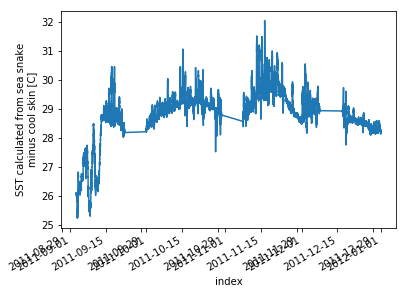

In [34]:
plt.subplots(facecolor='w')
Revelle_xr.SST.plot()

## Function Development

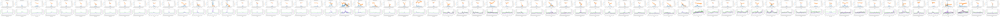

In [27]:
#-----INPUTS---------
rain_event_list 
sst_event_list 
rain_ylims = [-1,150]
δsst_ylims = [-1,0.5]
wind_ylims = [0,15]
sonic_ylims = [-200,700]
latent_ylims = [-200,700]

#initialize figure to plot into based on how many rain events we have
figlength = 5*len(rain_event_list)
fig, axx = plt.subplots(nrows=2, ncols=len(rain_event_list),facecolor='w',figsize=(figlength,6))

for event_num in np.arange(0,len(rain_event_list)):

    start = pd.to_datetime(rain_event_list[event_num].attrs['Rain Onset'])
    end = pd.to_datetime(rain_event_list[event_num].attrs['Rain End'])
    
    xlim = [start-pd.Timedelta(60,unit='min'), end+pd.Timedelta(60,unit='min')]

    #----TOP PLOT: Precip & δSST-------
    #plot precipitation rate
    rain_event_list[event_num].P.plot.line('-o',ax=axx[0,event_num],markersize=3,fillstyle=None)
    axx[0,event_num].set_ylabel('Rain Rate [mm/hr]',color='C0')
    #plot rainfall start and end times
    axx[0,event_num].plot(start,rain_event_list[event_num].P.sel(index=start),'.g',markersize=12,fillstyle=None)
    axx[0,event_num].plot(end,rain_event_list[event_num].P.sel(index=end),'.r',markersize=12,fillstyle=None)
    #plot rainfall peak
    axx[0,event_num].plot(rain_event_list[event_num].attrs['Peak Time'],rain_event_list[event_num].attrs['Peak Rate'],'.b',markersize=12,fillstyle=None)
    #set ylim
    axx[0,event_num].set_ylim(rain_ylims)
    #set xlim
    axx[0,event_num].set_xlim(xlim)

    #plot SST
    ax2 = axx[0,event_num].twinx()
    sst_event_list[event_num].δsst.plot.line('C1',ax=ax2,fillstyle=None)
    ax2.set_ylabel('$\delta$SST [$^\circ$C]',color='C1')
    #plot max δSST and pre-onset mean + std
    try:
        ax2.plot(sst_event_list[event_num].attrs['Time of max δsst'],sst_event_list[event_num].δsst.sel(index=sst_event_list[event_num].attrs['Time of max δsst']),'x',color='darkmagenta',markersize=12)
        ax2.errorbar(sst_event_list[event_num].attrs['pre-onset time'],0,yerr=sst_event_list[event_num].attrs['pre-onset std'],fmt='+k',capsize=10)
    except KeyError:
        None
    #set ylim
    ax2.set_ylim(δsst_ylims)
    #title
    axx[0,event_num].set_title(f'Rain Event # {event_num+1}')

    #-----BOTTOM PLOT: Winds & Latent/Sensible Fluxes----
    #Slice the Edson Fluxes out for this event (plot from 30min before the event to 30min after
    rv.lhf.loc[slice(xlim[0],xlim[1])].plot.line('-o',color='lightgreen',ax=axx[1,event_num],markersize=3,fillstyle=None,zorder=0)
    try:
        Edson_Fluxes.HlC.loc[slice(xlim[0],xlim[1])].plot.line('-o',color='green',ax=axx[1,event_num],markersize=3,fillstyle=None, zorder=100)
    except ImportError:
        None
    
    axx[1,event_num].set_ylabel('Latent Flux [W/m^2]', color='green')
    axx[1,event_num].set_xlim(xlim)
    axx[1,event_num].set_ylim(latent_ylims)
    
    ax1 = axx[1,event_num].twinx()
    #rain_event_list[event_num].U10.plot.line('-o',color='slategray',ax=ax1,markersize=3,fillstyle=None)
    ax1.set_ylabel('')
    ax1.set_ylim(wind_ylims)
    ax1.set_yticks([])
    
    ax2 = axx[1,event_num].twinx()
    rv.SHFrain.loc[slice(xlim[0],xlim[1])].plot.line('-o',color='mediumpurple',ax=ax2,markersize=3,fillstyle=None,zorder=0)
    try:
        Edson_Fluxes.HsC.loc[slice(xlim[0],xlim[1])].plot.line('-o',color='purple',ax=ax2,markersize=3,fillstyle=None, zorder=100)
    except ImportError:
        None
    
    ax2.set_ylabel('Sensible Flux [W/m^2]', color='purple')
    ax2.set_ylim(sonic_ylims)
        
    
plt.tight_layout()

plt.savefig('./Figures/Dynamo Rain Events 5-minute Closed-Path Fluxes v1 (includes Rain in COARE Sensible Heat Flux estimate).png')

In [ ]:
#-----INPUTS---------
rain_event_list 
sst_event_list 
rain_ylims = [-1,150]
δsst_ylims = [-1,0.5]
wind_ylims = [0,15]
sonic_ylims = [Edson_Fluxes.WTr.min().item(), Edson_Fluxes.WTr.max().item()]
latent_ylims = [Edson_Fluxes.WQr.min().item(), 0.0005]#Edson_Fluxes.WQr.max().item()]


#initialize figure to plot into based on how many rain events we have
figlength = 5*len(rain_event_list)
fig, axx = plt.subplots(nrows=2, ncols=len(rain_event_list),facecolor='w',figsize=(figlength,6))

for event_num in np.arange(0,len(rain_event_list)):

    start = pd.to_datetime(rain_event_list[event_num].attrs['Rain Onset'])
    end = pd.to_datetime(rain_event_list[event_num].attrs['Rain End'])
    
    xlim = [start-pd.Timedelta(30,unit='min'), end+pd.Timedelta(30,unit='min')]

    #----TOP PLOT: Precip & δSST-------
    #plot precipitation rate
    rain_event_list[event_num].P.plot.line('-o',ax=axx[0,event_num],markersize=3,fillstyle=None)
    axx[0,event_num].set_ylabel('Rain Rate [mm/hr]',color='C0')
    #plot rainfall start and end times
    axx[0,event_num].plot(start,rain_event_list[event_num].P.sel(index=start),'.g',markersize=12,fillstyle=None)
    axx[0,event_num].plot(end,rain_event_list[event_num].P.sel(index=end),'.r',markersize=12,fillstyle=None)
    #plot rainfall peak
    axx[0,event_num].plot(rain_event_list[event_num].attrs['Peak Time'],rain_event_list[event_num].attrs['Peak Rate'],'.b',markersize=12,fillstyle=None)
    #set ylim
    axx[0,event_num].set_ylim(rain_ylims)
    #set xlim
    axx[0,event_num].set_xlim(xlim)

    #plot SST
    ax2 = axx[0,event_num].twinx()
    sst_event_list[event_num].δsst.plot.line('C1',ax=ax2,fillstyle=None)
    ax2.set_ylabel('$\delta$SST [$^\circ$C]',color='C1')
    #plot max δSST and pre-onset mean + std
    try:
        ax2.plot(sst_event_list[event_num].attrs['Time of max δsst'],sst_event_list[event_num].δsst.sel(index=sst_event_list[event_num].attrs['Time of max δsst']),'x',color='darkmagenta',markersize=12)
        ax2.errorbar(sst_event_list[event_num].attrs['pre-onset time'],0,yerr=sst_event_list[event_num].attrs['pre-onset std'],fmt='+k',capsize=10)
    except KeyError:
        None
    #set ylim
    ax2.set_ylim(δsst_ylims)
    #title
    axx[0,event_num].set_title(f'Rain Event # {event_num+1}')

    #-----BOTTOM PLOT: Winds & Sonic Buoyancy Fluxes----
    #Slice the Edson Fluxes out for this event (plot from 30min before the event to 30min after
    try:
        Edson_Fluxes.WQr.loc[slice(xlim[0],xlim[1])].plot.line('-o',color='purple',ax=axx[1,event_num],markersize=3,fillstyle=None)
    except ImportError:
        None
    axx[1,event_num].set_ylabel('Moisture Flux (r) [m/s g/g]', color='purple')
    axx[1,event_num].set_xlim(xlim)
    axx[1,event_num].set_ylim(latent_ylims)
    
    ax1 = axx[1,event_num].twinx()
    rain_event_list[event_num].U10.plot.line('-o',color='slategray',ax=ax1,markersize=3,fillstyle=None)
    ax1.set_ylabel('')
    ax1.set_ylim(wind_ylims)
    ax1.set_yticks([])
    
    ax2 = axx[1,event_num].twinx()
    try:
        Edson_Fluxes.WTr.loc[slice(xlim[0],xlim[1])].plot.line('-o',color='green',ax=ax2,markersize=3,fillstyle=None)
    except ImportError:
        None
    ax2.set_ylabel('Sonic Buoyancy Flux (r) [m/sK]', color='green')
    ax2.set_ylim(sonic_ylims)
        
    
plt.tight_layout()

#plt.savefig('./Figures/Dynamo Rain Events + deltaSST + Wind + Moisture + Sonic v1.png')